In [155]:
# Additional imports are required
import os 

import numpy as np
import pandas as pd
import seaborn as sns

from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error, mean_squared_error

# Plots
import matplotlib.pyplot as plt
from pylab import rcParams
rcParams['figure.figsize'] = 18, 7

import warnings
warnings.filterwarnings('ignore')

# Prerocessing for FEDOT
from fedot.core.data.data import InputData
from fedot.core.repository.dataset_types import DataTypesEnum
from fedot.core.repository.tasks import Task, TaskTypesEnum, TsForecastingParams

# FEDOT 
from fedot.core.chains.node import PrimaryNode, SecondaryNode
from fedot.core.chains.ts_chain import TsForecastingChain

## Подготавливаем временные ряды

In [113]:
df_rean=pd.read_csv('./timelines_data/formed_timelines_2002/2002_ARCTIC_reanalysis_GRID.csv', sep=';')
df_rean['dates'] =  pd.to_datetime(df_rean['dates'], format='%Y-%m-%d')

for column in list(df_rean.columns.values):
    if column!='dates':
        df_rean[column]=df_rean[column]-np.mean(df_rean[column])
        stl = STL(df_rean[column], period=80)
        res = stl.fit()
        params = norm.fit(res.resid)
        ks = kstest(res.resid, 'norm', params, N=1000)        
        if ks[1]>=0.05:
            #sns.distplot(res.resid, fit=norm, hist=False)
            #plt.show()
            df_rean[column]=df_rean[column]-res.resid
        else:
            print(column)
df_rean

,76.04_8.72,75.84_8.72,75.64_8.72,75.44_8.72,76.44_9.72,76.24_9.72,76.04_9.72,75.84_9.72,75.64_9.72,75.44_9.72,...,76.84_30.72,76.64_30.72,76.44_30.72,76.24_30.72,77.04_31.72,76.84_31.72,76.64_31.72,76.44_31.72,76.84_32.72,dates
0,0.034992,0.034718,0.032032,0.027844,0.026310,0.028339,0.027947,0.027634,0.026690,0.016180,...,-0.020535,-0.027864,-0.034043,-0.034043,0.008050,0.000913,-0.021561,-0.030222,0.001356,2002-01-01
1,0.058270,0.058306,0.055602,0.050686,0.049921,0.051845,0.052467,0.052148,0.051075,0.040347,...,0.022316,0.014934,0.009822,0.009822,0.050113,0.046925,0.027756,0.020172,0.049706,2002-01-02
2,0.062436,0.062537,0.059925,0.055279,0.054040,0.055957,0.057700,0.057536,0.056527,0.046154,...,0.012881,0.001712,-0.008514,-0.008514,0.039593,0.032066,0.008459,-0.002192,0.025435,2002-01-03
3,0.063424,0.063512,0.061063,0.056140,0.054533,0.056757,0.059166,0.058829,0.057676,0.046912,...,-0.017130,-0.022521,-0.022301,-0.022301,0.002329,-0.001674,-0.016318,-0.021154,0.004181,2002-01-04
4,0.056305,0.056191,0.053409,0.047372,0.047233,0.049387,0.050545,0.049952,0.048565,0.036534,...,0.012275,0.009005,0.006407,0.006407,0.034164,0.037784,0.022573,0.016598,0.045194,2002-01-05
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
360,0.053847,0.047681,0.039707,0.041549,0.063631,0.066376,0.062971,0.055390,0.049154,0.048711,...,0.080870,0.076975,0.081327,0.081327,0.091999,0.084992,0.073588,0.072650,0.071904,2002-12-27
361,0.056429,0.049822,0.040671,0.040778,0.063836,0.067421,0.064336,0.056341,0.049220,0.048054,...,0.059155,0.056916,0.064658,0.064658,0.071171,0.066003,0.055439,0.054380,0.060337,2002-12-28
362,0.059627,0.053090,0.045162,0.045927,0.066616,0.070397,0.067439,0.059568,0.052695,0.052243,...,0.059734,0.057916,0.064062,0.064062,0.076493,0.074301,0.060417,0.056684,0.070495,2002-12-29
363,0.066121,0.059172,0.051419,0.052143,0.075578,0.078953,0.074769,0.066495,0.059423,0.059202,...,0.067323,0.065050,0.070196,0.070196,0.084828,0.082266,0.066639,0.062536,0.074877,2002-12-30


In [114]:
df_nemo=pd.read_csv('./timelines_data/formed_timelines_2002/2002_NEMO_SPITZ_GRID.csv', sep=';')
df_nemo['dates'] =  pd.to_datetime(df_nemo['dates'], format='%d.%m.%Y')

for column in list(df_nemo.columns.values):
    if column!='dates':
        df_nemo[column]=df_nemo[column]-np.mean(df_nemo[column])
        stl = STL(df_nemo[column], period=80)
        res = stl.fit()
        params = norm.fit(res.resid)
        ks = kstest(res.resid, 'norm', params, N=1000)
        if ks[1]>=0.05:
            #sns.distplot(res.resid, fit=norm, hist=False)
            #plt.show()
            #print(ks)
            df_nemo[column]=df_nemo[column]-res.resid
        else:
            print(column)
            
df_nemo

,76.04_8.72,75.84_8.72,75.64_8.72,75.44_8.72,76.44_9.72,76.24_9.72,76.04_9.72,75.84_9.72,75.64_9.72,75.44_9.72,...,76.84_30.72,76.64_30.72,76.44_30.72,76.24_30.72,77.04_31.72,76.84_31.72,76.64_31.72,76.44_31.72,76.84_32.72,dates
0,0.043496,0.041205,0.043296,0.049496,0.018957,0.020623,0.043043,0.037323,0.030662,0.021557,...,-0.006893,-0.016234,-0.021648,-0.021540,0.006230,0.002845,-0.005700,-0.013671,0.009085,2002-01-01
1,0.047268,0.046536,0.044069,0.050039,0.019246,0.021221,0.045237,0.040602,0.034548,0.025336,...,0.000493,-0.009252,-0.014643,-0.014258,0.013718,0.008249,0.000039,-0.006766,0.014637,2002-01-02
2,0.044126,0.044443,0.036774,0.041407,0.010971,0.014720,0.043880,0.036382,0.029206,0.017985,...,-0.004167,-0.012748,-0.017804,-0.017722,0.007621,-0.002128,-0.008281,-0.012912,0.003973,2002-01-03
3,0.062028,0.062371,0.050494,0.054275,0.025246,0.029794,0.058684,0.048697,0.041713,0.030885,...,-0.010836,-0.015992,-0.018431,-0.017348,-0.000368,-0.010376,-0.011623,-0.014038,0.001755,2002-01-04
4,0.071914,0.072430,0.058286,0.061006,0.027560,0.035322,0.063933,0.056161,0.049207,0.039845,...,-0.000004,-0.003843,-0.003772,-0.002390,0.010757,0.006049,0.003313,-0.000569,0.019566,2002-01-05
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
360,0.045611,0.054914,0.059584,0.077185,0.028578,0.029135,0.054378,0.072661,0.074267,0.059977,...,0.111664,0.117896,0.114245,0.115759,0.105825,0.109763,0.112713,0.115663,0.101524,2002-12-27
361,0.040227,0.046561,0.047235,0.068944,0.020274,0.021585,0.049065,0.066814,0.069268,0.056660,...,0.103190,0.108623,0.107286,0.109981,0.097514,0.100478,0.104291,0.107933,0.094374,2002-12-28
362,0.036336,0.040292,0.039558,0.064122,0.014276,0.015902,0.045349,0.060325,0.064344,0.053484,...,0.099011,0.102547,0.102639,0.105849,0.095617,0.095864,0.098940,0.101429,0.090882,2002-12-29
363,0.032965,0.035805,0.034460,0.062205,0.009790,0.011852,0.042518,0.053357,0.060313,0.050977,...,0.098158,0.100042,0.100620,0.103715,0.097523,0.095937,0.098053,0.098531,0.092439,2002-12-30


## Выделяем тестовую и обучающую выборку

In [115]:
len_forecast = 30

true_values = np.array(df_rean['76.44_9.72'])
train_data = df_rean['76.44_9.72'][:-len_forecast]
test_data = df_rean['76.44_9.72'][-len_forecast:]

### Функция для вывода графика с результатом

In [116]:
def plot_results(actual_time_series, predicted_values, len_train_data, y_name = 'Parameter'):
    """
    Function for drawing plot with predictions
    
    :param actual_time_series: the entire array with one-dimensional data
    :param predicted_values: array with predicted values
    :param len_train_data: number of elements in the training sample
    :param y_name: name of the y axis
    """
    
    plt.plot(np.arange(0, len(actual_time_series)), 
             actual_time_series, label = 'Actual values', c = 'green')
    plt.plot(np.arange(len_train_data, len_train_data + len(predicted_values)), 
             predicted_values, label = 'Predicted', c = 'blue')
    # Plot black line which divide our array into train and test
    plt.plot([len_train_data, len_train_data],
             [min(actual_time_series), max(actual_time_series)], c = 'black', linewidth = 1)
    plt.ylabel(y_name, fontsize = 15)
    plt.xlabel('Time index', fontsize = 15)
    plt.legend(fontsize = 15)
    plt.grid()
    plt.show()

### Функция для предсказания одним вызовом

In [117]:
def make_forecast(chain, train_data, len_forecast: int, max_window_size: int):
    """
    Function for predicting values in a time series
    
    :param chain: TsForecastingChain object
    :param train_data: one-dimensional numpy array to train chain
    :param len_forecast: amount of values for predictions
    :param max_window_size: moving window size

    :return predicted_values: numpy array, forecast of model
    """
    
    # Here we define which task should we use, here we also define two main 
    # hyperparameters: forecast_length and max_window_size
    task = Task(TaskTypesEnum.ts_forecasting,
                TsForecastingParams(forecast_length=len_forecast,
                                    max_window_size=max_window_size,
                                    return_all_steps=False,
                                    make_future_prediction=True))

    # Prepare data to train the model
    train_input = InputData(idx=np.arange(0, len(train_data)),
                            features=None,
                            target=train_data,
                            task=task,
                            data_type=DataTypesEnum.ts)

    # Make a "blank", here we need just help FEDOT understand that the 
    # forecast should be made exactly the "len_forecast" length
    predict_input = InputData(idx=np.arange(0, len_forecast),
                              features=None,
                              target=None,
                              task=task,
                              data_type=DataTypesEnum.ts)

    # Fit it
    chain.fit_from_scratch(train_input)

    # Predict
    predicted_values = chain.forecast(initial_data=train_input,
                                      supplementary_data=predict_input).predict
    
    return predicted_values

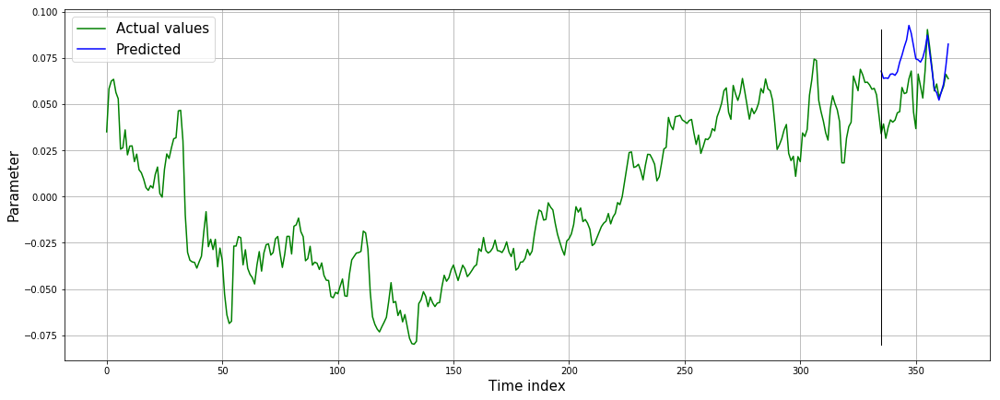

In [118]:
# тестовое предсказание
predicted_values = make_forecast(chain = TsForecastingChain(PrimaryNode('ridge')),
                                 train_data = train_data, 
                                 len_forecast = 30,
                                 max_window_size = 60)

plot_results(actual_time_series = df_rean['76.04_8.72'],
             predicted_values = predicted_values, 
             len_train_data = len(train_data))

### Тестовое предсказание

In [119]:
len_forecast = 30

# Let's dividide our data on train and test samples
true_values = np.array(df_rean['76.44_9.72'])
train_data = df_rean['76.44_9.72'][:-len_forecast]
test_data = df_rean['76.44_9.72'][-len_forecast:]

In [120]:
# Define PrimaryNode models - its first level models
node_first = PrimaryNode('trend_data_model')
node_second = PrimaryNode('residual_data_model')

# Define SecondaryNode models - its second level models
node_trend_model = SecondaryNode('ridge', nodes_from=[node_first])
node_residual_model = SecondaryNode('ridge', nodes_from=[node_second])

# Root node - make final prediction
node_final = SecondaryNode('svr', nodes_from=[node_trend_model,
                                              node_residual_model])
final_chain = TsForecastingChain(node_final)

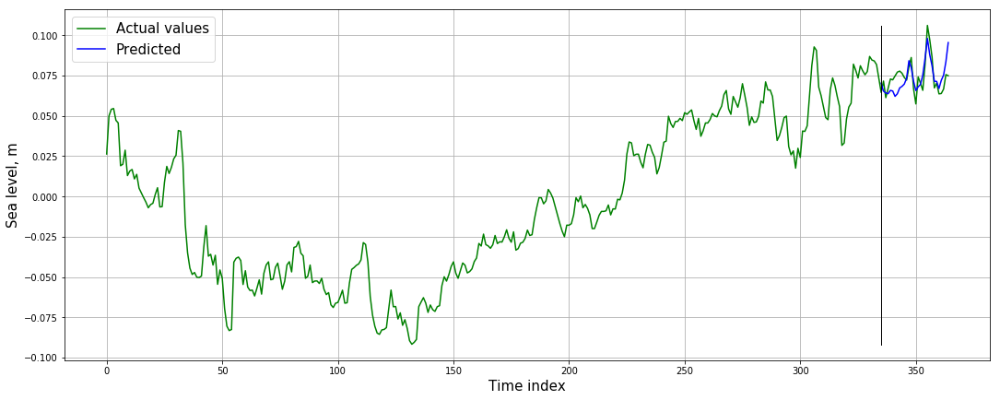

Mean absolute error: 0.007


In [121]:
predicted_values = make_forecast(chain = final_chain,
                                 train_data = train_data, 
                                 len_forecast = len_forecast,
                                 max_window_size = 60)

# Plot predictions and true values
plot_results(actual_time_series = true_values,
             predicted_values = predicted_values, 
             len_train_data = len(train_data),
             y_name = 'Sea level, m')

# Print MAE metric
print(f'Mean absolute error: {mean_absolute_error(test_data, predicted_values):.3f}')

## Моделирование циклом для всех точек

In [149]:
errors_df=pd.DataFrame(columns = ['POINT', 'MSE_RIDGE', 'MAE_RIDGE', 'MAPE_RIDGE', 'KS_RIDGE',
                                  'MSE_HYB', 'MAE_HYB', 'MAPE_HYB', 'KS_HYB'])

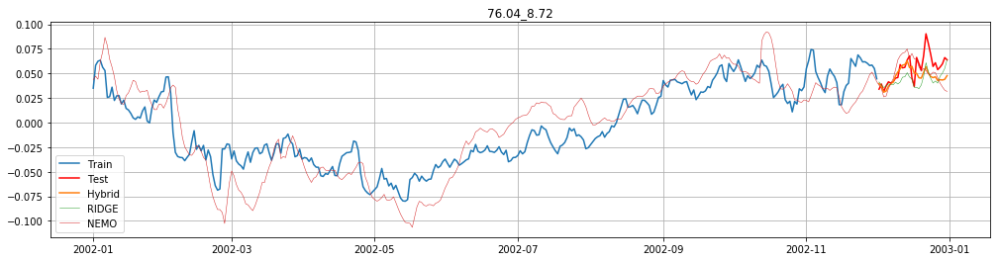

RIDGE:
MSE: 0.00023050565087157066
MAE: 0.01190395720116838
MAPE: 19.496

HYB:
MSE: 0.00018646937045051473
MAE: 0.010684455751893456
MAPE: 17.849


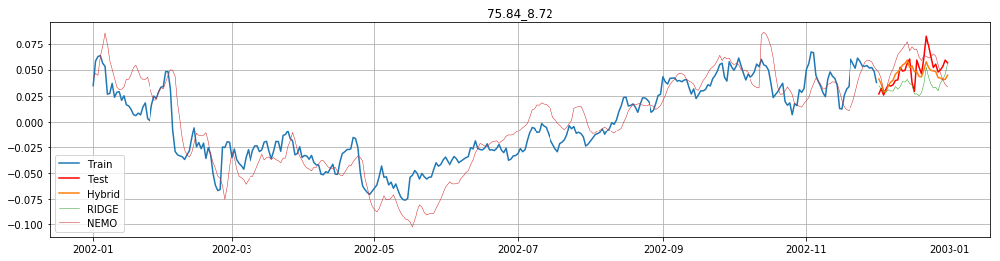

RIDGE:
MSE: 0.0002880166555609714
MAE: 0.013883702017302968
MAPE: 26.229

HYB:
MSE: 0.00011738657903637869
MAE: 0.008888876873755362
MAPE: 18.779


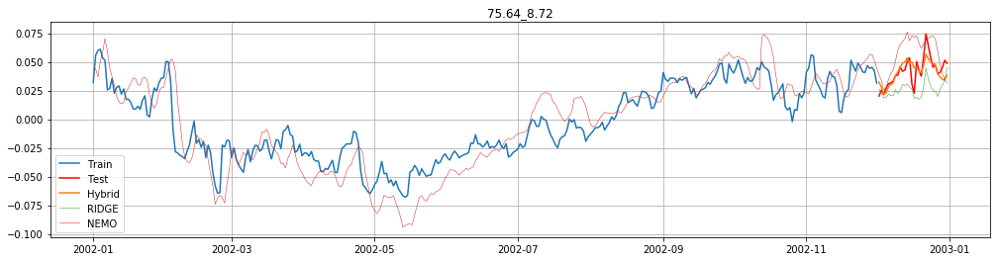

RIDGE:
MSE: 0.00032755018158510553
MAE: 0.016000371080880135
MAPE: 36.35

HYB:
MSE: 7.589085777789995e-05
MAE: 0.006281771869279073
MAPE: 16.858


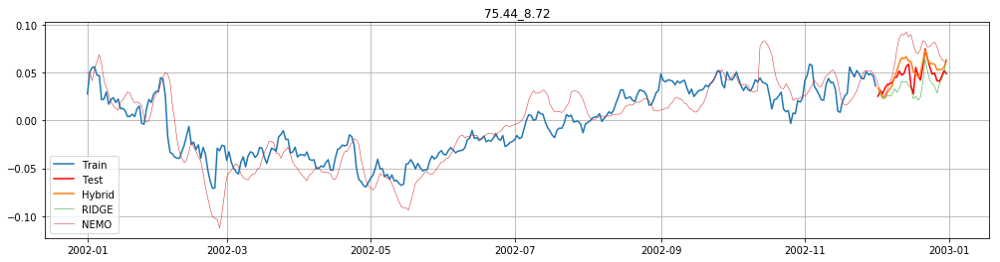

RIDGE:
MSE: 0.00019013806043562774
MAE: 0.012031416343368904
MAPE: 25.938

HYB:
MSE: 0.00010588152173039921
MAE: 0.008219672124385255
MAPE: 20.197


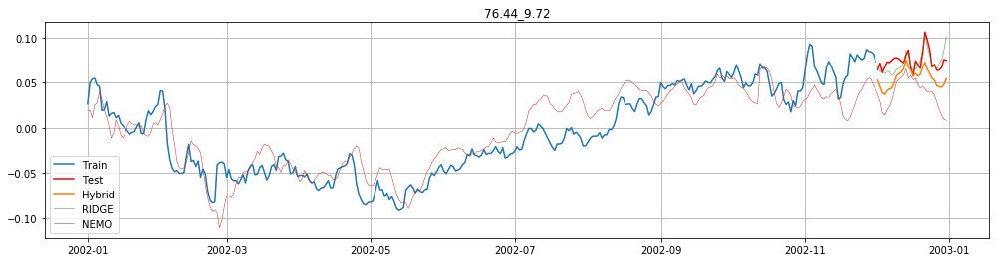

RIDGE:
MSE: 8.380361707875604e-05
MAE: 0.007367147934375801
MAPE: 9.951

HYB:
MSE: 0.0004439485021636575
MAE: 0.01898907753029217
MAPE: 25.401


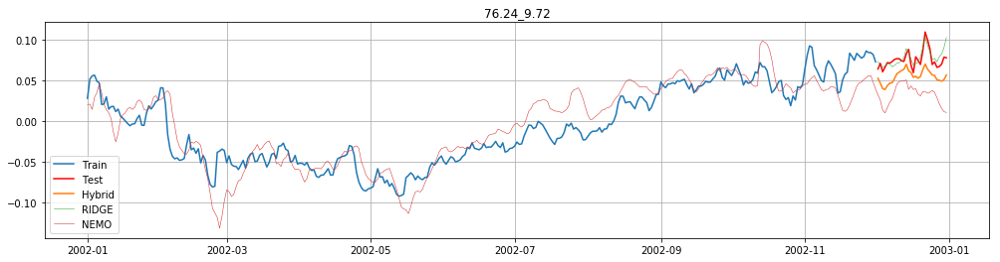

RIDGE:
MSE: 6.465457766792609e-05
MAE: 0.006561649176175768
MAPE: 8.866

HYB:
MSE: 0.0004819041476499086
MAE: 0.020533768104634333
MAPE: 26.715


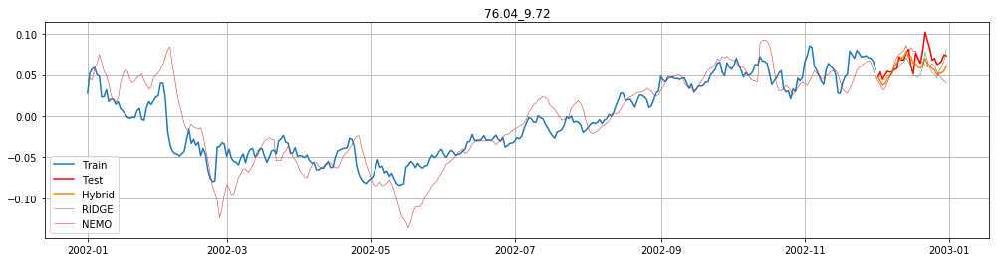

RIDGE:
MSE: 0.00018173788052424687
MAE: 0.0105898125913094
MAPE: 14.665

HYB:
MSE: 0.0001747554729706009
MAE: 0.010947990287855012
MAPE: 15.782


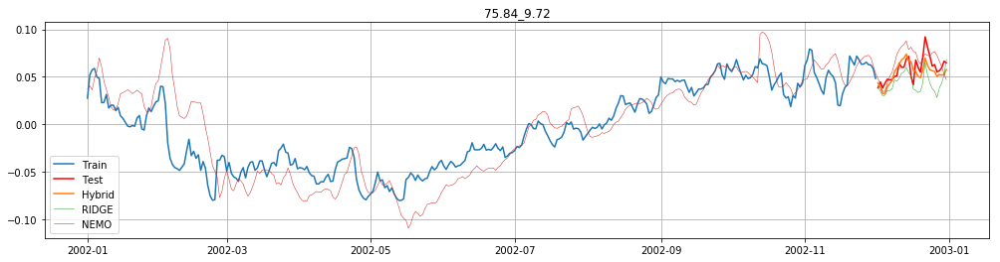

RIDGE:
MSE: 0.0003210670769051037
MAE: 0.015157440386733776
MAPE: 24.895

HYB:
MSE: 0.00010040563685505822
MAE: 0.008651531809407286
MAPE: 14.777


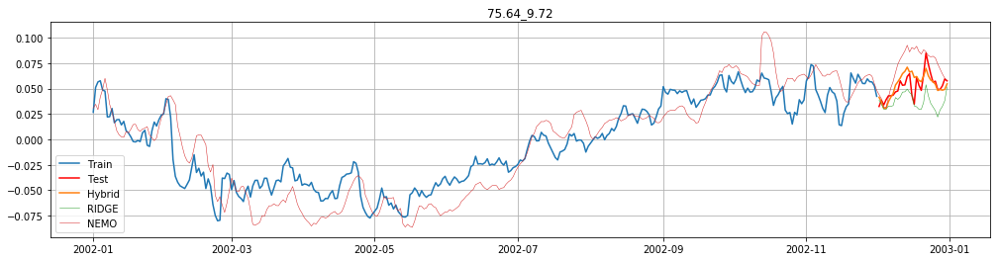

RIDGE:
MSE: 0.00034015881032267774
MAE: 0.015657852006452994
MAPE: 28.251

HYB:
MSE: 8.717832373640297e-05
MAE: 0.006832769913054789
MAPE: 14.222


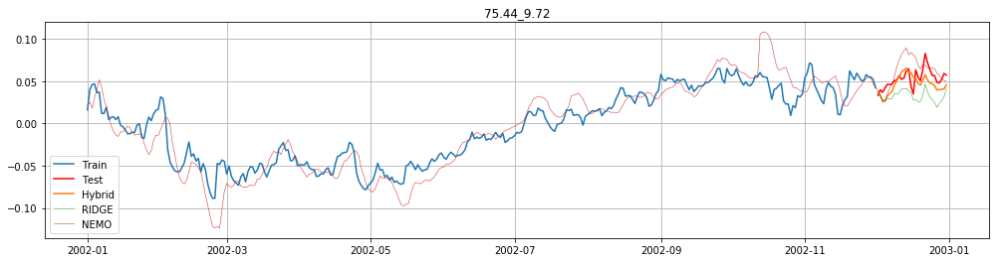

RIDGE:
MSE: 0.0005273120346387858
MAE: 0.020946259580140177
MAPE: 37.911

HYB:
MSE: 0.00014316909230777268
MAE: 0.010542352328757427
MAPE: 20.307


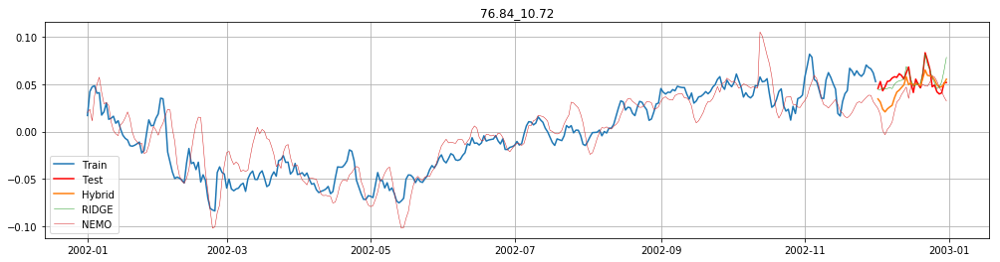

RIDGE:
MSE: 6.206042583676899e-05
MAE: 0.006025061698226443
MAPE: 11.717

HYB:
MSE: 0.00022393265024133884
MAE: 0.012037741840318751
MAPE: 22.29


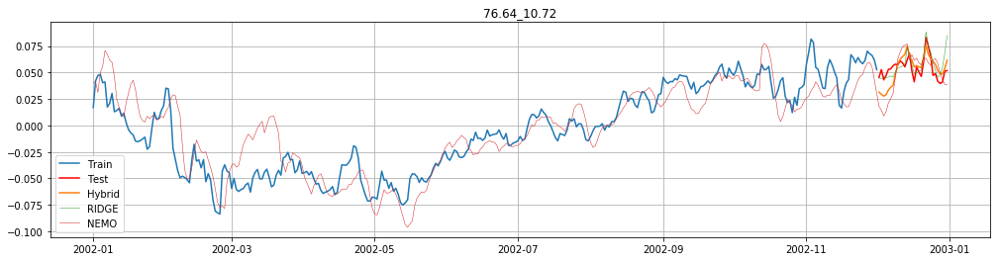

RIDGE:
MSE: 8.514134800805682e-05
MAE: 0.006804828479319468
MAPE: 13.284

HYB:
MSE: 0.00013051921227086733
MAE: 0.009824601519007152
MAPE: 19.33


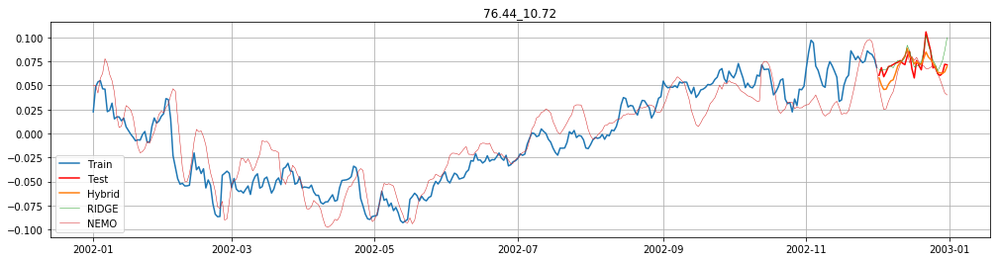

RIDGE:
MSE: 6.740896819396108e-05
MAE: 0.005790701250254511
MAPE: 8.416

HYB:
MSE: 0.00010885299807891112
MAE: 0.008292932904369353
MAPE: 11.464


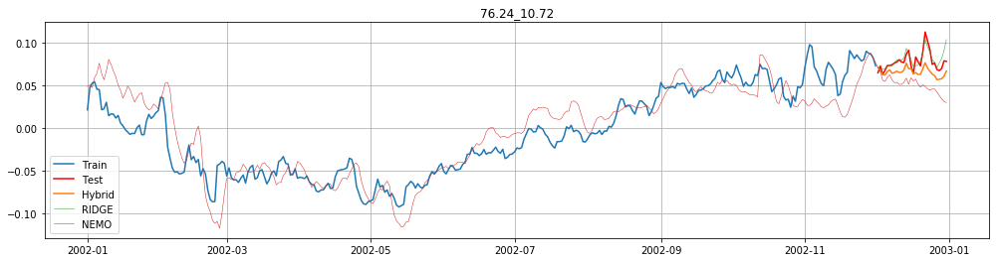

RIDGE:
MSE: 5.578449446494484e-05
MAE: 0.005532199758116912
MAPE: 7.214

HYB:
MSE: 0.00022559859746700206
MAE: 0.012657362711091903
MAPE: 15.364


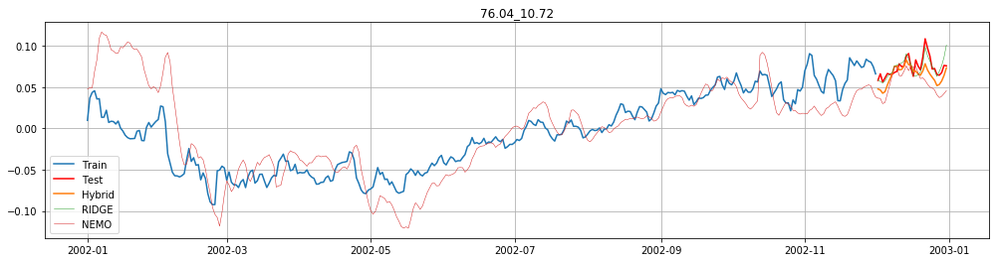

RIDGE:
MSE: 6.668938116105027e-05
MAE: 0.006104645416001897
MAPE: 7.989

HYB:
MSE: 0.0001725499215349728
MAE: 0.011067585371564433
MAPE: 14.757


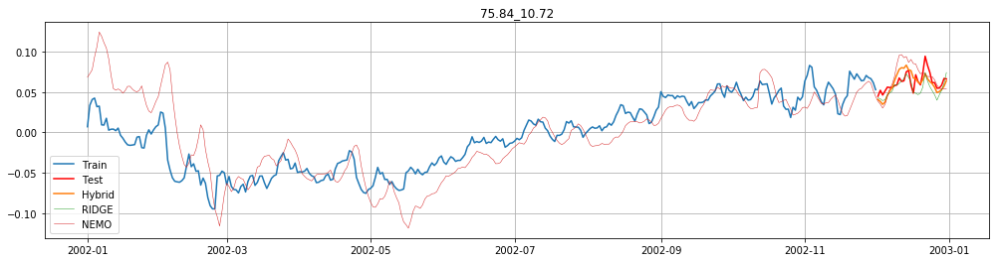

RIDGE:
MSE: 0.00012129089352312115
MAE: 0.009046980914629894
MAPE: 14.023

HYB:
MSE: 0.00011361987231204226
MAE: 0.00881325644162734
MAPE: 14.313


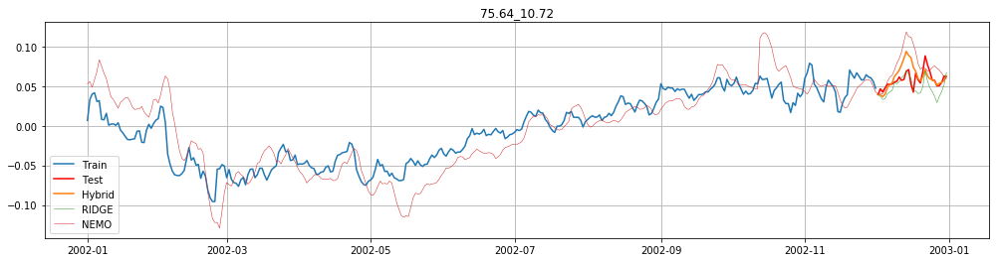

RIDGE:
MSE: 0.00016369636072575633
MAE: 0.010857620062236364
MAPE: 18.601

HYB:
MSE: 0.0001757282882115977
MAE: 0.009136920740998495
MAPE: 15.935


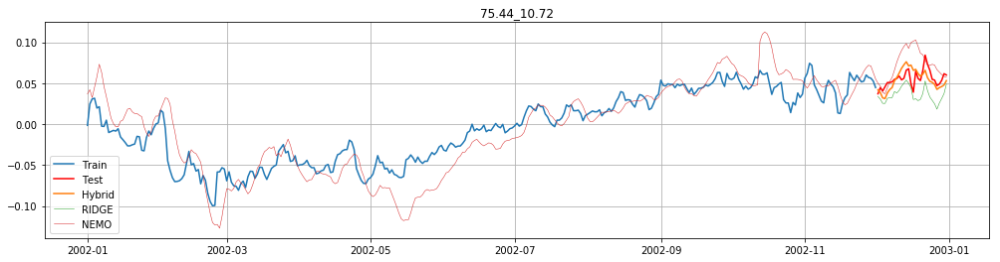

RIDGE:
MSE: 0.0004605476464320374
MAE: 0.019659979751088522
MAPE: 35.058

HYB:
MSE: 0.00012444637500583284
MAE: 0.009162054026291557
MAPE: 17.206


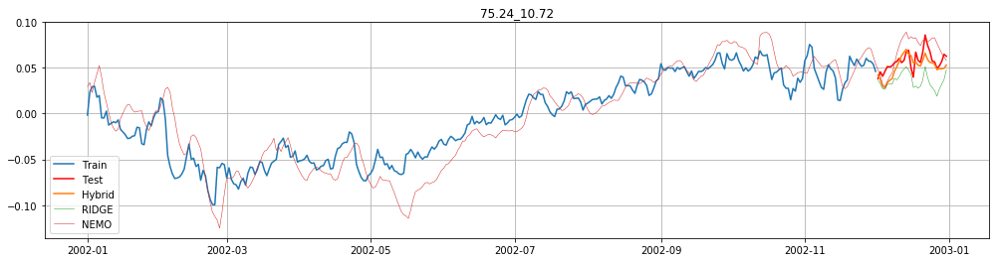

RIDGE:
MSE: 0.0005547363674969872
MAE: 0.021705939813912296
MAPE: 37.391

HYB:
MSE: 0.00011412938341389835
MAE: 0.009264186627174974
MAPE: 16.776


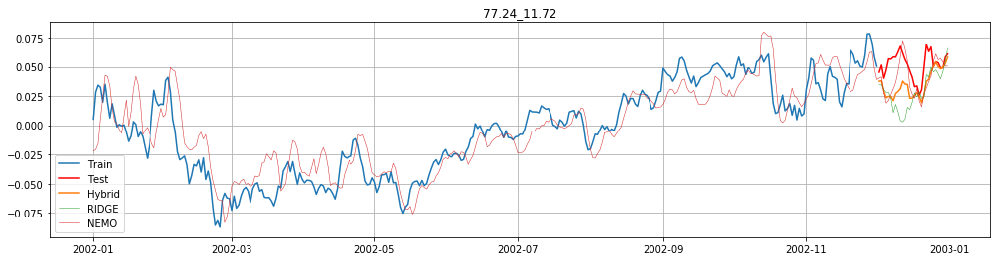

RIDGE:
MSE: 0.0008233337830990643
MAE: 0.022567036430058293
MAPE: 41.397

HYB:
MSE: 0.0004241722989104457
MAE: 0.016651845747116572
MAPE: 30.924


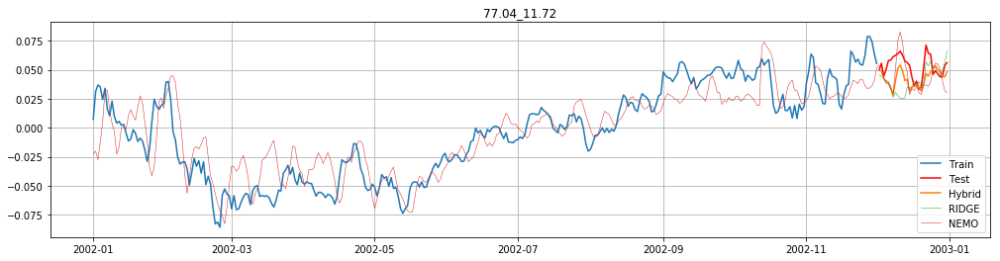

RIDGE:
MSE: 0.0003486353498365669
MAE: 0.013877150183922536
MAPE: 24.134

HYB:
MSE: 0.000197932723088939
MAE: 0.011232592559487995
MAPE: 19.684


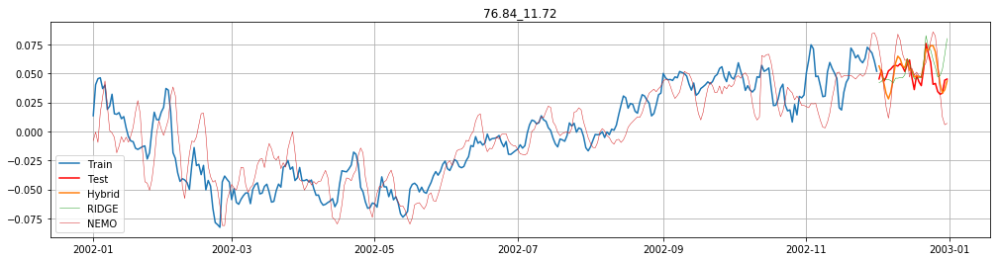

RIDGE:
MSE: 0.0001529565244398975
MAE: 0.010059253683432296
MAPE: 22.23

HYB:
MSE: 0.00015148438728661103
MAE: 0.009009495090167708
MAPE: 19.737


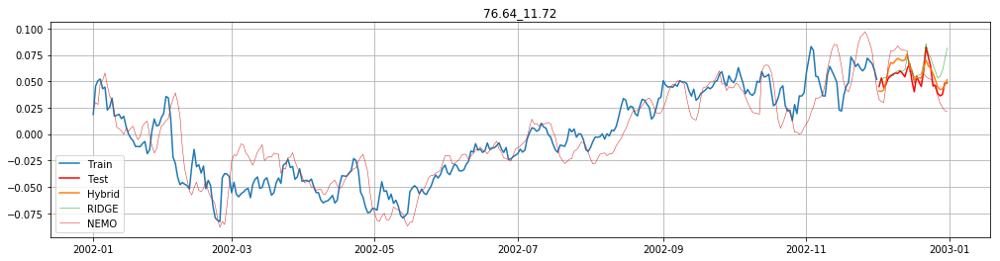

RIDGE:
MSE: 0.00013929055341631685
MAE: 0.008721673104562642
MAPE: 18.819

HYB:
MSE: 7.94851981587924e-05
MAE: 0.007738285242024065
MAPE: 14.722


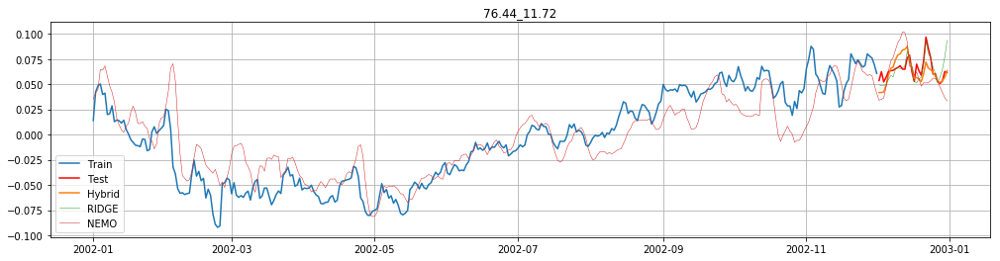

RIDGE:
MSE: 8.053600740368879e-05
MAE: 0.006144552612505228
MAPE: 9.75

HYB:
MSE: 0.0001247966732759511
MAE: 0.008936579228238688
MAPE: 13.193


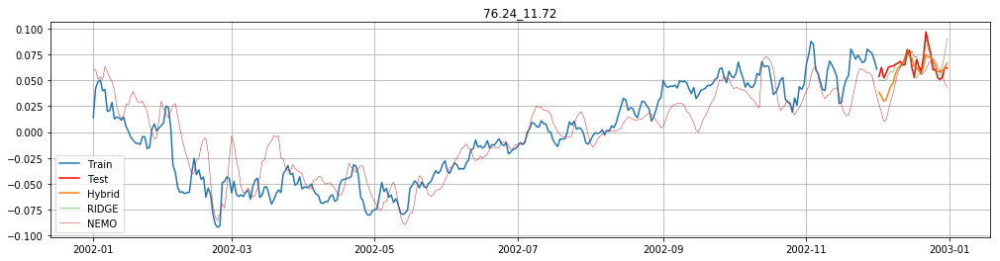

RIDGE:
MSE: 6.929933691521659e-05
MAE: 0.005878440224603791
MAPE: 9.21

HYB:
MSE: 0.00016376470234347843
MAE: 0.010275141748615034
MAPE: 16.318


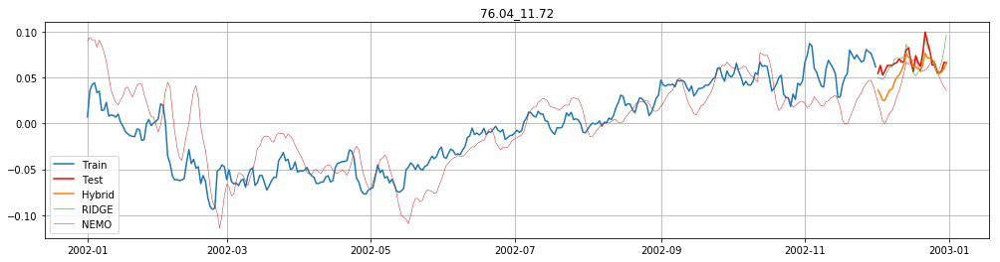

RIDGE:
MSE: 8.397483719507443e-05
MAE: 0.006646238524147892
MAPE: 10.013

HYB:
MSE: 0.0002707287623544278
MAE: 0.012822972249133025
MAPE: 19.498


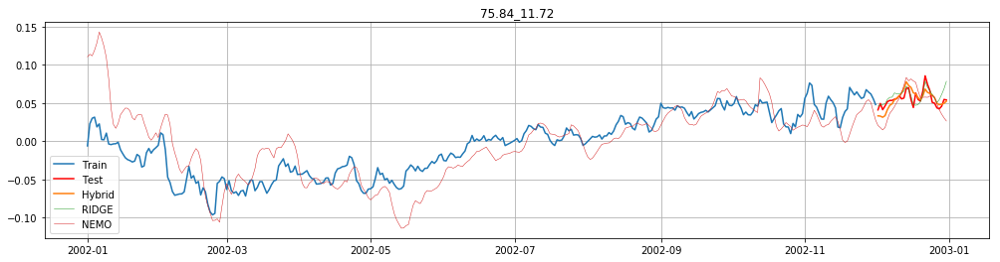

RIDGE:
MSE: 7.259559629936184e-05
MAE: 0.006780911140995954
MAPE: 12.805

HYB:
MSE: 8.029275563306405e-05
MAE: 0.007237637490457991
MAPE: 13.61


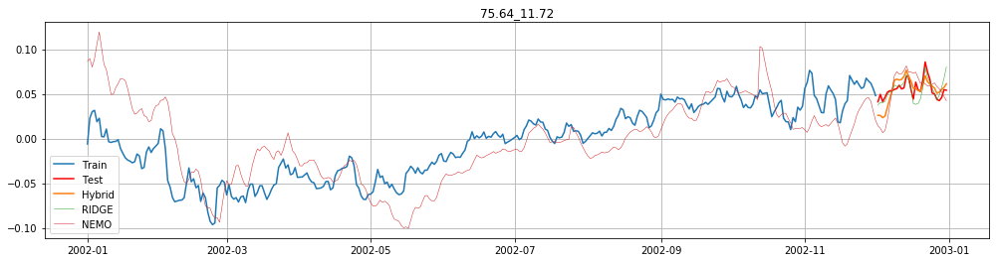

RIDGE:
MSE: 8.074627995469711e-05
MAE: 0.0063838413164122336
MAPE: 11.571

HYB:
MSE: 0.000119629889485394
MAE: 0.0092984630243658
MAPE: 17.861


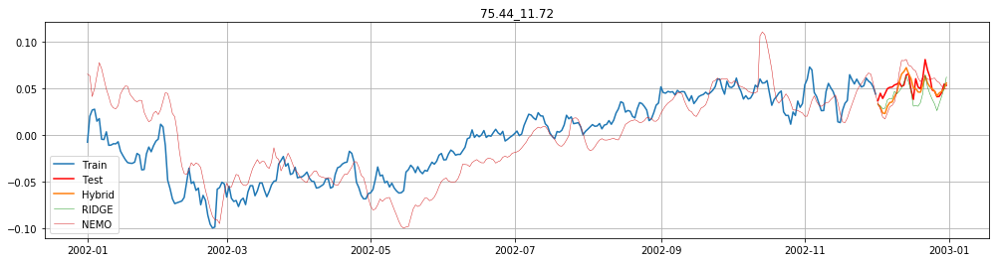

RIDGE:
MSE: 0.00015842297655426052
MAE: 0.010929371124598781
MAPE: 20.971

HYB:
MSE: 0.00012156538724209183
MAE: 0.009050900844705523
MAPE: 17.632


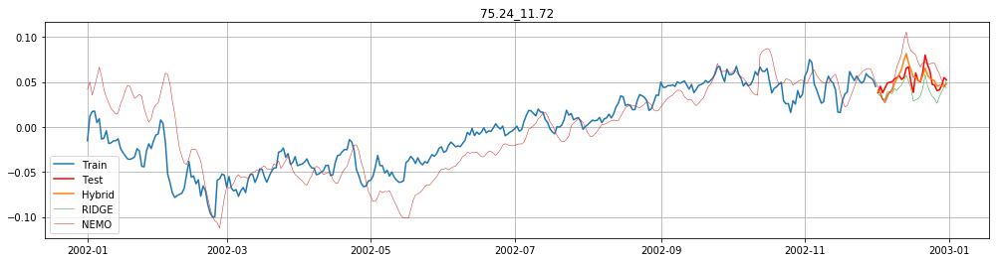

RIDGE:
MSE: 0.0001986404340662758
MAE: 0.012451453703110306
MAPE: 23.402

HYB:
MSE: 8.975879892168646e-05
MAE: 0.007835069672499074
MAPE: 15.317


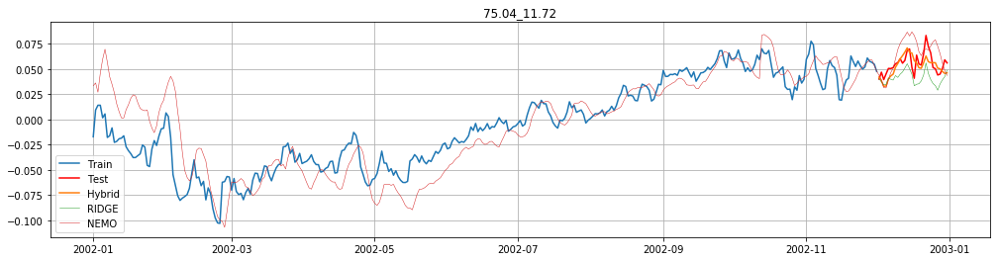

RIDGE:
MSE: 0.0002458346701042177
MAE: 0.014076580269589915
MAPE: 24.555

HYB:
MSE: 8.208012663966815e-05
MAE: 0.007640146462697071
MAPE: 14.033


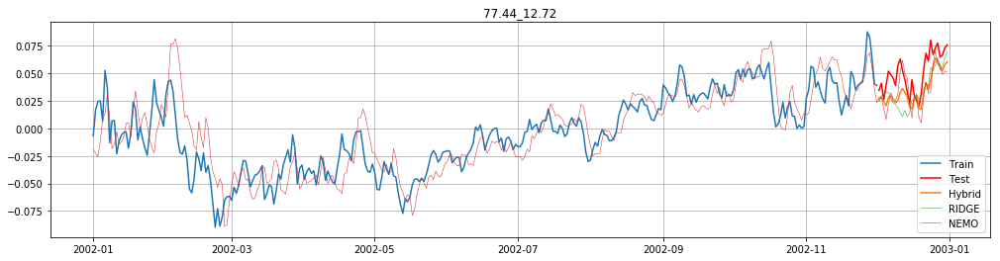

RIDGE:
MSE: 0.00041791698662174757
MAE: 0.017066981926100153
MAPE: 34.352

HYB:
MSE: 0.0003276095389373985
MAE: 0.015575896503389523
MAPE: 29.853


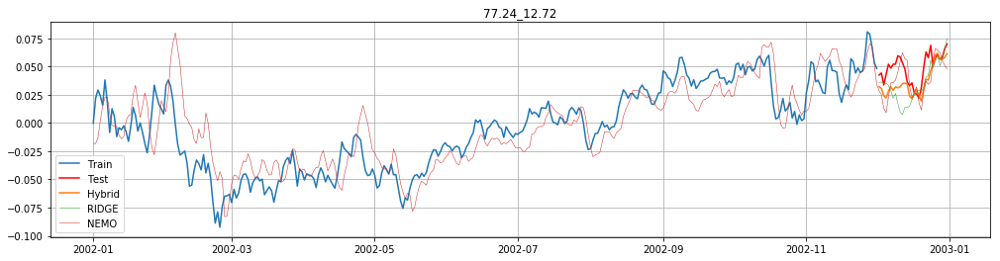

RIDGE:
MSE: 0.0004114491772540318
MAE: 0.01490793526627235
MAPE: 30.695

HYB:
MSE: 0.00023446569161757956
MAE: 0.012505799674769695
MAPE: 25.494


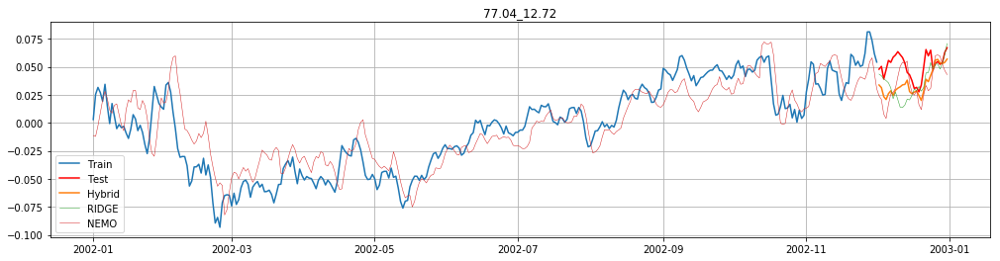

RIDGE:
MSE: 0.0004474107676287398
MAE: 0.015282734772253333
MAPE: 28.415

HYB:
MSE: 0.0003677083801948571
MAE: 0.01590288423367018
MAPE: 30.135


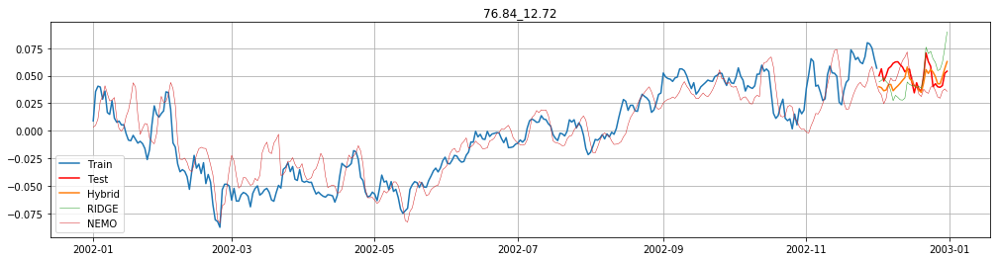

RIDGE:
MSE: 0.000361763709957246
MAE: 0.015622045714236968
MAPE: 29.962

HYB:
MSE: 0.00013885036912656407
MAE: 0.009670184948848776
MAPE: 17.957


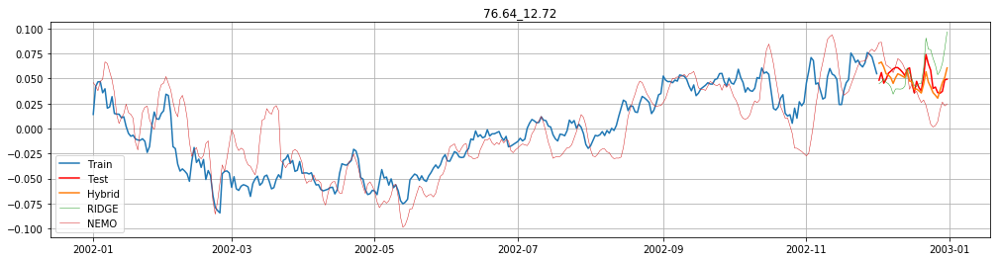

RIDGE:
MSE: 0.0003393693832665962
MAE: 0.015134456912344961
MAPE: 31.077

HYB:
MSE: 8.952595157776805e-05
MAE: 0.007796245510498084
MAPE: 14.986


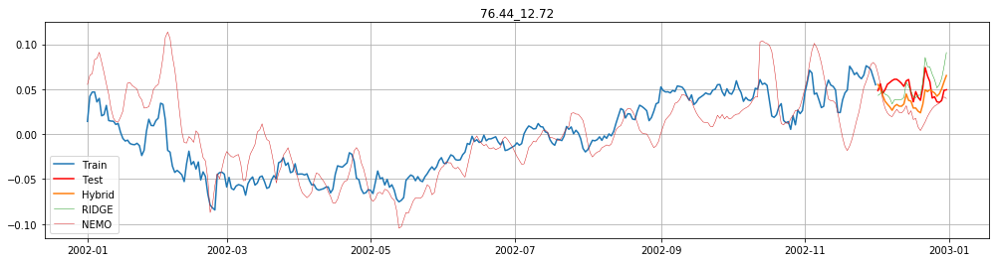

RIDGE:
MSE: 0.00028809444306183106
MAE: 0.014099942925185705
MAPE: 28.645

HYB:
MSE: 0.00032505084514767554
MAE: 0.015917516975386715
MAPE: 30.266


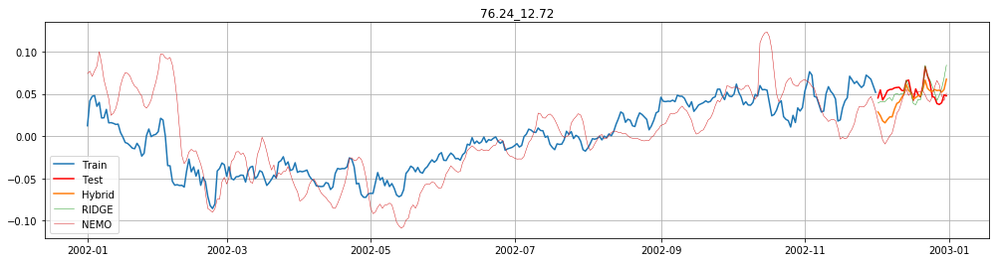

RIDGE:
MSE: 0.00012163731007653278
MAE: 0.008280731871626519
MAPE: 16.623

HYB:
MSE: 0.0003198169664555021
MAE: 0.014648349624357881
MAPE: 28.259


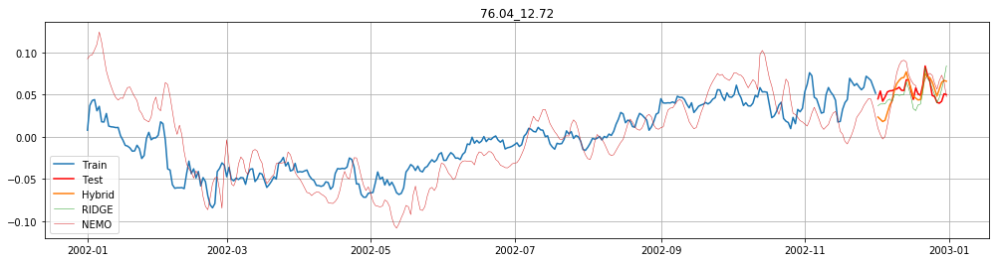

RIDGE:
MSE: 0.00013777291641182417
MAE: 0.009330655177131655
MAPE: 17.902

HYB:
MSE: 0.0002220555459453907
MAE: 0.012379297567442209
MAPE: 24.534


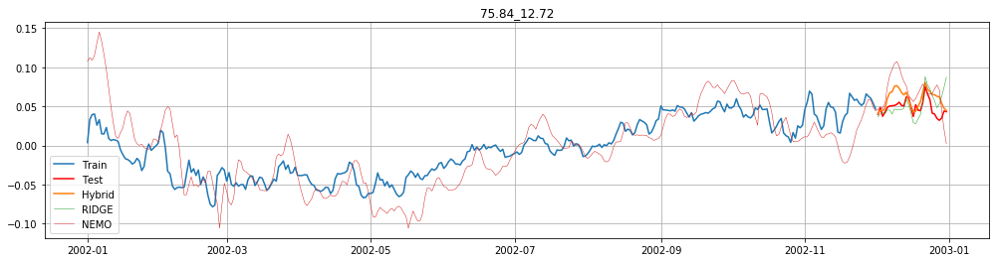

RIDGE:
MSE: 0.0002299260909341341
MAE: 0.011665593040692467
MAPE: 26.246

HYB:
MSE: 0.00022269757885944104
MAE: 0.012248749425259296
MAPE: 27.51


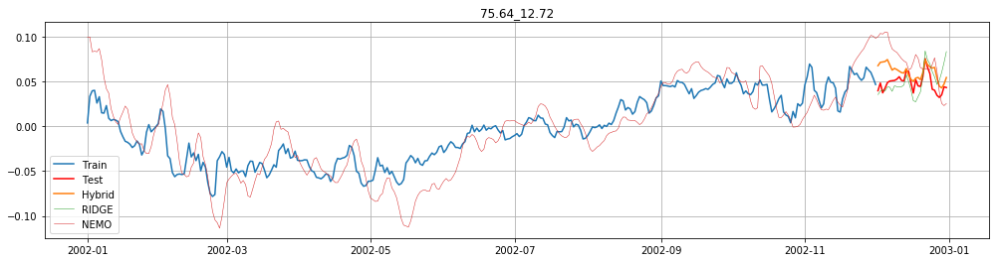

RIDGE:
MSE: 0.00020247419525758174
MAE: 0.011413234977471995
MAPE: 25.557

HYB:
MSE: 0.0002468563814224132
MAE: 0.012712431875035434
MAPE: 29.384


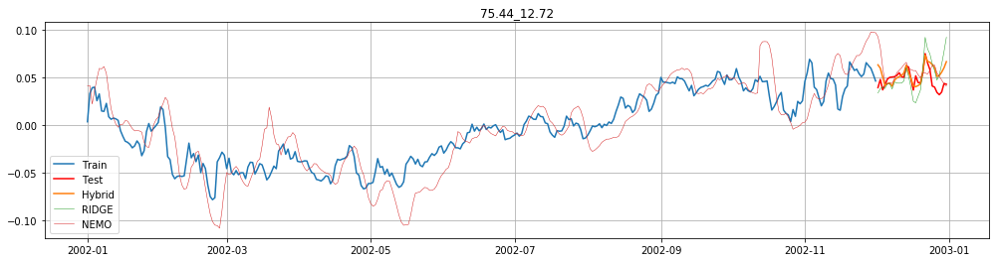

RIDGE:
MSE: 0.00029126998632541813
MAE: 0.01341063625653252
MAPE: 29.849

HYB:
MSE: 0.00014188722988693988
MAE: 0.00893919852766647
MAPE: 21.374


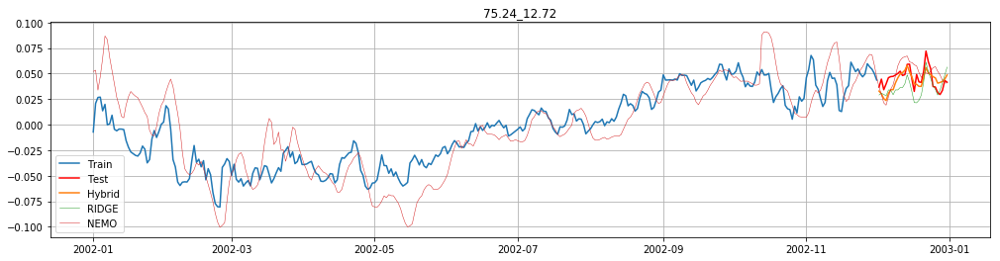

RIDGE:
MSE: 0.0001559392560818525
MAE: 0.011191829605992925
MAPE: 24.343

HYB:
MSE: 8.239153061383137e-05
MAE: 0.007944110221681575
MAPE: 18.42


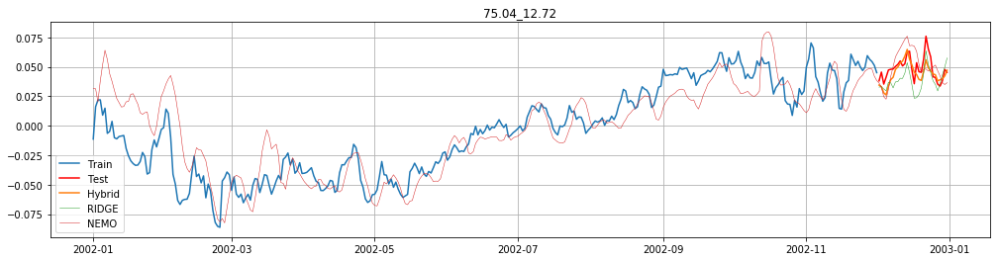

RIDGE:
MSE: 0.00015550847670125814
MAE: 0.011122231648121036
MAPE: 22.574

HYB:
MSE: 7.251426651103373e-05
MAE: 0.00704190672382998
MAPE: 14.379


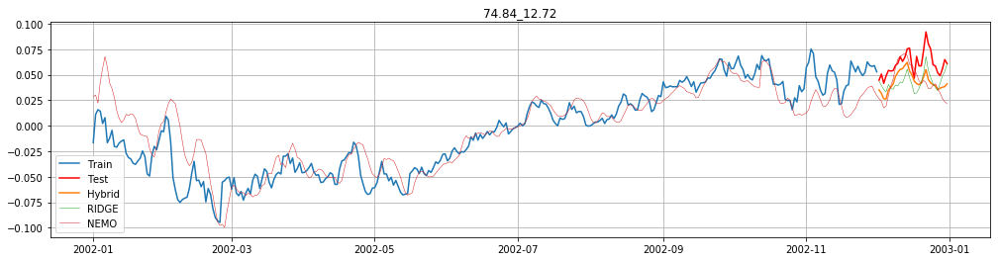

RIDGE:
MSE: 0.00037287851861347946
MAE: 0.01764275481124483
MAPE: 28.25

HYB:
MSE: 0.0003830788911968781
MAE: 0.01775399315860216
MAPE: 28.7


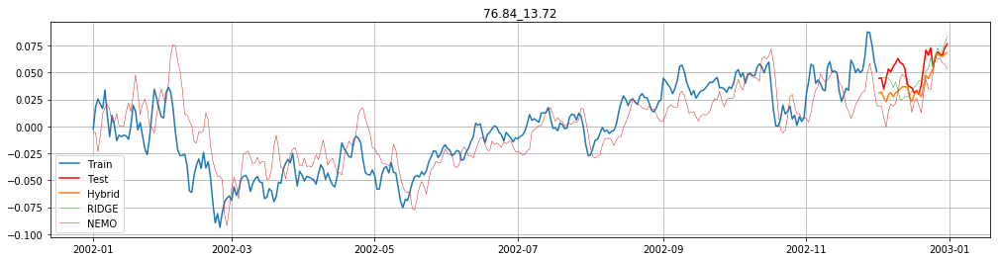

RIDGE:
MSE: 0.0001993704291568474
MAE: 0.010533597188723993
MAPE: 20.15

HYB:
MSE: 0.00026782280100561093
MAE: 0.013185452783756898
MAPE: 24.608


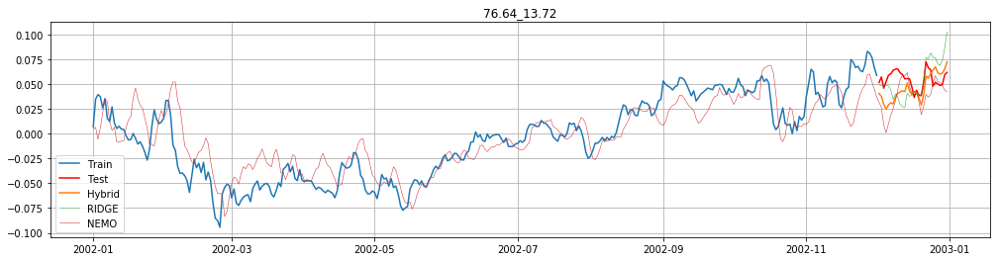

RIDGE:
MSE: 0.00040094746617532075
MAE: 0.01645466134578458
MAPE: 29.007

HYB:
MSE: 0.0002859518116568179
MAE: 0.014620542349728932
MAPE: 26.11


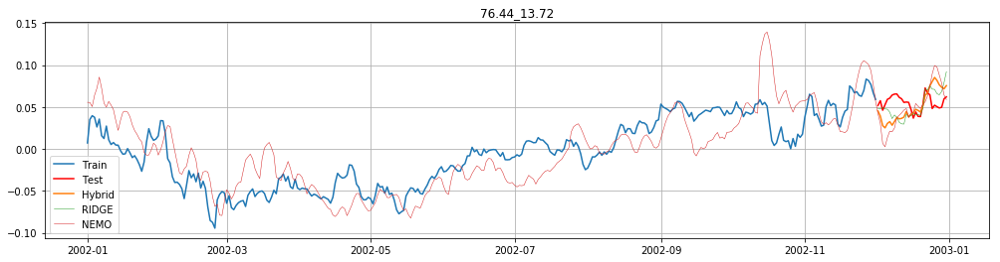

RIDGE:
MSE: 0.0002979281696799691
MAE: 0.014239866211160076
MAPE: 25.17

HYB:
MSE: 0.00044332788980785265
MAE: 0.01804792841961474
MAPE: 32.745


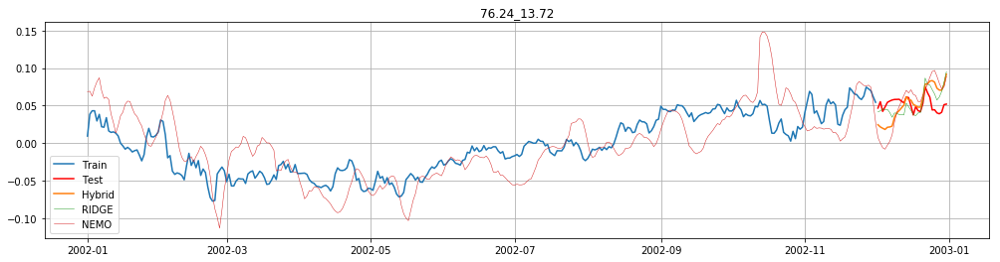

RIDGE:
MSE: 0.00030425863361524655
MAE: 0.014557626322767237
MAPE: 28.495

HYB:
MSE: 0.0005608176991306125
MAE: 0.019874388814051906
MAPE: 40.472


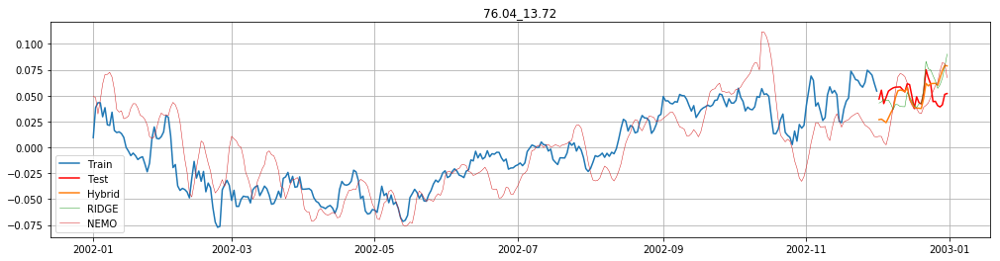

RIDGE:
MSE: 0.00025120488149784985
MAE: 0.013190371510535679
MAPE: 25.968

HYB:
MSE: 0.000293966925949854
MAE: 0.01393451121852072
MAPE: 28.38


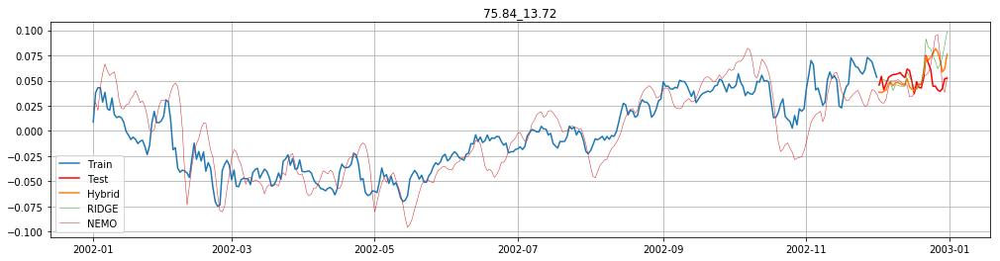

RIDGE:
MSE: 0.00030593559424548097
MAE: 0.013515495351635777
MAPE: 27.23

HYB:
MSE: 0.00024724069423922483
MAE: 0.011987945277912145
MAPE: 24.981


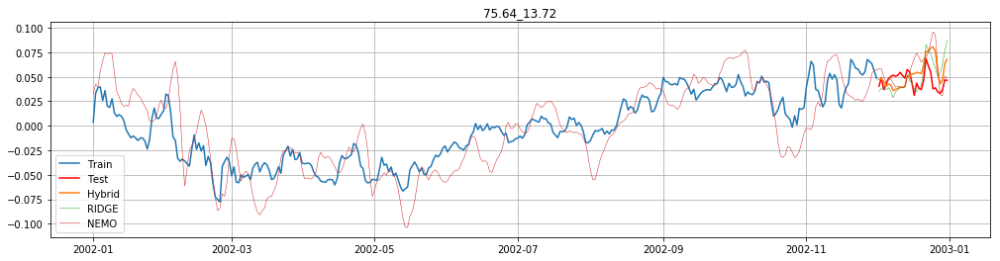

RIDGE:
MSE: 0.0002718770454560983
MAE: 0.013760550882792622
MAPE: 30.623

HYB:
MSE: 0.00027435188328956133
MAE: 0.013873538991874582
MAPE: 32.319


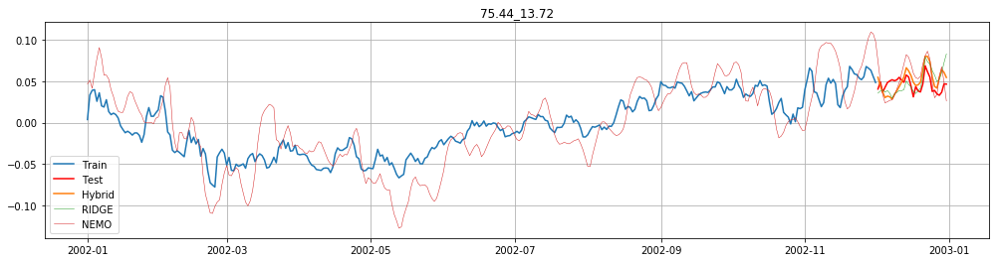

RIDGE:
MSE: 0.00023077996600386714
MAE: 0.012884421077029291
MAPE: 28.699

HYB:
MSE: 0.00019599945742518687
MAE: 0.012371538416768397
MAPE: 27.9


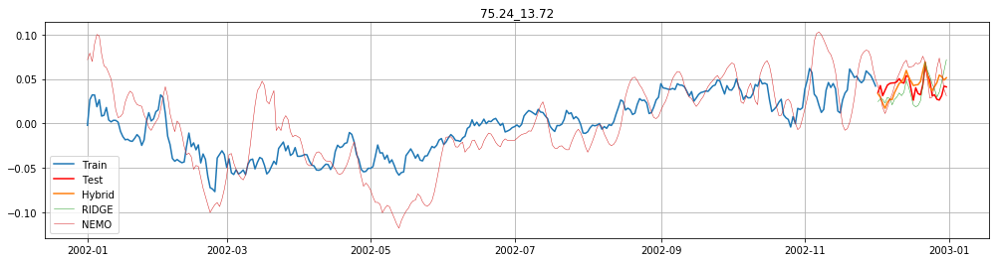

RIDGE:
MSE: 0.00018816957387736733
MAE: 0.01192241456655258
MAPE: 29.743

HYB:
MSE: 0.00016112075509488435
MAE: 0.010576422247624704
MAPE: 29.408


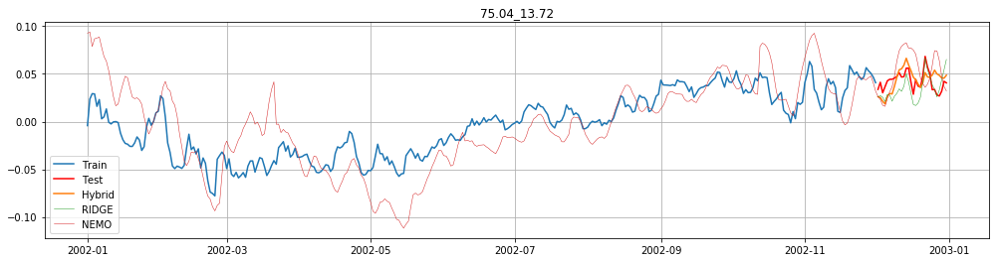

RIDGE:
MSE: 0.00018396981231498692
MAE: 0.011635033571923558
MAPE: 28.132

HYB:
MSE: 0.00015552321185517972
MAE: 0.010650455693309925
MAPE: 28.096


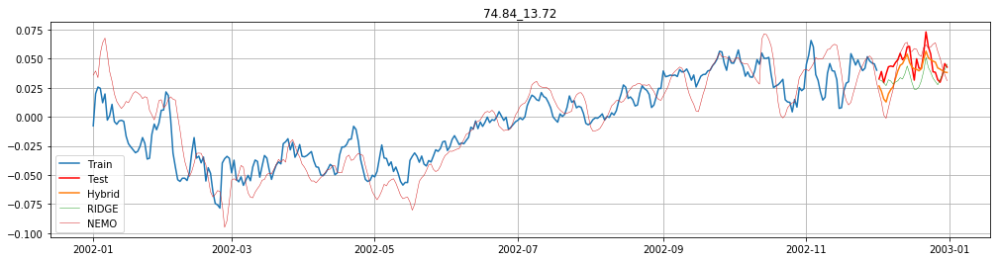

RIDGE:
MSE: 0.00019256792978247347
MAE: 0.011943393146759766
MAPE: 24.769

HYB:
MSE: 0.00013501001730365414
MAE: 0.009774111941469227
MAPE: 23.062


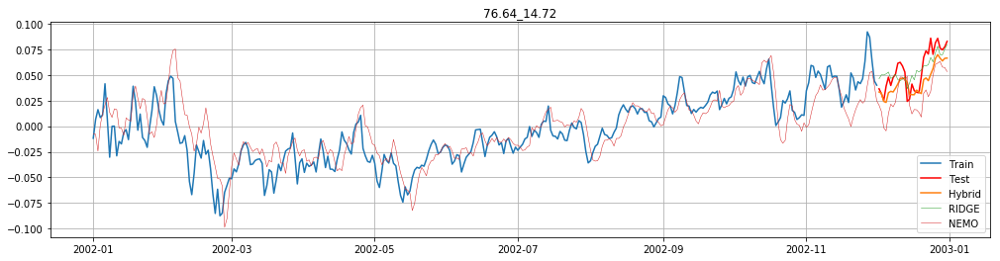

RIDGE:
MSE: 0.00015191282447835948
MAE: 0.010577278596502074
MAPE: 25.075

HYB:
MSE: 0.00023032701618833334
MAE: 0.012783453028585051
MAPE: 22.918


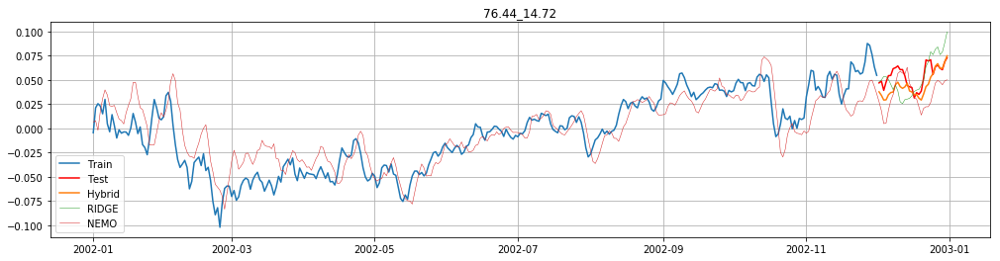

RIDGE:
MSE: 0.00027041157828976706
MAE: 0.013419844875869271
MAPE: 23.897

HYB:
MSE: 0.00018396381354274555
MAE: 0.01061341161618521
MAPE: 19.186


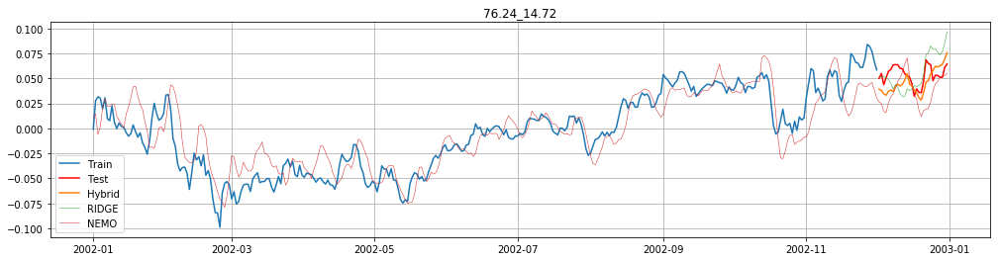

RIDGE:
MSE: 0.00033047372327317943
MAE: 0.015516501726481535
MAPE: 28.603

HYB:
MSE: 0.00019024292649685607
MAE: 0.012251548831858963
MAPE: 22.239


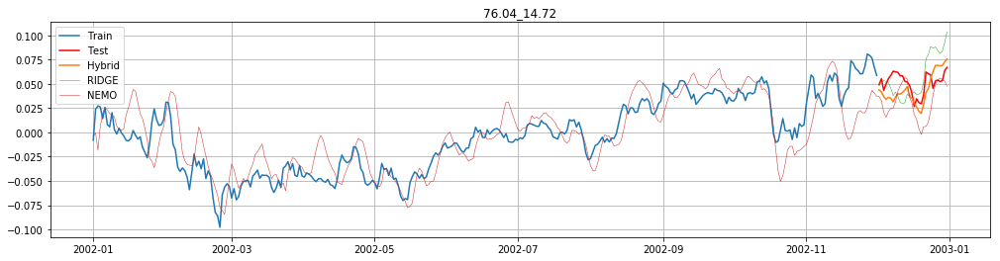

RIDGE:
MSE: 0.000474016699610564
MAE: 0.018592592142115002
MAPE: 35.833

HYB:
MSE: 0.00023347802293314712
MAE: 0.013628512360976081
MAPE: 26.153


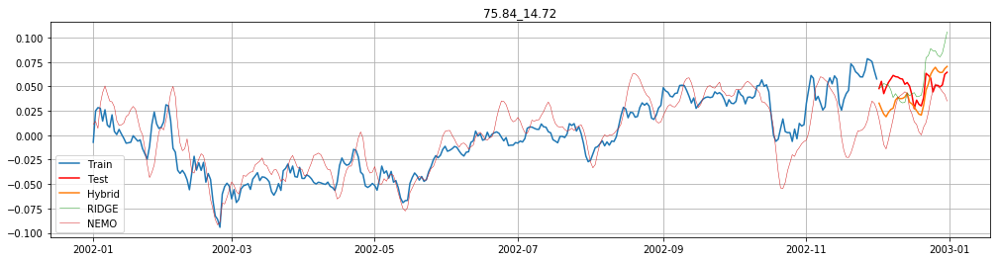

RIDGE:
MSE: 0.0004739202731528228
MAE: 0.018269550815961582
MAPE: 35.817

HYB:
MSE: 0.00033855762766829355
MAE: 0.016303806442820416
MAPE: 31.991


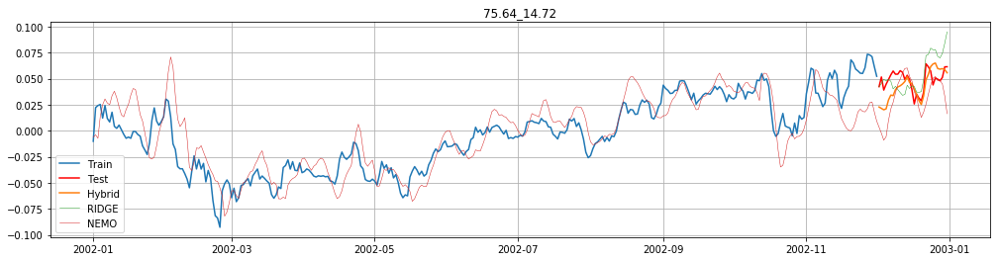

RIDGE:
MSE: 0.00028044356379722094
MAE: 0.01400919533058691
MAPE: 28.807

HYB:
MSE: 0.0001929005330766117
MAE: 0.011455066740212846
MAPE: 24.07


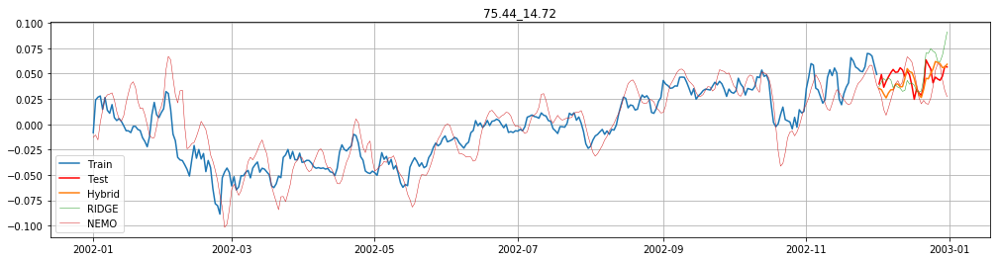

RIDGE:
MSE: 0.00024146265291707675
MAE: 0.012808125573635722
MAPE: 27.324

HYB:
MSE: 0.0001532305021459817
MAE: 0.010438191413395238
MAPE: 23.179


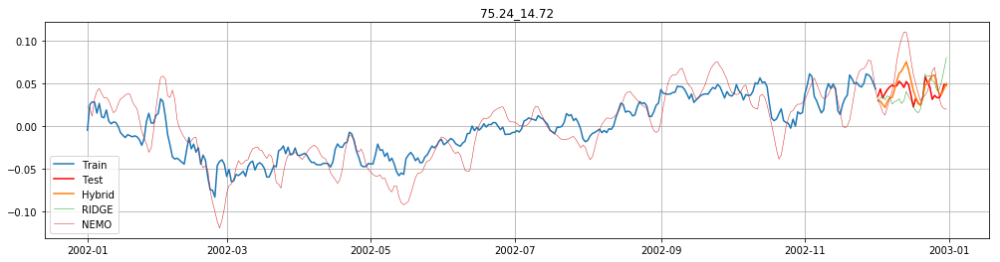

RIDGE:
MSE: 0.00020545187875532797
MAE: 0.012302927643507454
MAPE: 29.633

HYB:
MSE: 0.00017890233222566973
MAE: 0.01071216614936708
MAPE: 27.268


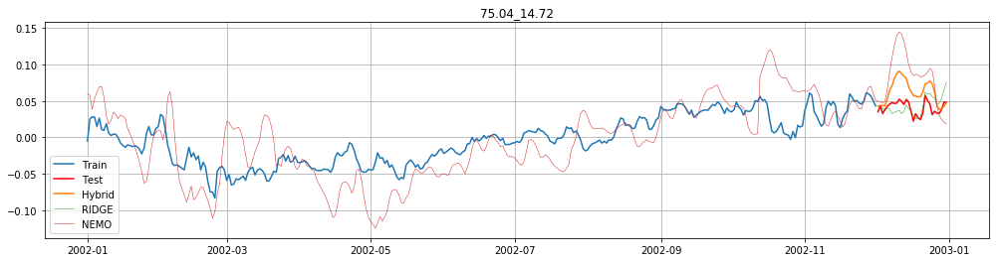

RIDGE:
MSE: 0.00014734225449729646
MAE: 0.01010104451063252
MAPE: 25.146

HYB:
MSE: 0.0006519781532680704
MAE: 0.021944215740426598
MAPE: 57.728


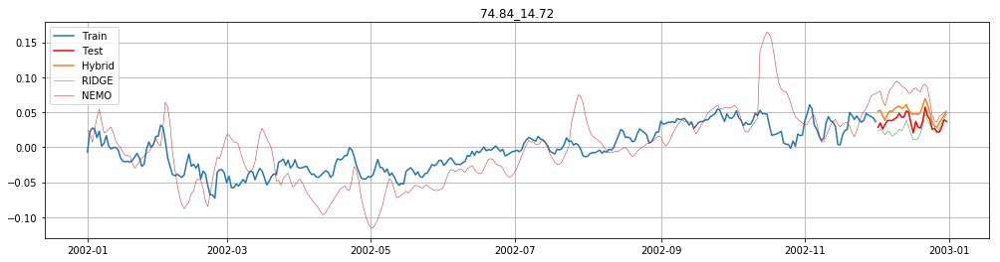

RIDGE:
MSE: 0.0001891389811817724
MAE: 0.011685338740868013
MAPE: 31.53

HYB:
MSE: 0.0002043808698317451
MAE: 0.013156408046375008
MAPE: 40.359


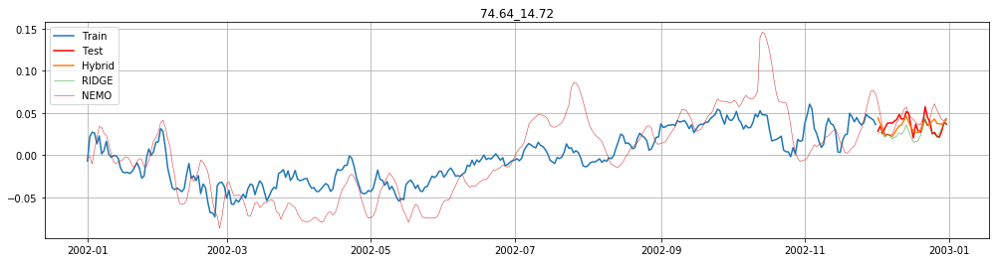

RIDGE:
MSE: 0.00015060580290760173
MAE: 0.010191859854388032
MAPE: 26.384

HYB:
MSE: 0.00010906218100793119
MAE: 0.008844453941210247
MAPE: 26.883


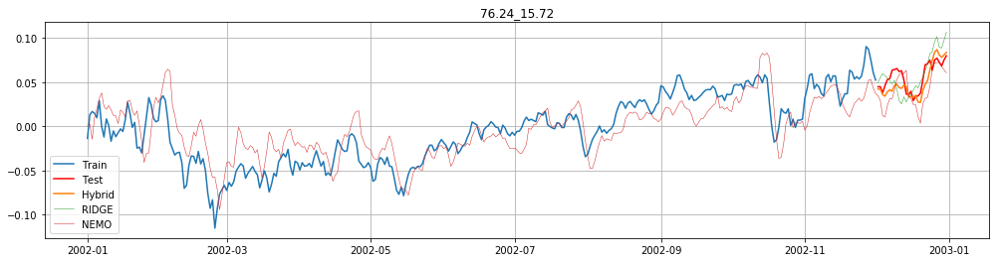

RIDGE:
MSE: 0.0002881764522173411
MAE: 0.014142217894791885
MAPE: 25.466

HYB:
MSE: 0.000147282098619863
MAE: 0.010348013819165707
MAPE: 18.132


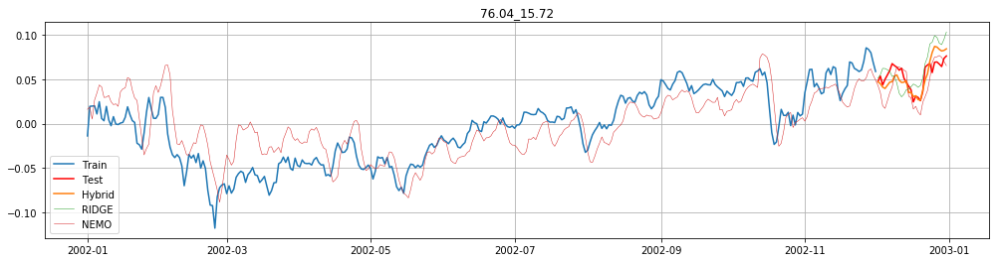

RIDGE:
MSE: 0.0003437424948459618
MAE: 0.015920186867124535
MAPE: 30.792

HYB:
MSE: 0.00012635026071088827
MAE: 0.009260619169525454
MAPE: 15.92


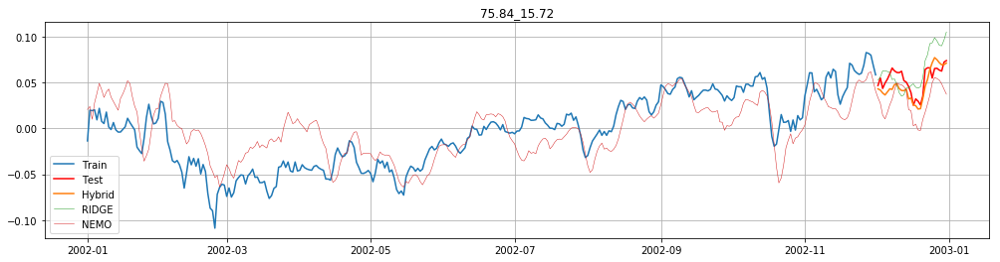

RIDGE:
MSE: 0.00039505191260193125
MAE: 0.01722450631584726
MAPE: 34.236

HYB:
MSE: 0.00013943695778984223
MAE: 0.010202093063076909
MAPE: 18.937


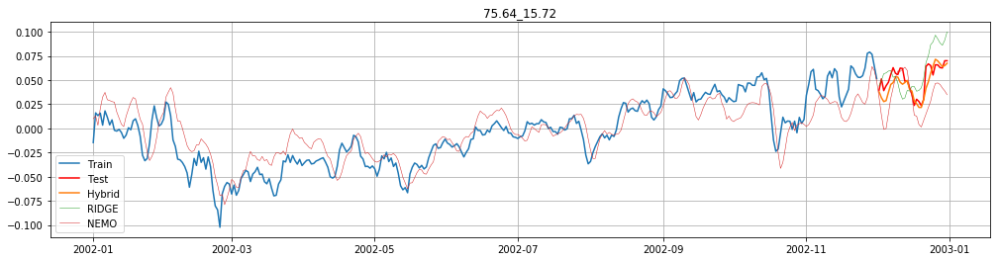

RIDGE:
MSE: 0.0003431596802432041
MAE: 0.015845447755944857
MAPE: 33.005

HYB:
MSE: 9.663726434188011e-05
MAE: 0.0075375383077873285
MAPE: 14.672


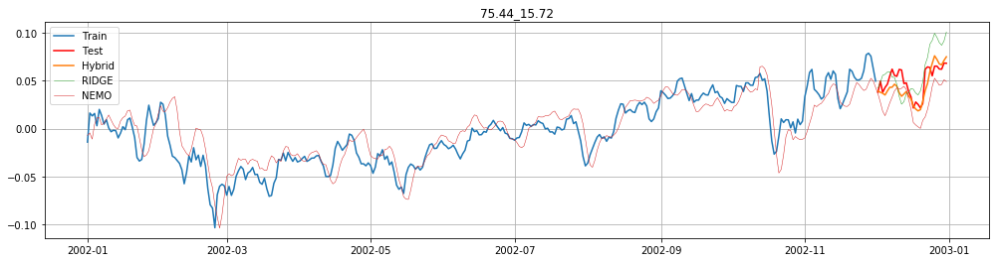

RIDGE:
MSE: 0.0004017456658544155
MAE: 0.01686940970032497
MAPE: 36.184

HYB:
MSE: 0.00012960950372887484
MAE: 0.009091575090949978
MAPE: 17.566


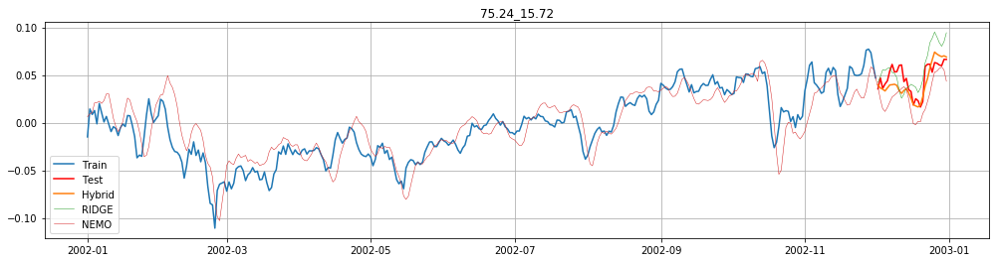

RIDGE:
MSE: 0.00035081263401581206
MAE: 0.015840787369349466
MAPE: 38.201

HYB:
MSE: 0.00015145056559705307
MAE: 0.010062374049581935
MAPE: 20.591


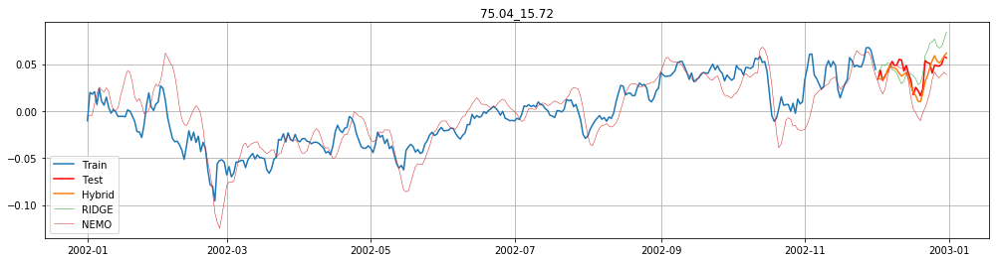

RIDGE:
MSE: 0.0002613004524283505
MAE: 0.013877986336983677
MAPE: 36.112

HYB:
MSE: 7.204515877362641e-05
MAE: 0.006665374003997207
MAPE: 16.906


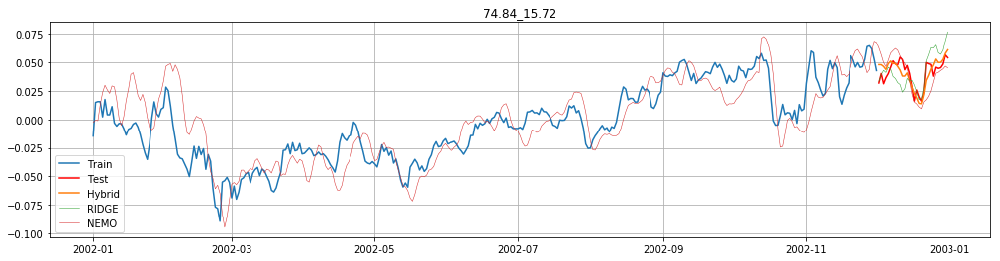

RIDGE:
MSE: 0.0001755713898642821
MAE: 0.010827271155287862
MAPE: 26.55

HYB:
MSE: 6.365826738256774e-05
MAE: 0.006707532787104897
MAPE: 18.022


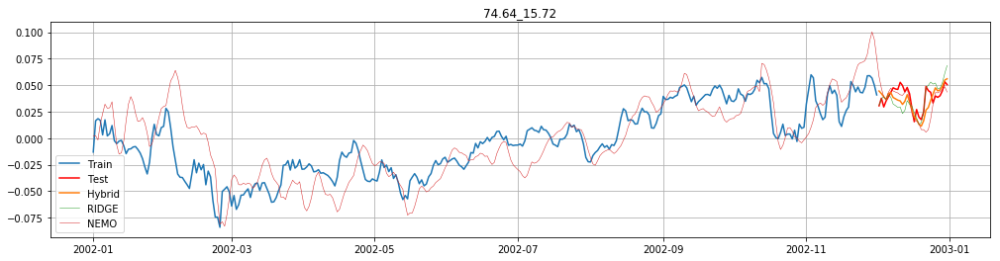

RIDGE:
MSE: 0.0001342246389128893
MAE: 0.00928875944102604
MAPE: 23.788

HYB:
MSE: 9.056759541710356e-05
MAE: 0.008050656727309697
MAPE: 21.828


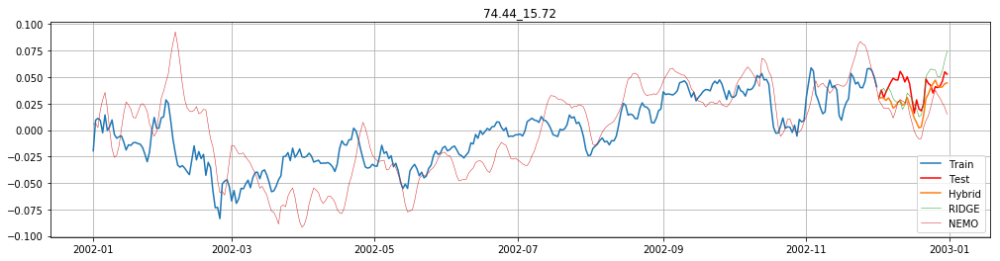

RIDGE:
MSE: 0.00020766179461056015
MAE: 0.011579190286424375
MAPE: 28.059

HYB:
MSE: 0.00024156145171004654
MAE: 0.01302678346096296
MAPE: 34.07


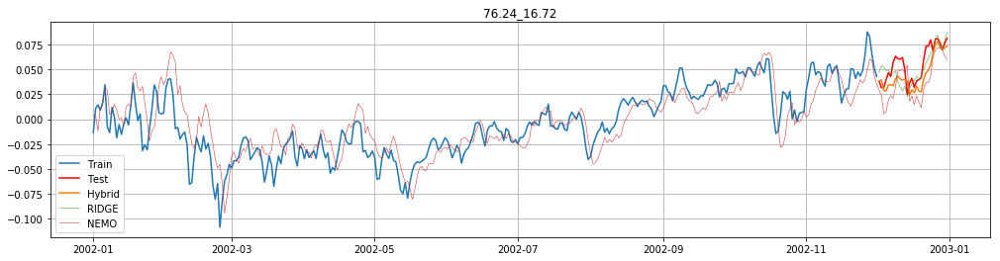

RIDGE:
MSE: 0.00016816728987112742
MAE: 0.009592563660583645
MAPE: 19.182

HYB:
MSE: 0.00020453239829047214
MAE: 0.011875112187371363
MAPE: 22.691


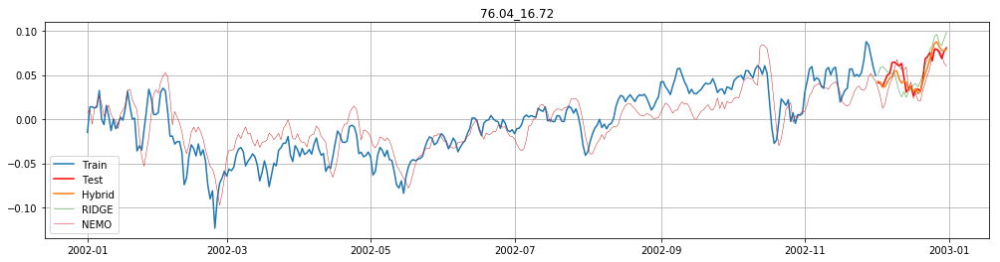

RIDGE:
MSE: 0.00021833787301494425
MAE: 0.0123025240646996
MAPE: 23.589

HYB:
MSE: 7.961082390099051e-05
MAE: 0.006998356346972125
MAPE: 12.586


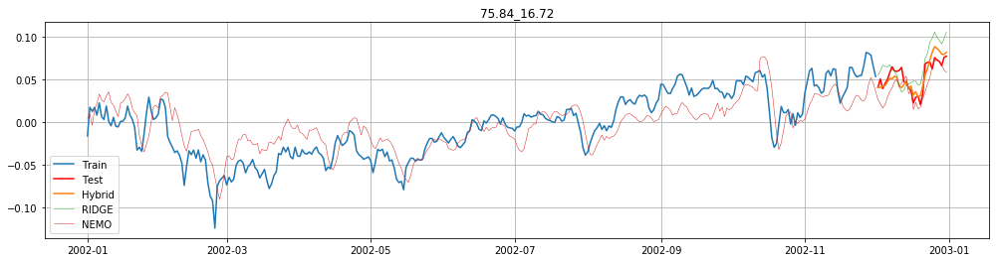

RIDGE:
MSE: 0.0003888193809299646
MAE: 0.0171885239241129
MAPE: 36.803

HYB:
MSE: 0.00010257933508981303
MAE: 0.008214787281844401
MAPE: 16.137


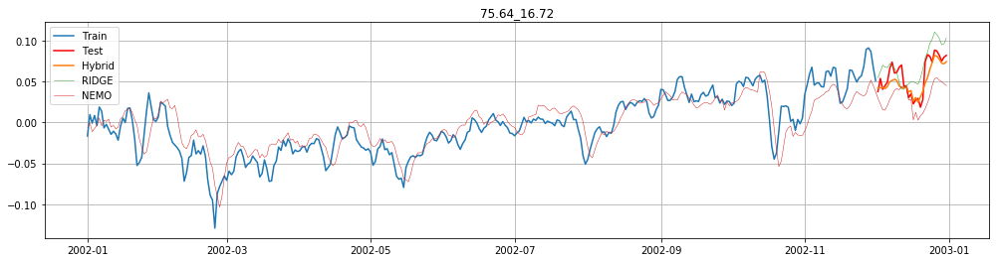

RIDGE:
MSE: 0.0003846960364567487
MAE: 0.016885822176029998
MAPE: 40.438

HYB:
MSE: 0.00015876166291364763
MAE: 0.009596523577872463
MAPE: 17.794


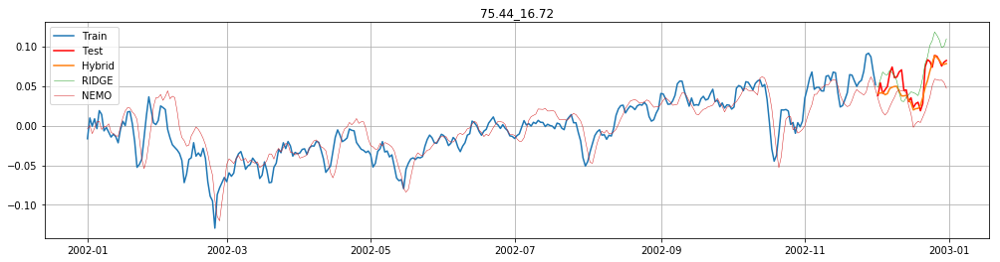

RIDGE:
MSE: 0.0004047309442965829
MAE: 0.01711670556202075
MAPE: 36.292

HYB:
MSE: 0.0001736567199891661
MAE: 0.009773512023164775
MAPE: 17.942


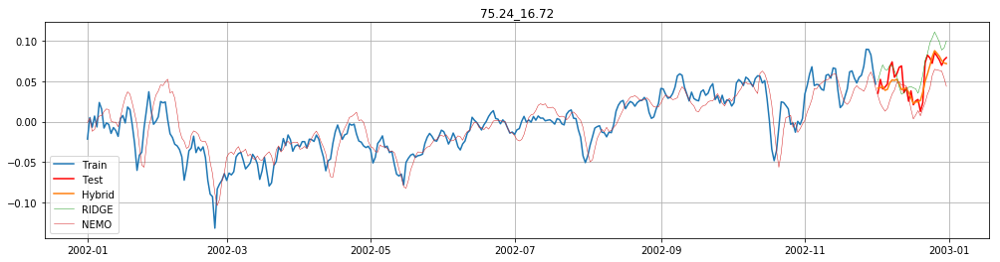

RIDGE:
MSE: 0.0003774227472422459
MAE: 0.016306265261294788
MAPE: 41.818

HYB:
MSE: 0.0001488741157078178
MAE: 0.009478129197929295
MAPE: 20.383


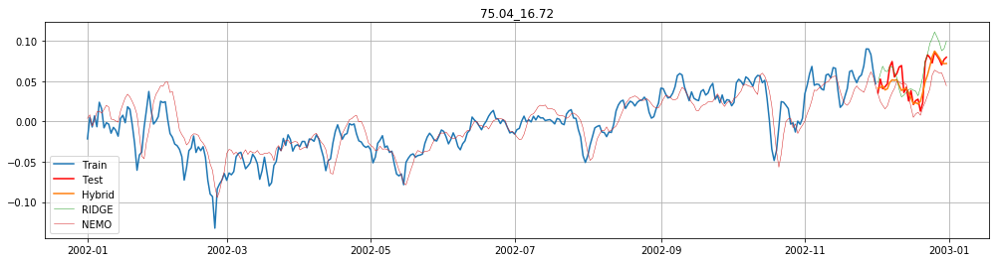

RIDGE:
MSE: 0.00034371442866238885
MAE: 0.015235673809869689
MAPE: 37.956

HYB:
MSE: 0.00015760591503703798
MAE: 0.009589724534901856
MAPE: 20.343


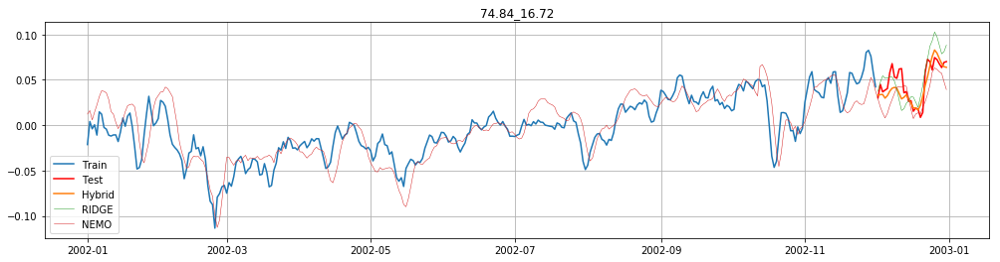

RIDGE:
MSE: 0.0003504133805797709
MAE: 0.015096531581446164
MAPE: 43.672

HYB:
MSE: 0.00017192105987696952
MAE: 0.010131804930960503
MAPE: 26.292


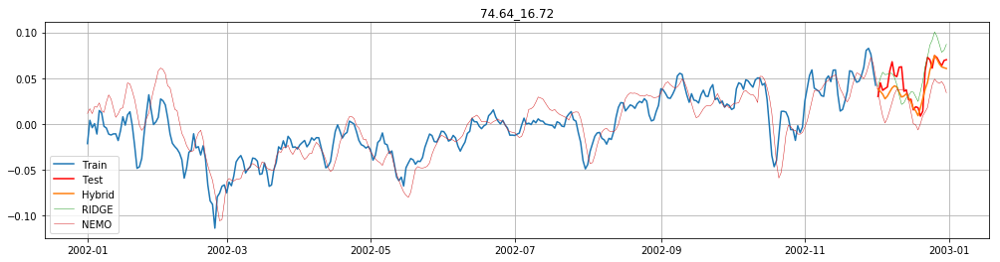

RIDGE:
MSE: 0.0003290561682747454
MAE: 0.015175303748070199
MAPE: 48.053

HYB:
MSE: 0.000191426080295342
MAE: 0.010591743261383556
MAPE: 26.745


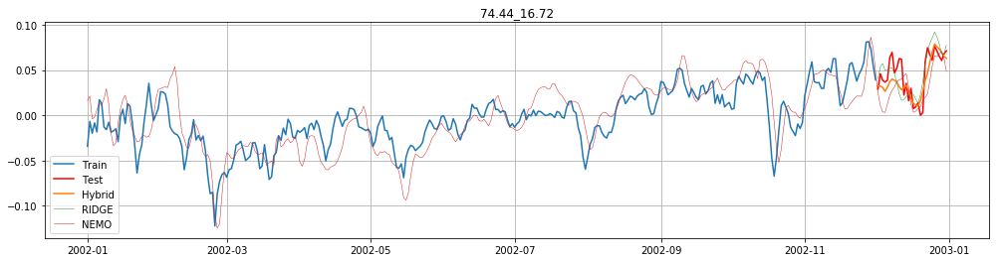

RIDGE:
MSE: 0.0002994235605485511
MAE: 0.013668508536834493
MAPE: 927.831

HYB:
MSE: 0.00024175238650782498
MAE: 0.012433902271331258
MAPE: 659.007


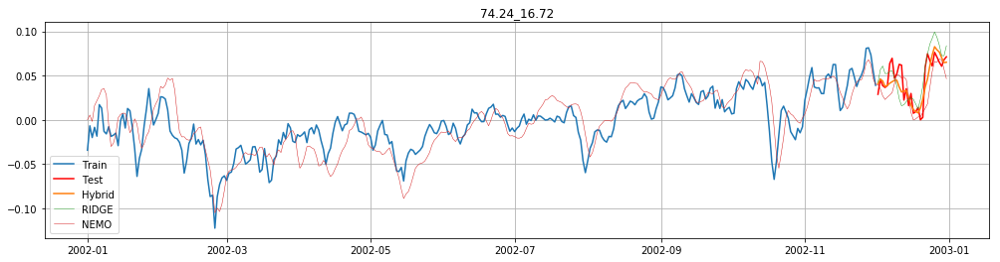

RIDGE:
MSE: 0.0003602163745218543
MAE: 0.015375813155778958
MAPE: 944.568

HYB:
MSE: 0.00019727568215572897
MAE: 0.010880306669311465
MAPE: 543.463


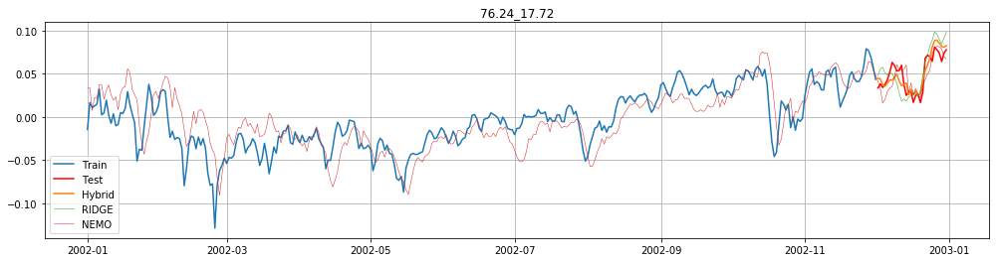

RIDGE:
MSE: 0.0002698589536555231
MAE: 0.013937777466057674
MAPE: 31.536

HYB:
MSE: 0.00011770727702534181
MAE: 0.009071316457366703
MAPE: 20.966


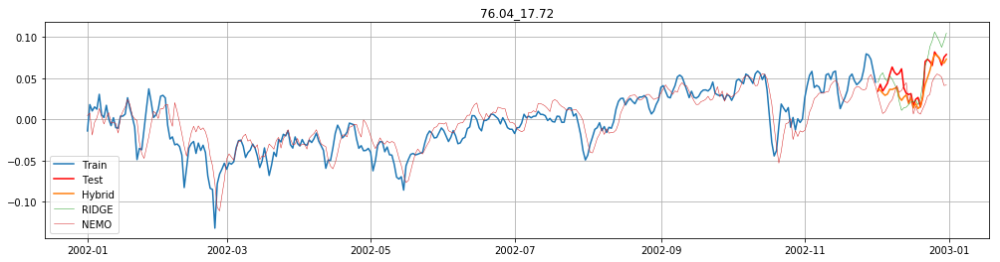

RIDGE:
MSE: 0.0003744777746297686
MAE: 0.016095679009763195
MAPE: 34.116

HYB:
MSE: 0.0002120782283314182
MAE: 0.010730159442007229
MAPE: 21.592


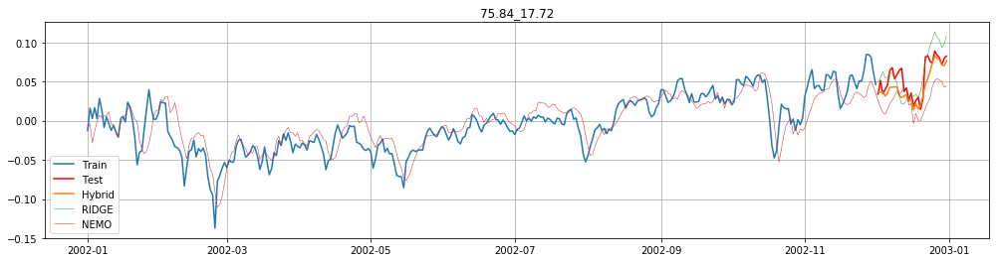

RIDGE:
MSE: 0.00037174132214507513
MAE: 0.015693013911737656
MAPE: 34.695

HYB:
MSE: 0.0002438877350135118
MAE: 0.01153499977274401
MAPE: 21.533


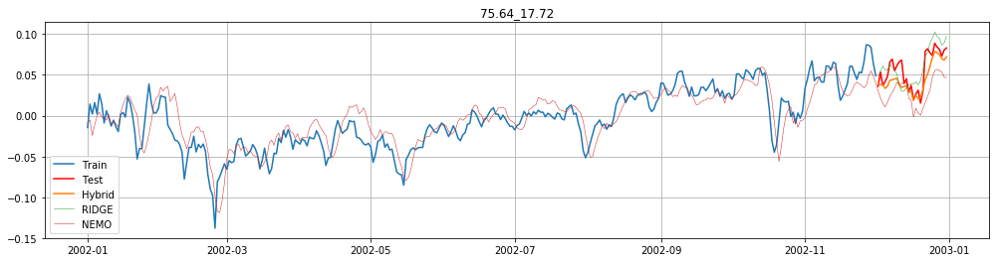

RIDGE:
MSE: 0.00025104188776682644
MAE: 0.013233886283046106
MAPE: 32.227

HYB:
MSE: 0.00023692030996192622
MAE: 0.011760190990339014
MAPE: 20.188


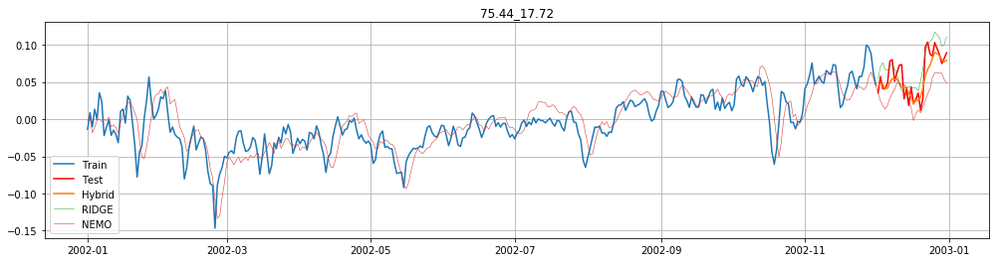

RIDGE:
MSE: 0.00042781371034124625
MAE: 0.017637574597285398
MAPE: 47.196

HYB:
MSE: 0.00027330631611267815
MAE: 0.012732252469595159
MAPE: 26.771


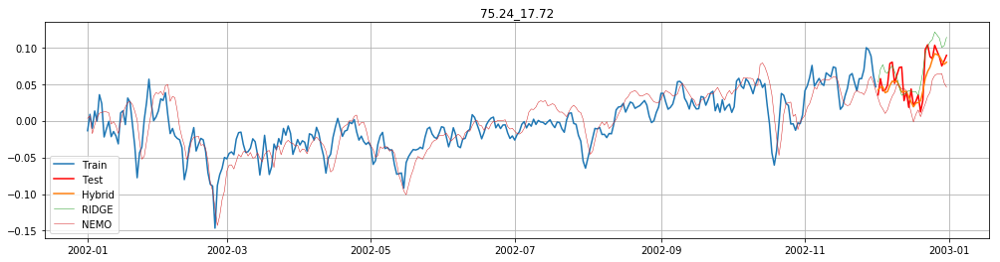

RIDGE:
MSE: 0.0004481413603948232
MAE: 0.017939969654807094
MAPE: 45.592

HYB:
MSE: 0.0002791064899673977
MAE: 0.012666945858725298
MAPE: 25.756


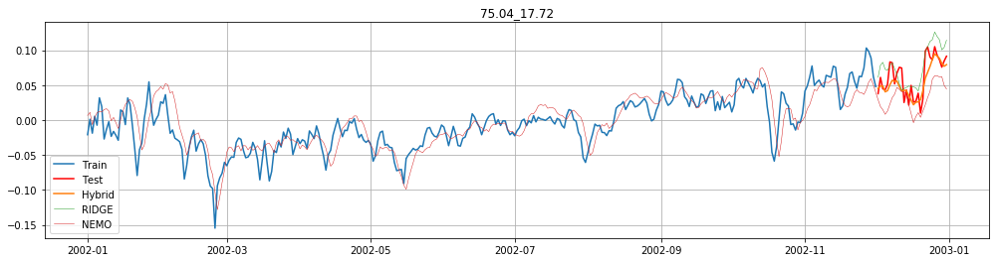

RIDGE:
MSE: 0.0005390216274254022
MAE: 0.019719480896983128
MAPE: 53.294

HYB:
MSE: 0.00029940702451640634
MAE: 0.013303551681976647
MAPE: 28.155


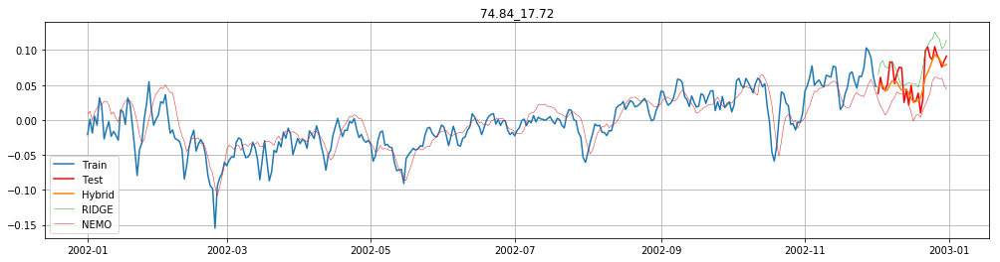

RIDGE:
MSE: 0.000621039257130865
MAE: 0.02140133831409097
MAPE: 59.633

HYB:
MSE: 0.00030517615583699695
MAE: 0.0133913265501029
MAPE: 29.039


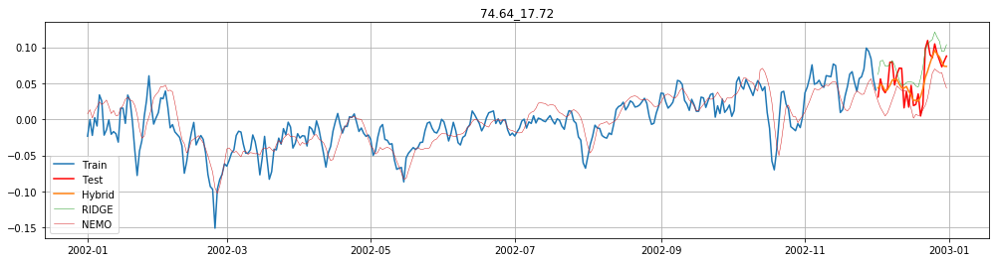

RIDGE:
MSE: 0.0006650321599690134
MAE: 0.02194085446800729
MAPE: 95.91

HYB:
MSE: 0.0003356150652772881
MAE: 0.014395444467081938
MAPE: 50.872


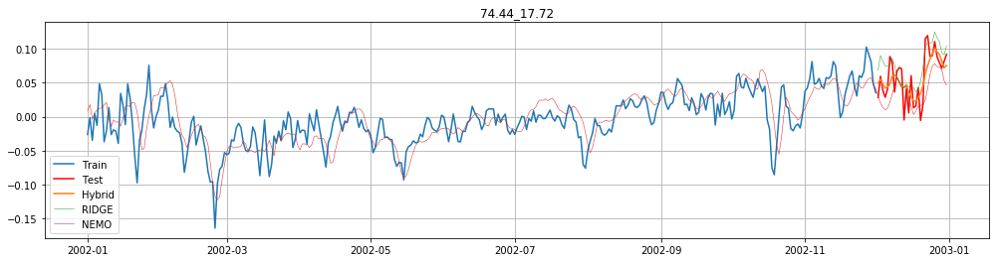

RIDGE:
MSE: 0.0008699243780794139
MAE: 0.025460056705166347
MAPE: 12.627

HYB:
MSE: 0.0005669358352509132
MAE: 0.019099654835726856
MAPE: -6.872


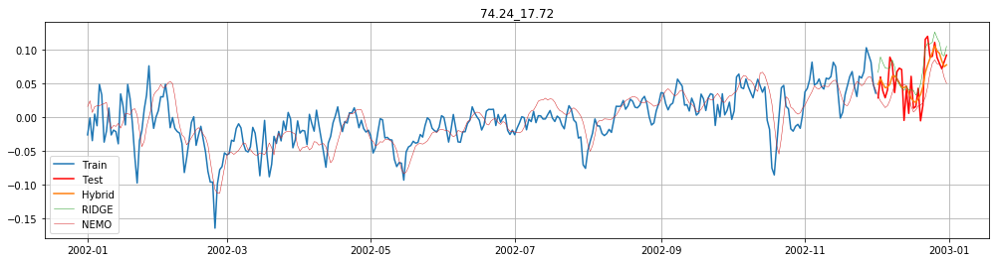

RIDGE:
MSE: 0.0008104397791632905
MAE: 0.024920647811356843
MAPE: 12.317

HYB:
MSE: 0.0005579080126818041
MAE: 0.019113801059710632
MAPE: -6.078


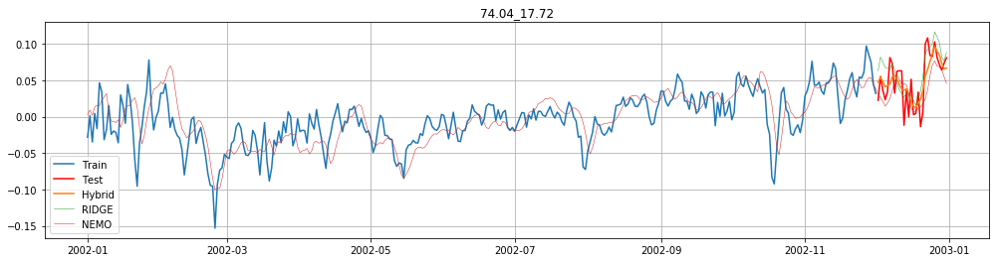

RIDGE:
MSE: 0.0007246259464194182
MAE: 0.023375526139405287
MAPE: -2140.634

HYB:
MSE: 0.0005385465142395604
MAE: 0.01905657288857665
MAPE: -2249.16


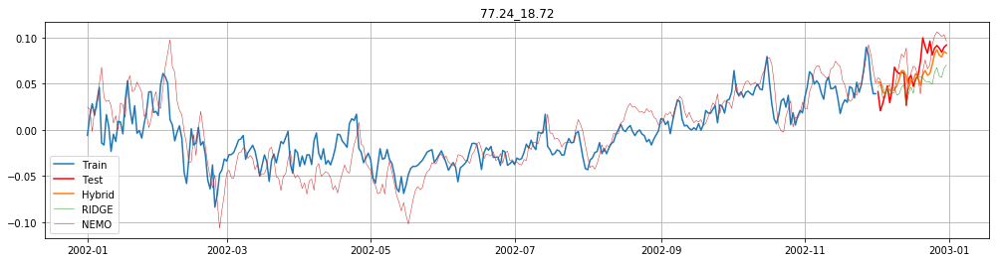

RIDGE:
MSE: 0.0005052127779490805
MAE: 0.018654490685794268
MAPE: 29.639

HYB:
MSE: 0.00028693007997220417
MAE: 0.012766358967554051
MAPE: 25.212


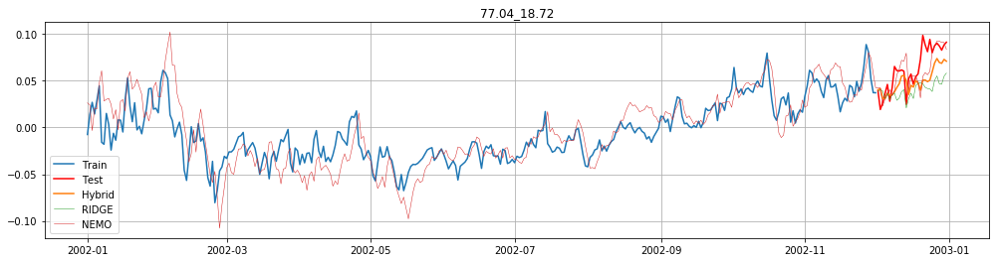

RIDGE:
MSE: 0.000831325933775394
MAE: 0.024749959395750323
MAPE: 37.71

HYB:
MSE: 0.00043942393217563143
MAE: 0.017171564124037385
MAPE: 29.165


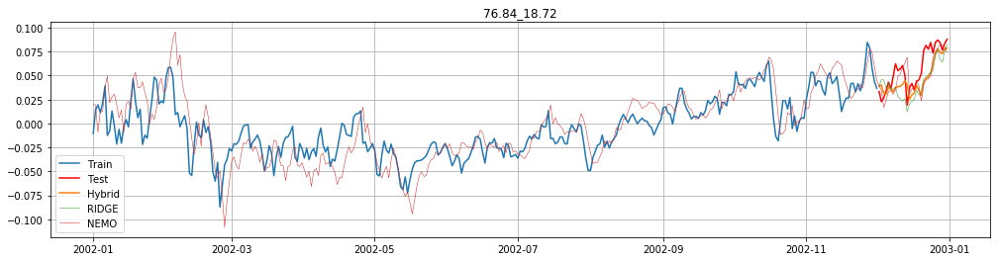

RIDGE:
MSE: 0.0003872635836649554
MAE: 0.01698095973559314
MAPE: 32.629

HYB:
MSE: 0.00028472705677219255
MAE: 0.013857082217331498
MAPE: 26.987


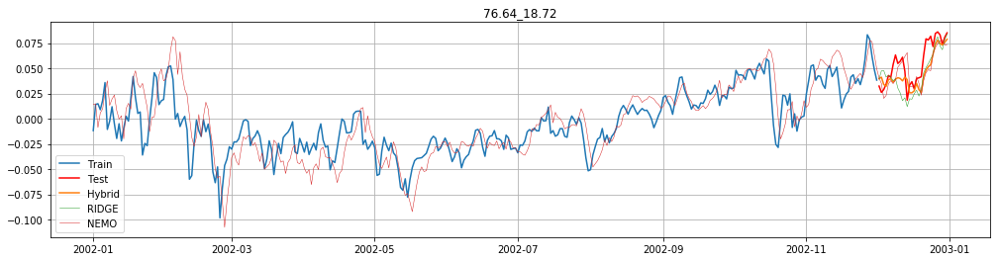

RIDGE:
MSE: 0.00031589120197237454
MAE: 0.014507728721684586
MAPE: 29.93

HYB:
MSE: 0.0002192612215315614
MAE: 0.012117814823956624
MAPE: 24.725


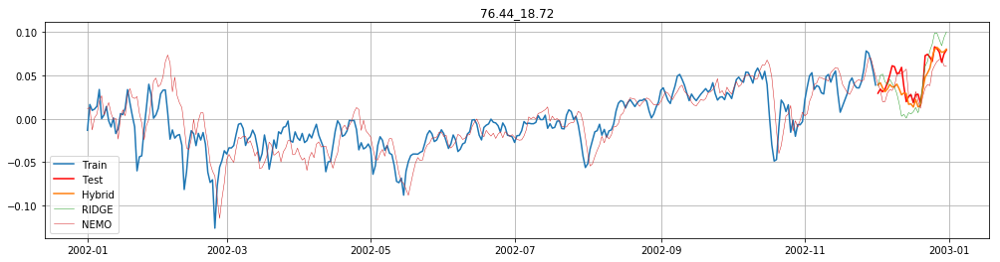

RIDGE:
MSE: 0.00041413237193534
MAE: 0.017291100456217436
MAPE: 40.23

HYB:
MSE: 0.00016705659132948804
MAE: 0.01014503877392412
MAPE: 22.842


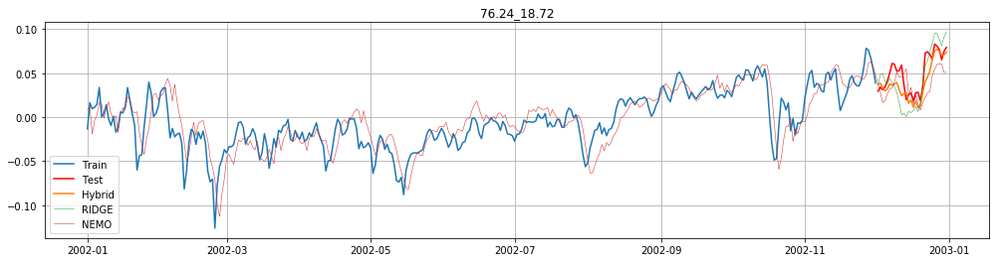

RIDGE:
MSE: 0.0004006492409619443
MAE: 0.016767682239373475
MAPE: 39.631

HYB:
MSE: 0.00021943225266637508
MAE: 0.011642684915920931
MAPE: 25.853


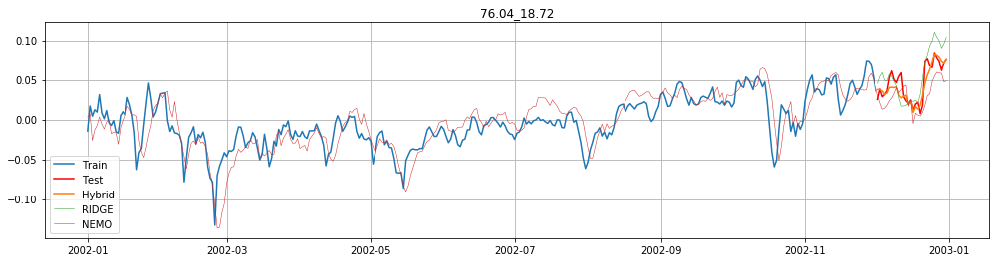

RIDGE:
MSE: 0.0004193346720892168
MAE: 0.016583274522179756
MAPE: 49.412

HYB:
MSE: 0.00014890835451838644
MAE: 0.008772132482686127
MAPE: 24.294


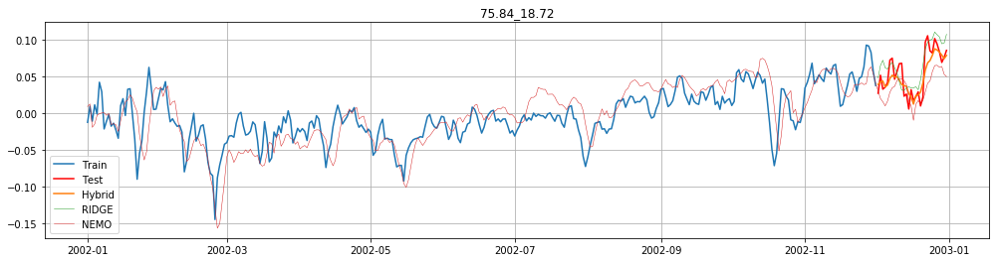

RIDGE:
MSE: 0.0004350671339119941
MAE: 0.017690485145443437
MAPE: 66.679

HYB:
MSE: 0.0002668649455233857
MAE: 0.012813432361975576
MAPE: 41.243


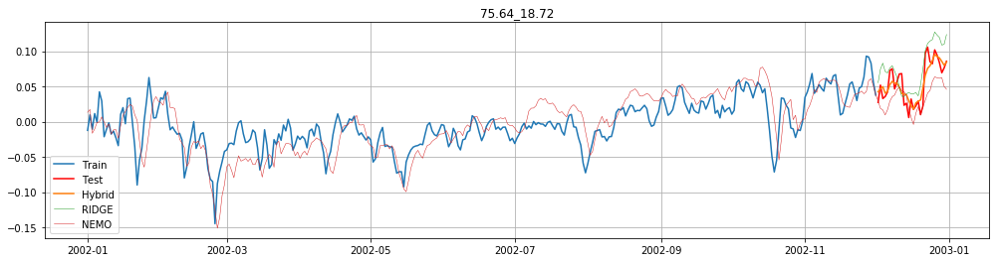

RIDGE:
MSE: 0.0007957758438089722
MAE: 0.02459756297787346
MAPE: 86.206

HYB:
MSE: 0.0002325674682199566
MAE: 0.01194743977382582
MAPE: 43.505


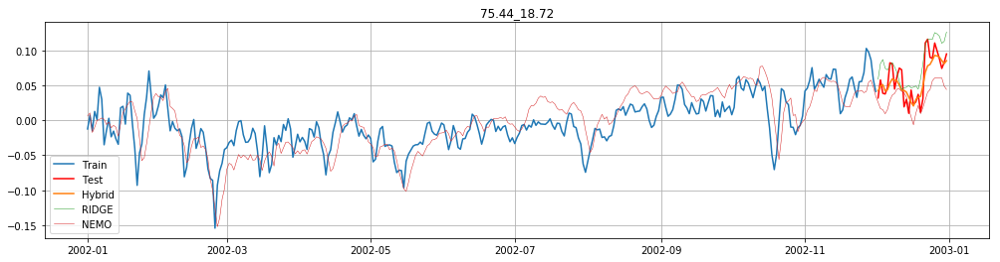

RIDGE:
MSE: 0.0007575730755271941
MAE: 0.023824453001162094
MAPE: 73.478

HYB:
MSE: 0.0003217332057570456
MAE: 0.014341353826611196
MAPE: 37.803


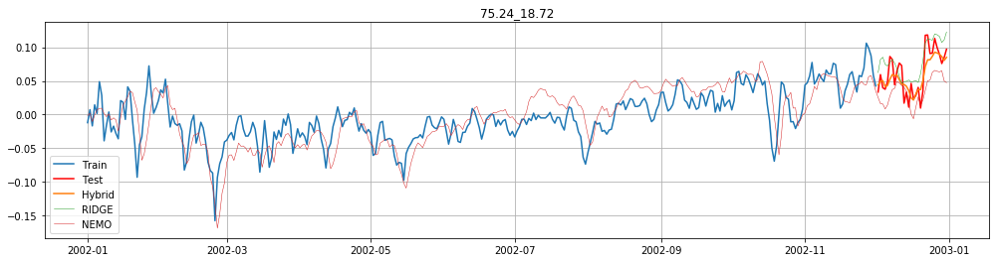

RIDGE:
MSE: 0.0006874236847009858
MAE: 0.022720332444521853
MAPE: 73.956

HYB:
MSE: 0.0003652144966236977
MAE: 0.015185342606976538
MAPE: 41.09


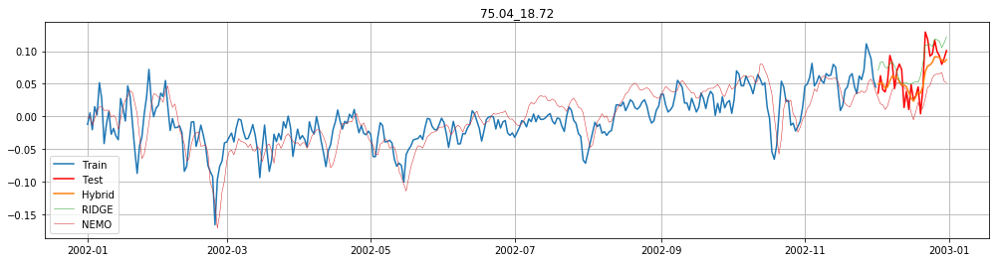

RIDGE:
MSE: 0.0006811605978066396
MAE: 0.02237995782522329
MAPE: 104.668

HYB:
MSE: 0.00047776498796264316
MAE: 0.01709904257940893
MAPE: 62.413


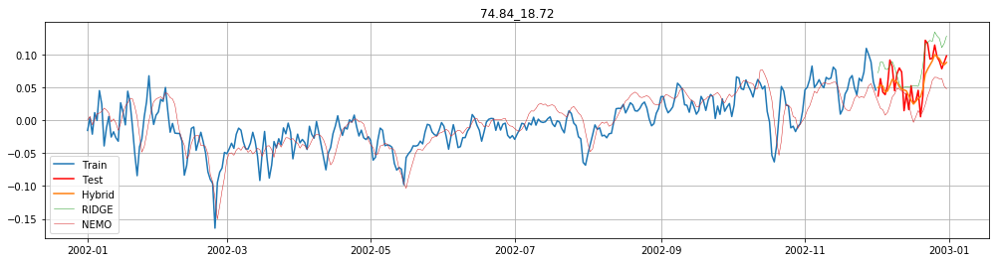

RIDGE:
MSE: 0.0008222749432852287
MAE: 0.024989943531730015
MAPE: 89.622

HYB:
MSE: 0.0004020078078632078
MAE: 0.015460510670741395
MAPE: 48.395


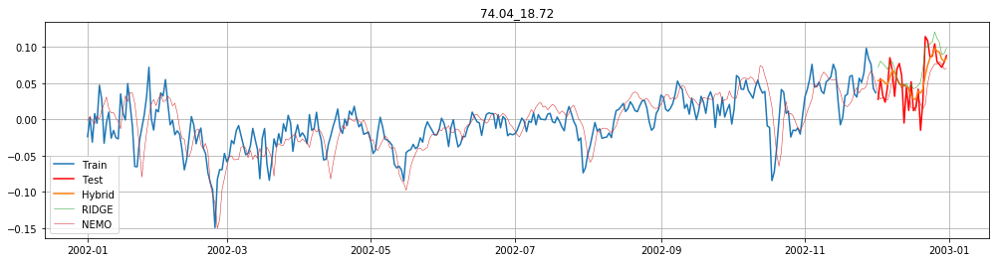

RIDGE:
MSE: 0.0008589179896325845
MAE: 0.024753208702313186
MAPE: 16.522

HYB:
MSE: 0.0005609043315859575
MAE: 0.018016246606736872
MAPE: -5.015


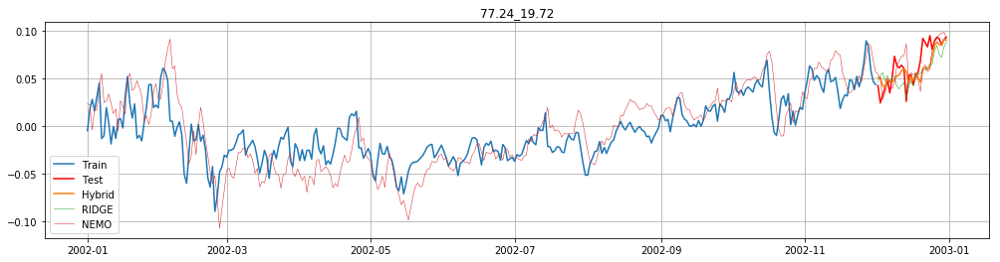

RIDGE:
MSE: 0.00027669612454890336
MAE: 0.013810439267039138
MAPE: 23.61

HYB:
MSE: 0.00023661588777733604
MAE: 0.0111439270246038
MAPE: 21.336


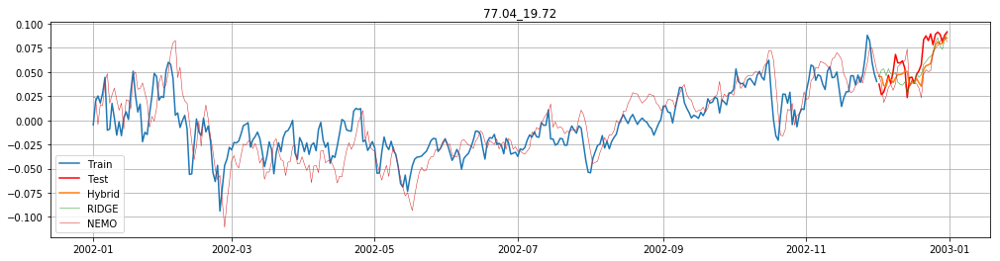

RIDGE:
MSE: 0.0002189191518363849
MAE: 0.012262224755017648
MAPE: 22.899

HYB:
MSE: 0.00023723121831384597
MAE: 0.012226046985378082
MAPE: 22.512


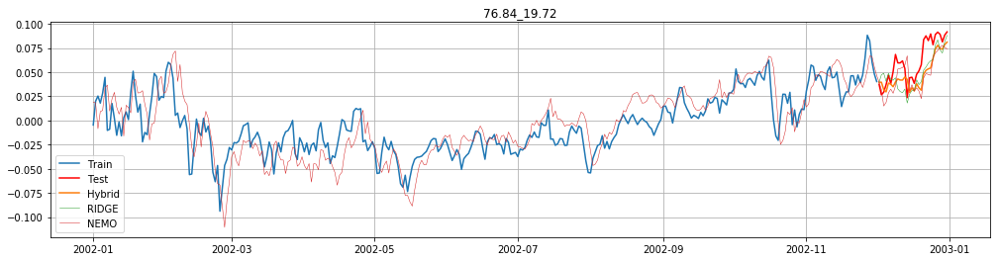

RIDGE:
MSE: 0.0003326877659596532
MAE: 0.015475884596907
MAPE: 27.235

HYB:
MSE: 0.00033371607368432656
MAE: 0.015616102927457309
MAPE: 26.567


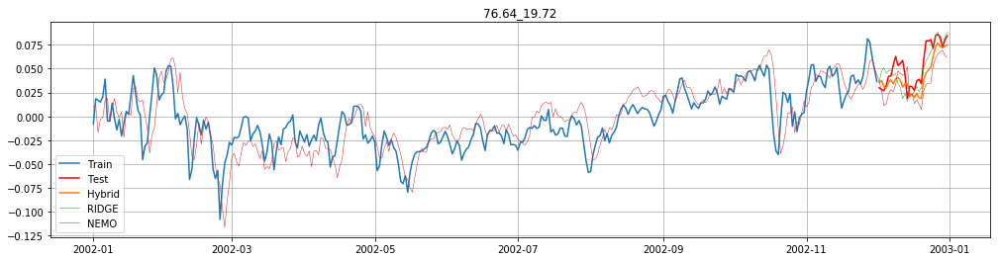

RIDGE:
MSE: 0.0002000916108236052
MAE: 0.010890725225437691
MAPE: 24.053

HYB:
MSE: 0.0002519802133180216
MAE: 0.013385960771084919
MAPE: 27.255


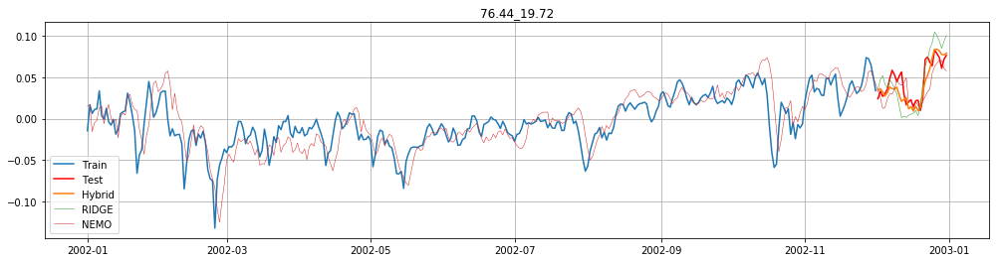

RIDGE:
MSE: 0.00042141573436213275
MAE: 0.017628422273759117
MAPE: 47.147

HYB:
MSE: 0.00017282560671180795
MAE: 0.010384764674710643
MAPE: 26.317


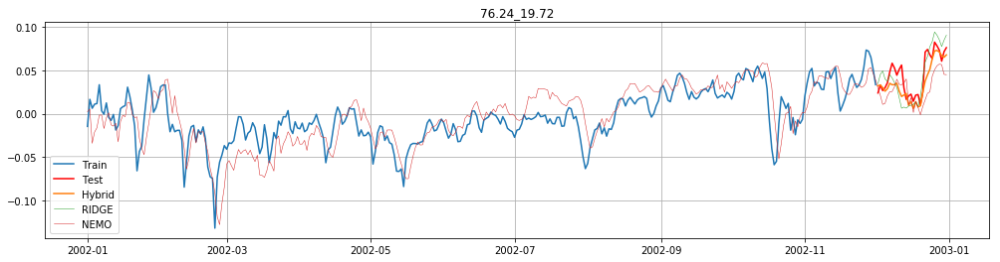

RIDGE:
MSE: 0.0002846875430389001
MAE: 0.014300911526233116
MAPE: 39.058

HYB:
MSE: 0.0002180044207446834
MAE: 0.011178388486100437
MAPE: 27.1


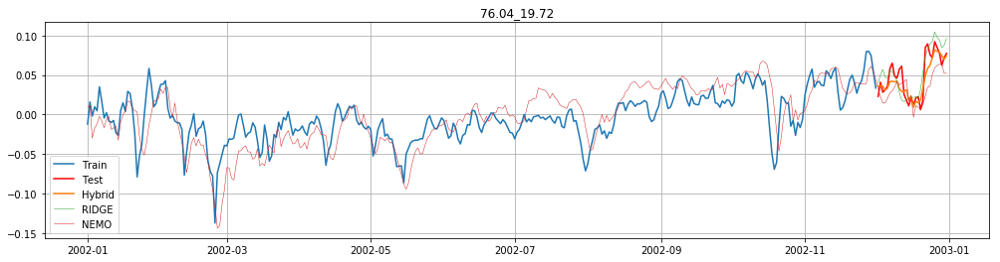

RIDGE:
MSE: 0.0003015336306879885
MAE: 0.013839198369697096
MAPE: 47.571

HYB:
MSE: 0.00020807851167379692
MAE: 0.010642021233017206
MAPE: 31.47


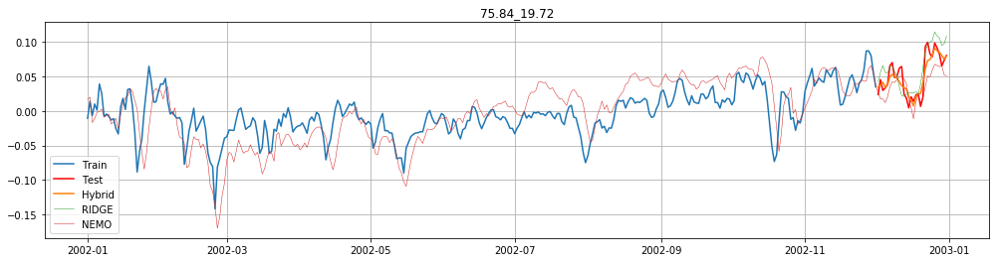

RIDGE:
MSE: 0.00043459862462652044
MAE: 0.016975300029768135
MAPE: 68.913

HYB:
MSE: 0.00018710407101895596
MAE: 0.010377278475734407
MAPE: 43.269


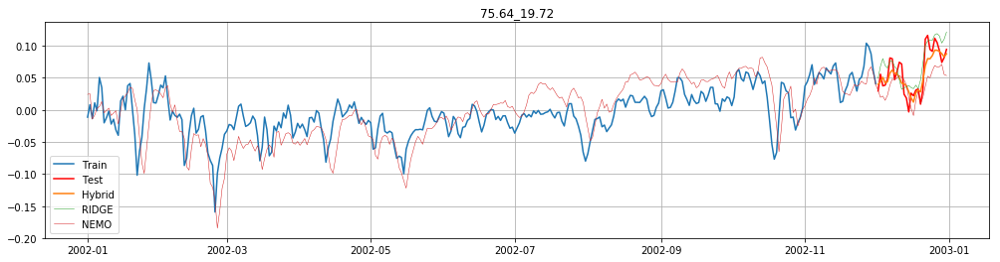

RIDGE:
MSE: 0.0005218382428798057
MAE: 0.019148640145447822
MAPE: 6.7

HYB:
MSE: 0.00030928170226214005
MAE: 0.014232114841684084
MAPE: -1.197


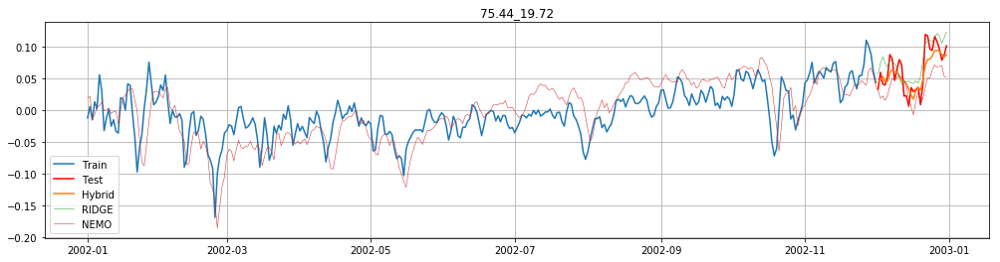

RIDGE:
MSE: 0.0005281263406646666
MAE: 0.019704242846418685
MAPE: 74.573

HYB:
MSE: 0.00035351219219323534
MAE: 0.015441334412192899
MAPE: 47.888


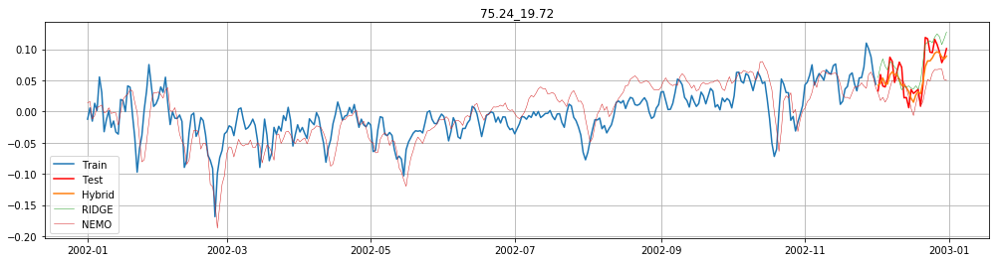

RIDGE:
MSE: 0.0005237728960693415
MAE: 0.019148339815779045
MAPE: 67.066

HYB:
MSE: 0.00034394767272868276
MAE: 0.01533727359388359
MAPE: 46.544


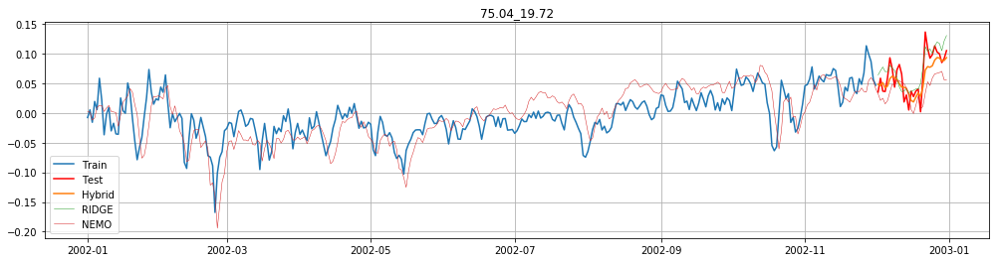

RIDGE:
MSE: 0.00048757946958897423
MAE: 0.018072291464221683
MAPE: 130.501

HYB:
MSE: 0.0004521443145599611
MAE: 0.017571578724530208
MAPE: 89.728


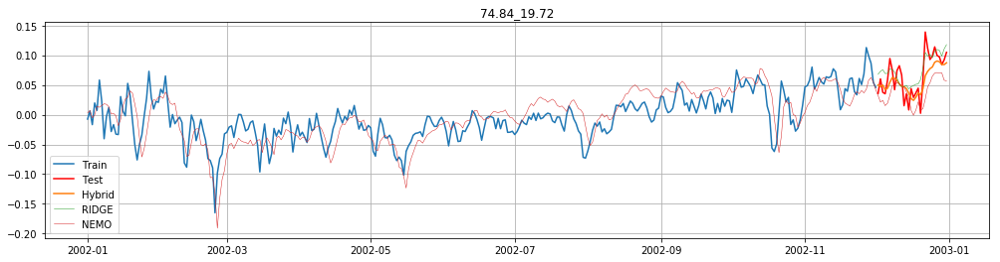

RIDGE:
MSE: 0.0005269443477929573
MAE: 0.01914812887949791
MAPE: 129.823

HYB:
MSE: 0.0005564403580842787
MAE: 0.018867433681041566
MAPE: 85.134


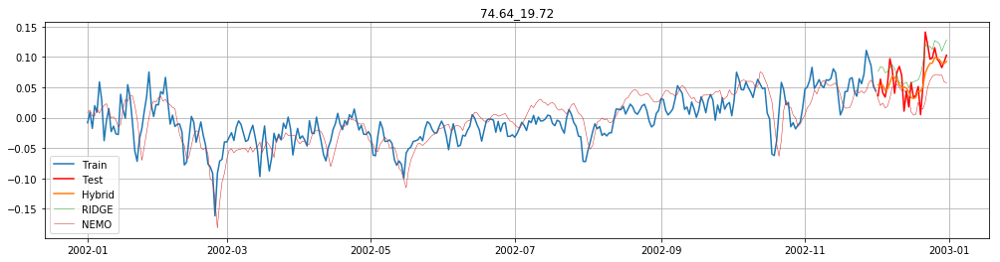

RIDGE:
MSE: 0.0008004949474441458
MAE: 0.02456052269911866
MAPE: 99.201

HYB:
MSE: 0.0005210778413548834
MAE: 0.017012681072342863
MAPE: 61.288


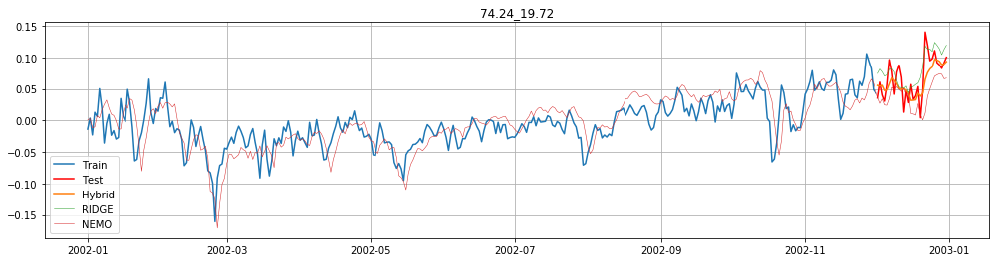

RIDGE:
MSE: 0.0006720833592213357
MAE: 0.022313143202455855
MAPE: 96.957

HYB:
MSE: 0.0005681459178069406
MAE: 0.01768780948118637
MAPE: 60.403


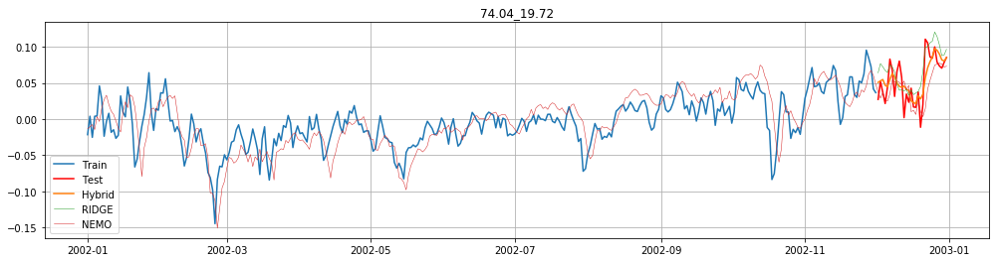

RIDGE:
MSE: 0.0006928065827082271
MAE: 0.022108411304747787
MAPE: 96.58

HYB:
MSE: 0.00046191571367662477
MAE: 0.016358173012179893
MAPE: 93.387


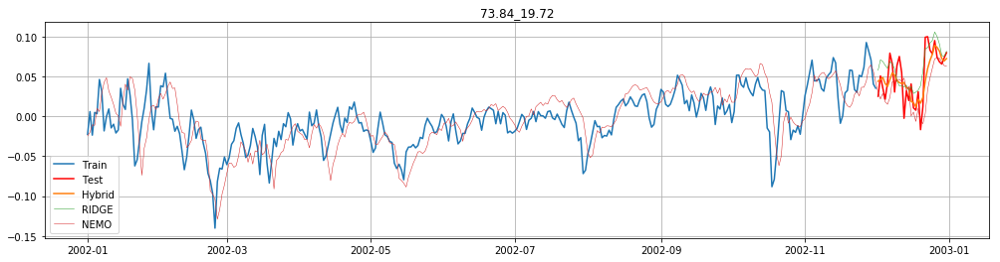

RIDGE:
MSE: 0.0005833189169156675
MAE: 0.019722967709876468
MAPE: -4.329

HYB:
MSE: 0.00045551543541290043
MAE: 0.016707096679328577
MAPE: -34.081


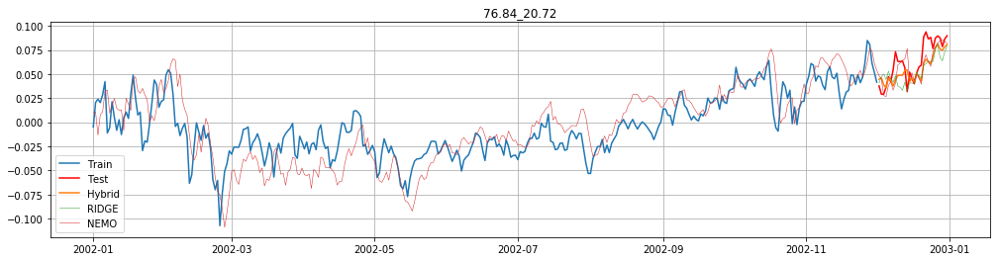

RIDGE:
MSE: 0.0003006134551679957
MAE: 0.01460377818970909
MAPE: 23.571

HYB:
MSE: 0.00022037918291113119
MAE: 0.011954850533668548
MAPE: 19.902


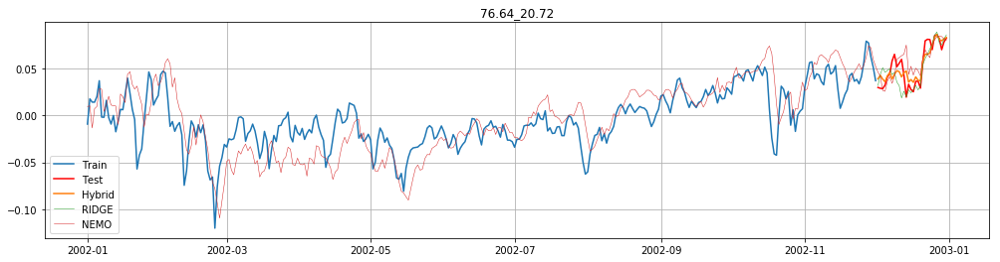

RIDGE:
MSE: 0.00017805468132800142
MAE: 0.009886663732101487
MAPE: 20.959

HYB:
MSE: 0.00011842697170887646
MAE: 0.008228276710773398
MAPE: 20.801


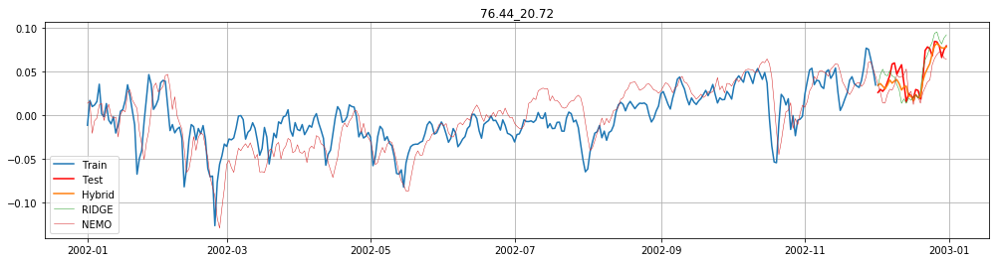

RIDGE:
MSE: 0.00021457281376062465
MAE: 0.012023966572731424
MAPE: 28.012

HYB:
MSE: 0.00014964500807846418
MAE: 0.008777123431371815
MAPE: 20.551


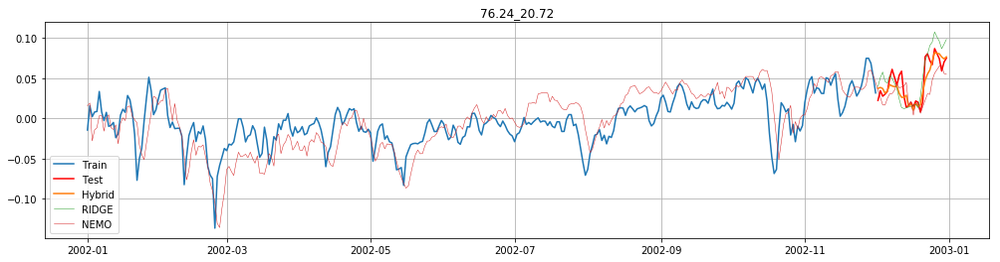

RIDGE:
MSE: 0.0003640781083706958
MAE: 0.015491561648055176
MAPE: 43.284

HYB:
MSE: 0.00016994582756990005
MAE: 0.009490032396714691
MAPE: 26.455


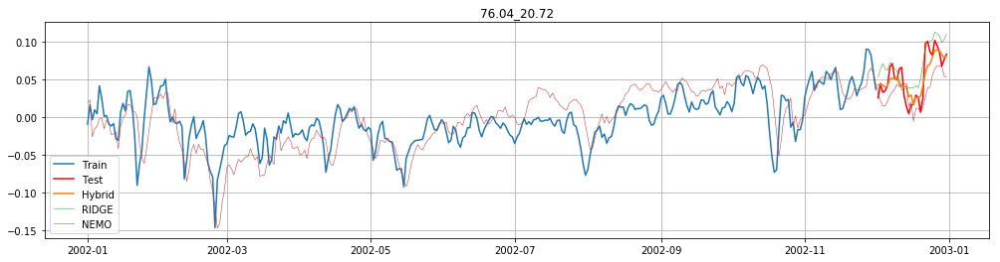

RIDGE:
MSE: 0.0005433557648889888
MAE: 0.020407349083598984
MAPE: 97.192

HYB:
MSE: 0.0002560842548951646
MAE: 0.012160615182068688
MAPE: 53.419


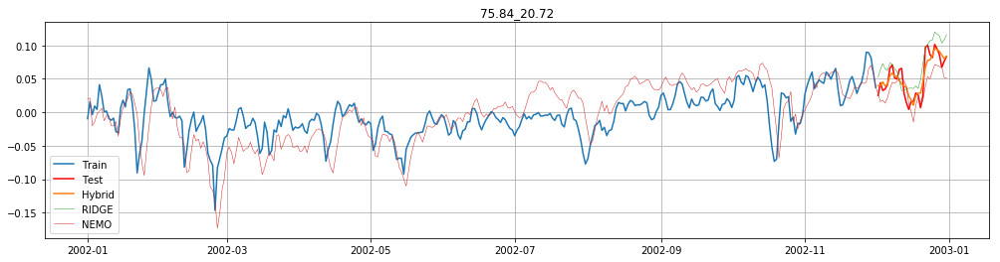

RIDGE:
MSE: 0.0006172279626162036
MAE: 0.0216224473493962
MAPE: 94.262

HYB:
MSE: 0.0001819306132427476
MAE: 0.01058702343169456
MAPE: 49.512


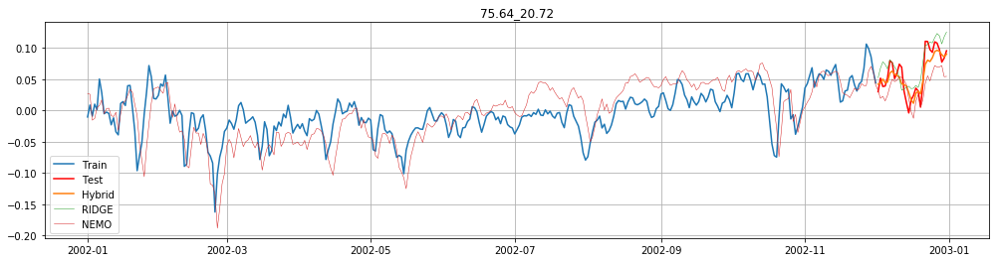

RIDGE:
MSE: 0.0005329707638195566
MAE: 0.019089523550323895
MAPE: 30.094

HYB:
MSE: 0.0002666669374569693
MAE: 0.01319906111287795
MAPE: 11.162


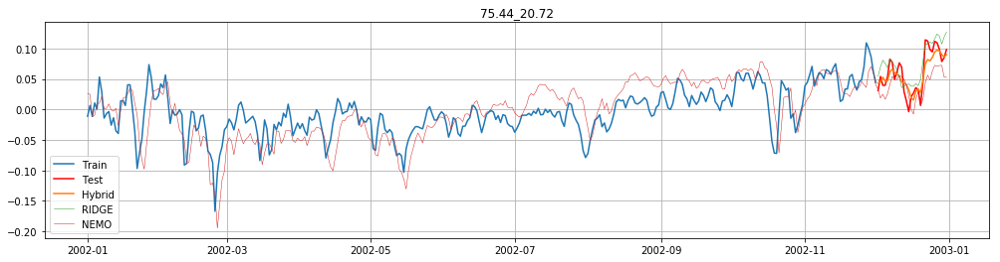

RIDGE:
MSE: 0.0005505566552181692
MAE: 0.01953521478819987
MAPE: 18.555

HYB:
MSE: 0.00029099633129355055
MAE: 0.013805920516727603
MAPE: 3.03


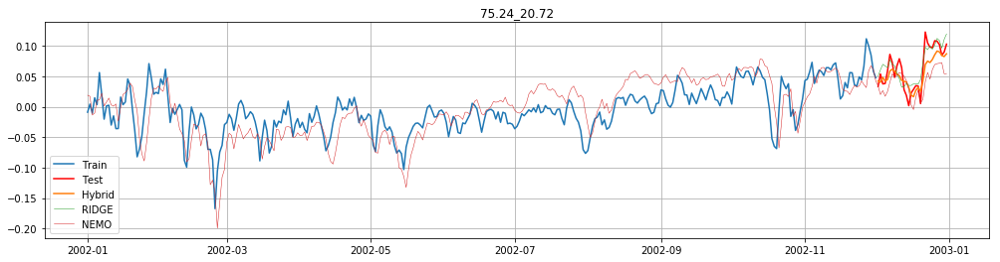

RIDGE:
MSE: 0.000339713915266887
MAE: 0.01483314859782677
MAPE: 109.96

HYB:
MSE: 0.00038380255044014055
MAE: 0.016484291627087224
MAPE: 91.406


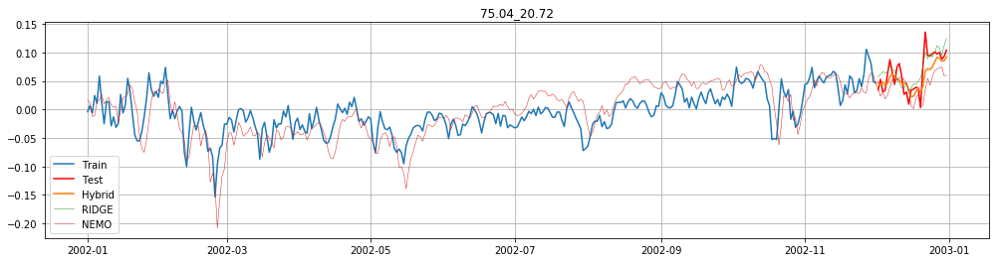

RIDGE:
MSE: 0.0003919812384802784
MAE: 0.0157312881561929
MAPE: 88.327

HYB:
MSE: 0.0004585277238442173
MAE: 0.017310369611211154
MAPE: 61.94


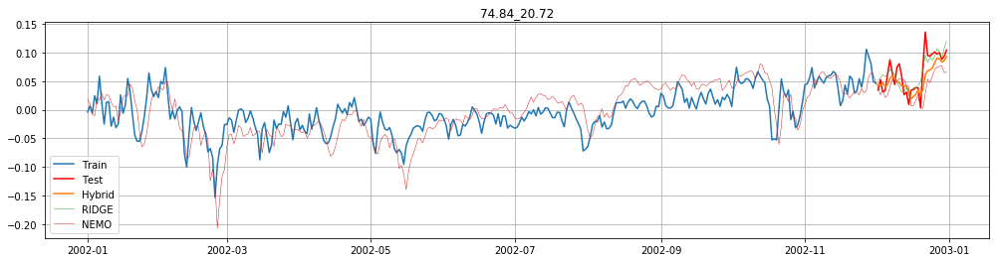

RIDGE:
MSE: 0.0003491907814285543
MAE: 0.013782169571022644
MAPE: 73.867

HYB:
MSE: 0.000528476120250913
MAE: 0.01843001238268742
MAPE: 58.298


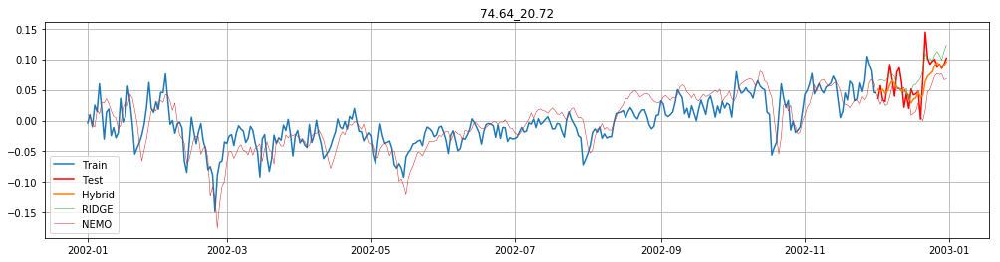

RIDGE:
MSE: 0.000530575569656804
MAE: 0.01892359587395515
MAPE: 130.471

HYB:
MSE: 0.000549423089707174
MAE: 0.017392270298424377
MAPE: 80.512


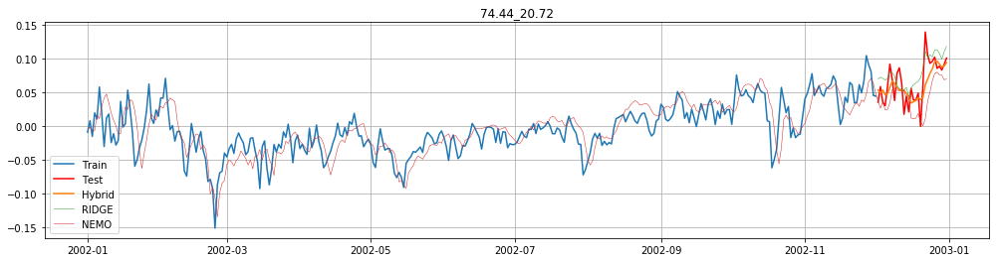

RIDGE:
MSE: 0.0006478255303587777
MAE: 0.021407226253762627
MAPE: -492.695

HYB:
MSE: 0.0005562658662413327
MAE: 0.01736922896888064
MAPE: -264.062


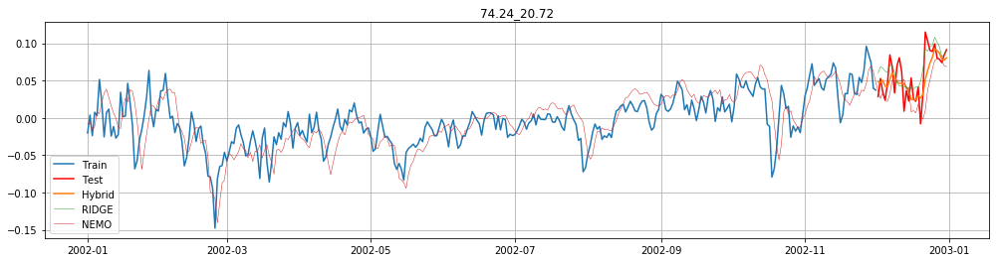

RIDGE:
MSE: 0.0005034164517159825
MAE: 0.018163687767359285
MAPE: 24.14

HYB:
MSE: 0.0004911129600346581
MAE: 0.016955672426419408
MAPE: 25.196


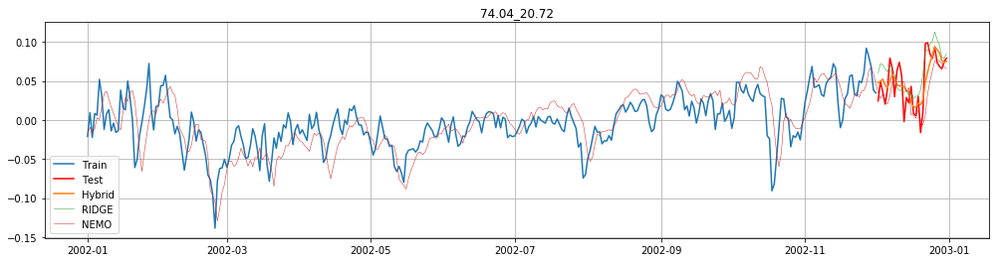

RIDGE:
MSE: 0.0006517950381340935
MAE: 0.021332818653173758
MAPE: 1.837

HYB:
MSE: 0.000451750890661157
MAE: 0.016891020915967347
MAPE: -36.156


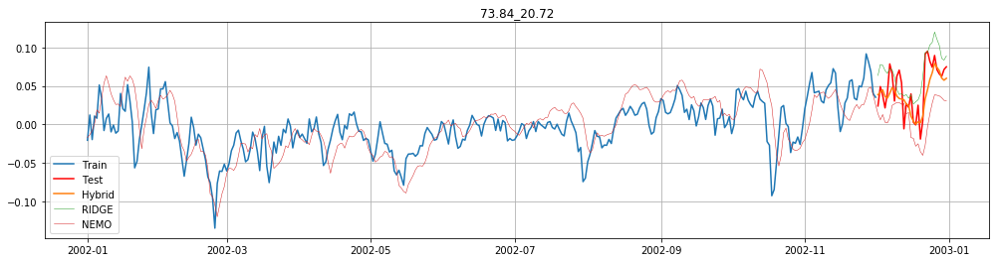

RIDGE:
MSE: 0.0008607807924226627
MAE: 0.02472882094125848
MAPE: -148.226

HYB:
MSE: 0.00050782624277508
MAE: 0.017047953752001296
MAPE: -1.988


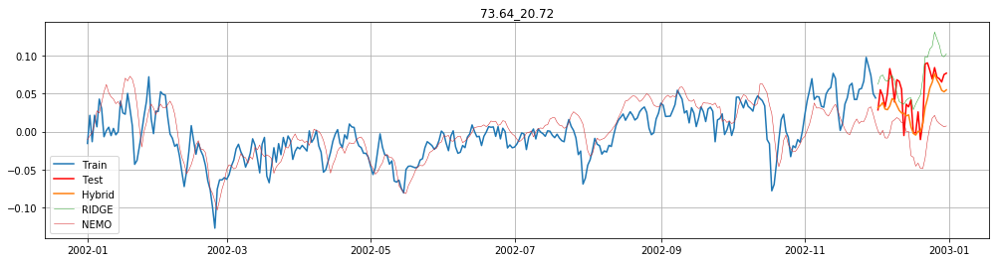

RIDGE:
MSE: 0.0009703274204121449
MAE: 0.027101900202820637
MAPE: -126.659

HYB:
MSE: 0.0006022884927335177
MAE: 0.019139869306581757
MAPE: 1.332


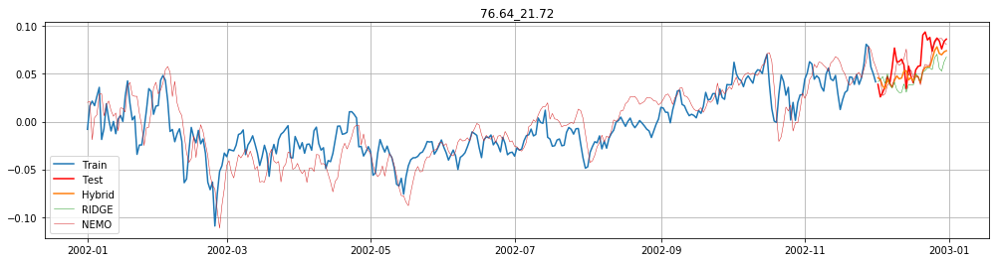

RIDGE:
MSE: 0.0004957306814521508
MAE: 0.018957885100680198
MAPE: 29.13

HYB:
MSE: 0.00030913264495180474
MAE: 0.014153070150700359
MAPE: 22.539


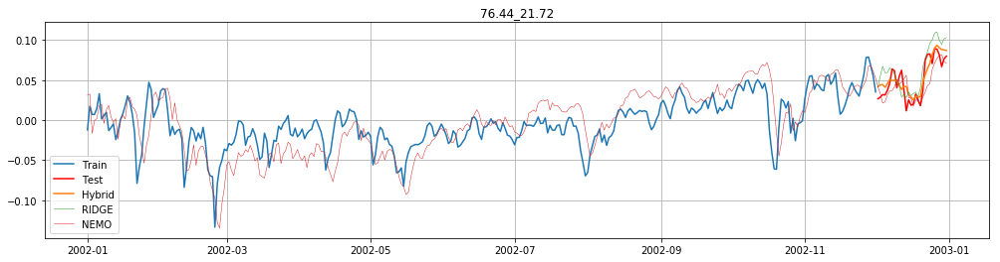

RIDGE:
MSE: 0.00038137285111456836
MAE: 0.016861848153290497
MAPE: 44.996

HYB:
MSE: 0.00016490562015516054
MAE: 0.011117210209385303
MAPE: 32.645


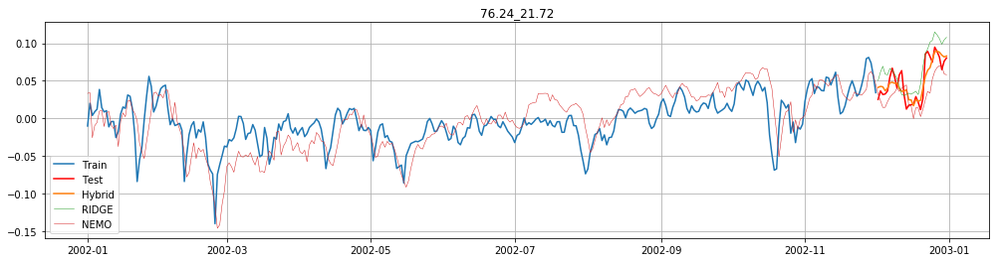

RIDGE:
MSE: 0.0005001237478000834
MAE: 0.019407095197221516
MAPE: 58.982

HYB:
MSE: 0.0001825923255376819
MAE: 0.010646592094998273
MAPE: 30.53


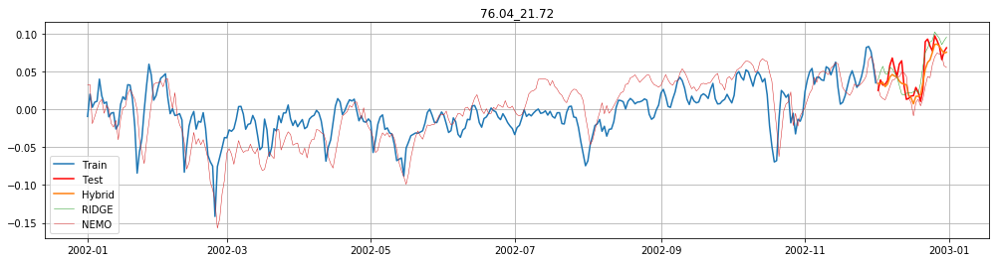

RIDGE:
MSE: 0.0002532123130304394
MAE: 0.012705441306298776
MAPE: 36.364

HYB:
MSE: 0.000206244726652303
MAE: 0.010826279379191556
MAPE: 27.622


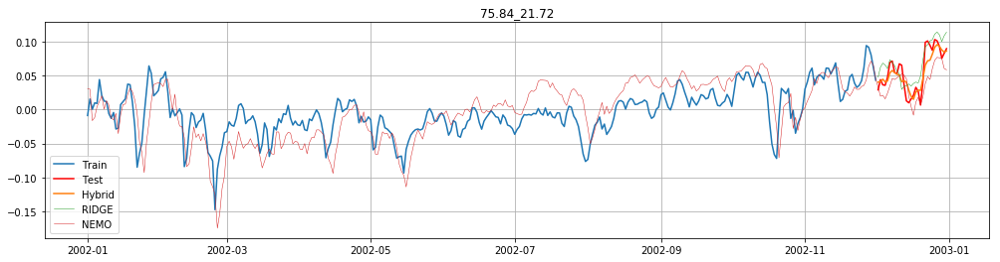

RIDGE:
MSE: 0.0004044775333208603
MAE: 0.017095065368739917
MAPE: 69.39

HYB:
MSE: 0.00020299243869396452
MAE: 0.010859912795946912
MAPE: 39.687


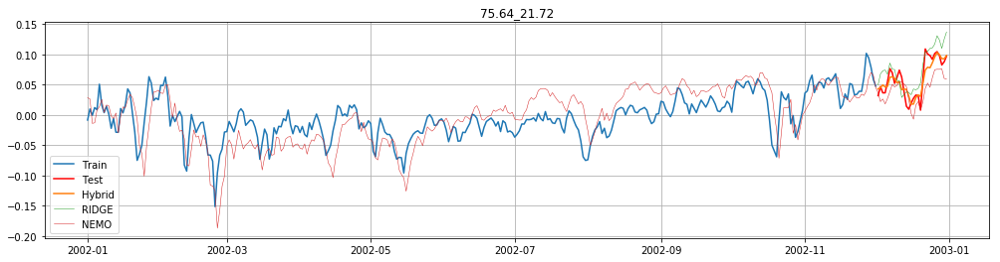

RIDGE:
MSE: 0.0005425137593637704
MAE: 0.02021913513040964
MAPE: 65.597

HYB:
MSE: 0.0001973102374636699
MAE: 0.011016821074674499
MAPE: 37.8


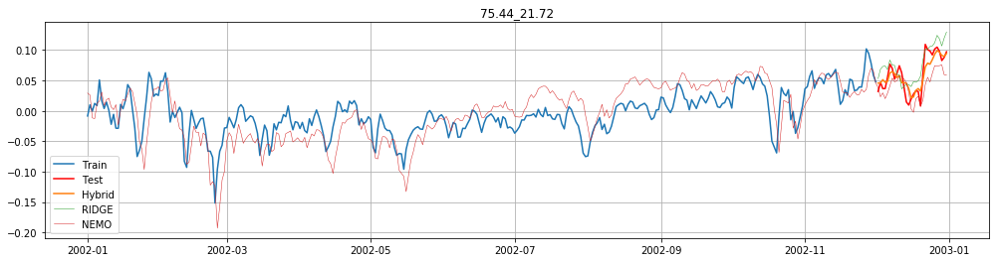

RIDGE:
MSE: 0.0005170806981189672
MAE: 0.019572685095483967
MAPE: 71.509

HYB:
MSE: 0.00021790262165628346
MAE: 0.01149151867144583
MAPE: 41.264


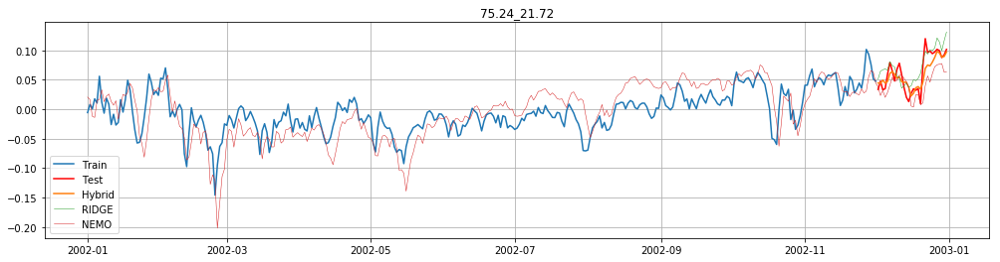

RIDGE:
MSE: 0.0004144536854542071
MAE: 0.017075231205556717
MAPE: 54.411

HYB:
MSE: 0.00029451226392012575
MAE: 0.013372739313003222
MAPE: 35.823


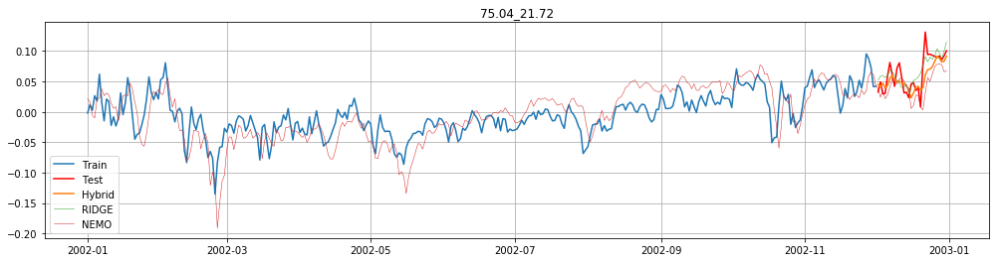

RIDGE:
MSE: 0.0003616576749654427
MAE: 0.014400717105660685
MAPE: 47.583

HYB:
MSE: 0.00045012682344161055
MAE: 0.016235091723807972
MAPE: 36.445


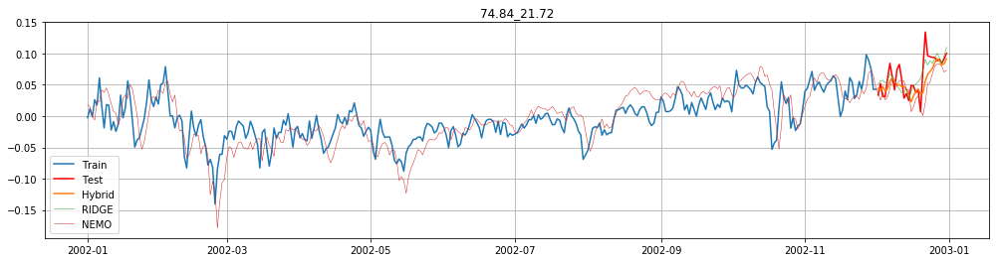

RIDGE:
MSE: 0.0003602814382828593
MAE: 0.01380533195673472
MAPE: 48.128

HYB:
MSE: 0.0005155505386700278
MAE: 0.016858834099330842
MAPE: 39.063


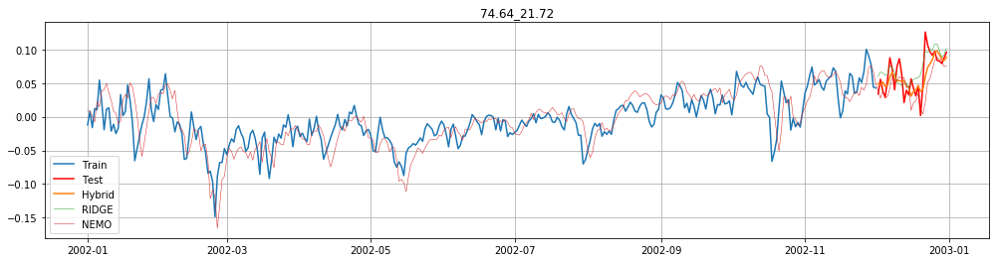

RIDGE:
MSE: 0.0004786540639714222
MAE: 0.017865922993251182
MAPE: 145.561

HYB:
MSE: 0.0004463663635383594
MAE: 0.016146149441675122
MAPE: 93.154


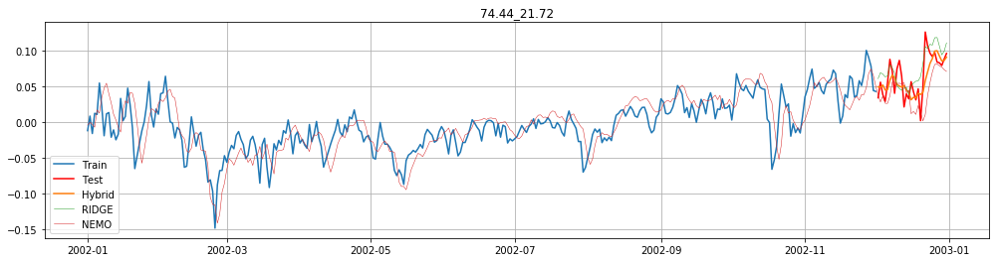

RIDGE:
MSE: 0.0005534371631705587
MAE: 0.019962378096667142
MAPE: 149.387

HYB:
MSE: 0.0004650573091928812
MAE: 0.01616249385107318
MAPE: 93.899


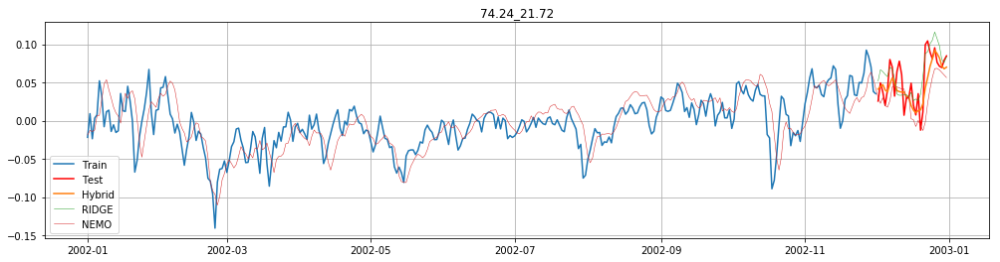

RIDGE:
MSE: 0.0005611212129015905
MAE: 0.019683996388476236
MAPE: 55.291

HYB:
MSE: 0.0004898354258350562
MAE: 0.017160630717380054
MAPE: 38.819


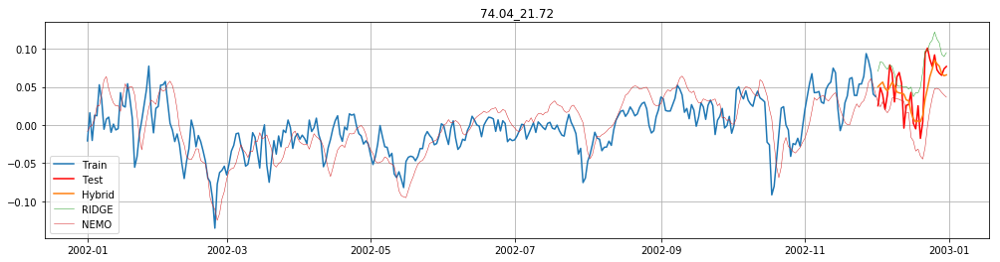

RIDGE:
MSE: 0.0011573620328104671
MAE: 0.02867238246334898
MAPE: 60.106

HYB:
MSE: 0.0005157713741849555
MAE: 0.017770164712114445
MAPE: -1.926


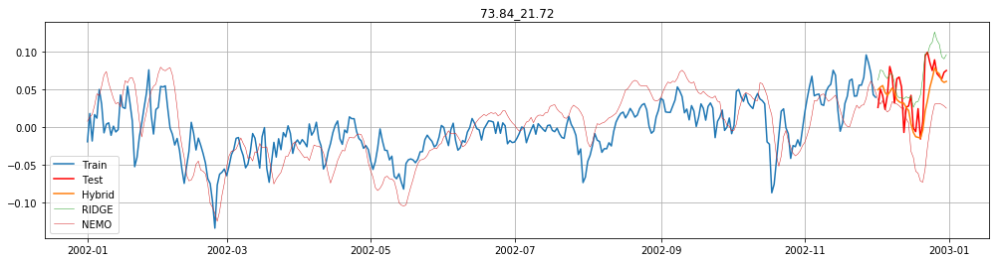

RIDGE:
MSE: 0.0009294760616337521
MAE: 0.026085769623353676
MAPE: -116.745

HYB:
MSE: 0.0006958974541749725
MAE: 0.019376933727091983
MAPE: -12.421


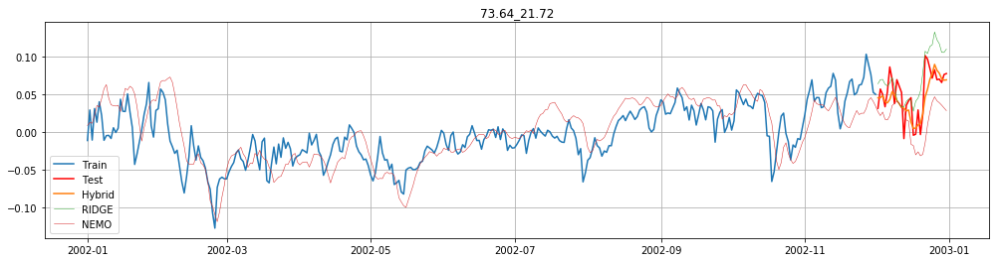

RIDGE:
MSE: 0.0010154688805832333
MAE: 0.027139048374870498
MAPE: -106.465

HYB:
MSE: 0.00044904316756173395
MAE: 0.016639436360414903
MAPE: -22.447


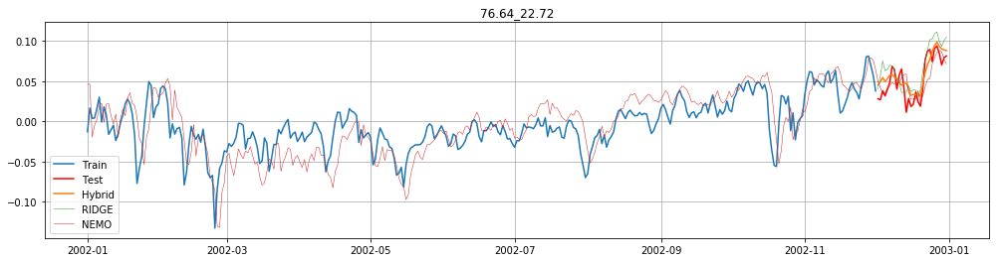

RIDGE:
MSE: 0.00038232391236873385
MAE: 0.016882064804038914
MAPE: 47.502

HYB:
MSE: 0.00020326262719030697
MAE: 0.012664830005497122
MAPE: 39.404


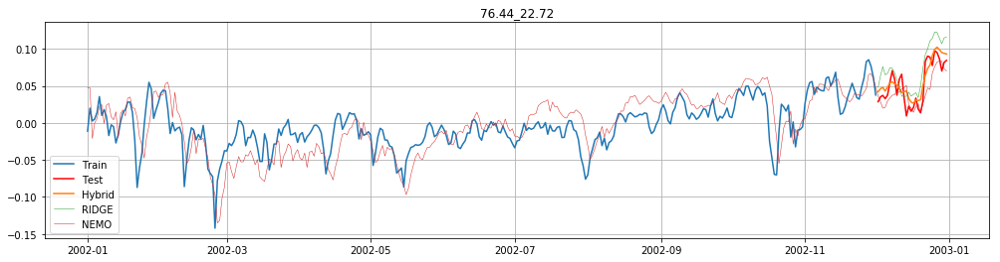

RIDGE:
MSE: 0.000645437962989121
MAE: 0.02284071736273848
MAPE: 66.893

HYB:
MSE: 0.00020715509431170446
MAE: 0.01259178052789917
MAPE: 41.694


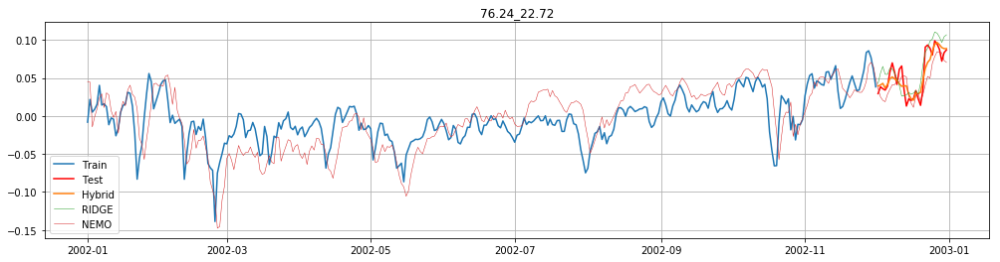

RIDGE:
MSE: 0.00030739380906132937
MAE: 0.014724313378632357
MAPE: 38.547

HYB:
MSE: 0.00016788860883331754
MAE: 0.010065661568882204
MAPE: 26.762


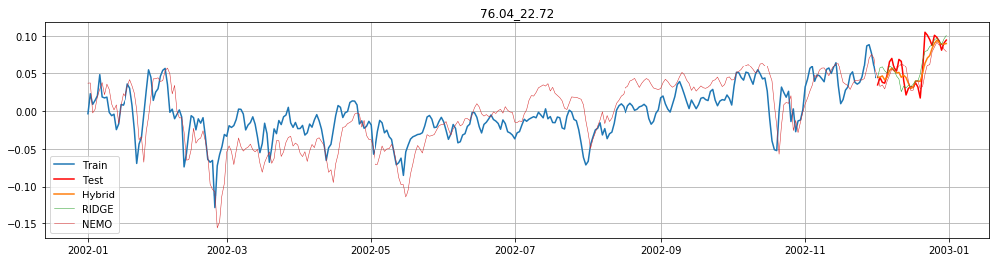

RIDGE:
MSE: 0.00021413027326197746
MAE: 0.01079065283913666
MAPE: 24.17

HYB:
MSE: 0.00019734793097641757
MAE: 0.010110029184691612
MAPE: 21.136


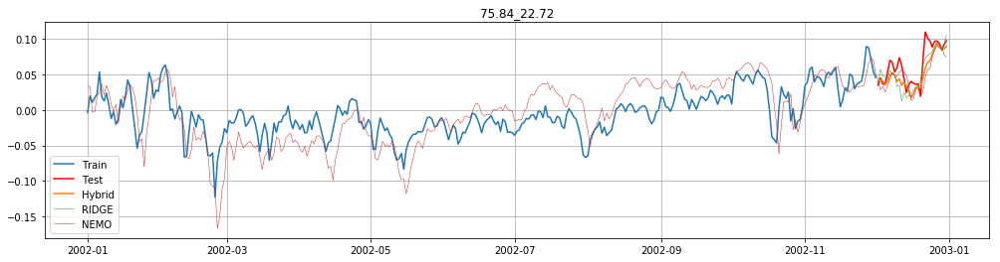

RIDGE:
MSE: 0.0003302118463121046
MAE: 0.013605690961390063
MAPE: 25.857

HYB:
MSE: 0.00031981861106478393
MAE: 0.013490103529819015
MAPE: 22.647


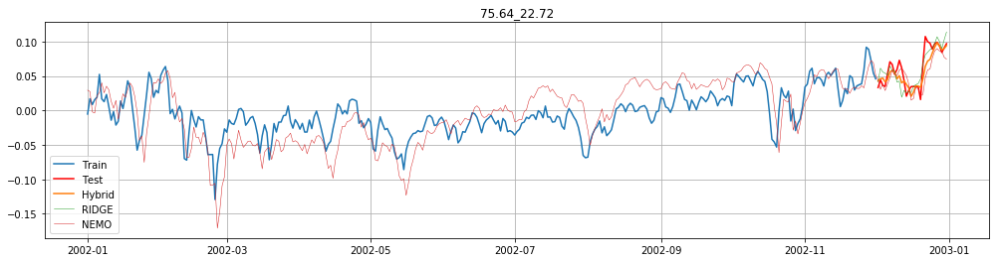

RIDGE:
MSE: 0.00023875052399518806
MAE: 0.011596847436054056
MAPE: 25.094

HYB:
MSE: 0.00021518706998266448
MAE: 0.010683433351602352
MAPE: 21.66


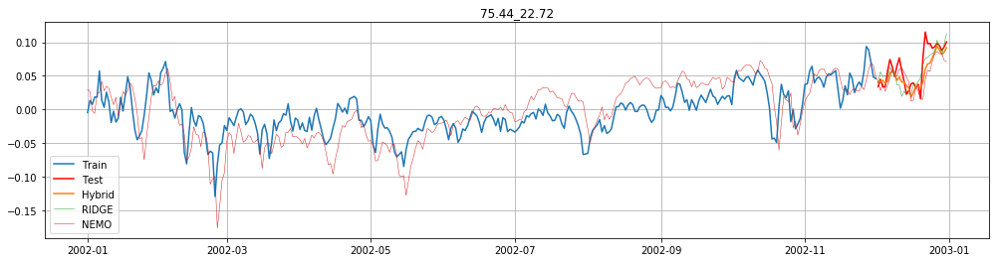

RIDGE:
MSE: 0.0003040970401292183
MAE: 0.013318246472240836
MAPE: 27.222

HYB:
MSE: 0.0003355163237530451
MAE: 0.013878780863064478
MAPE: 24.641


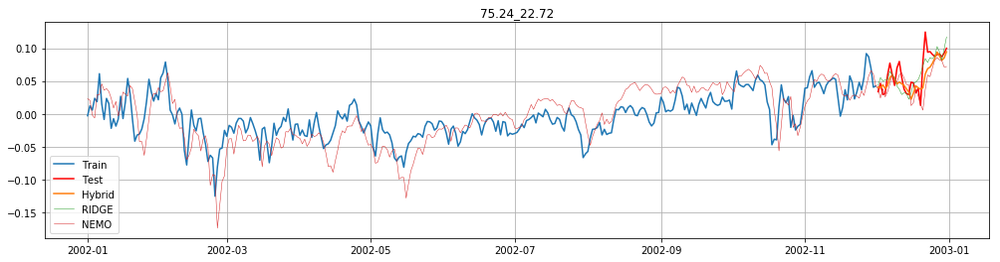

RIDGE:
MSE: 0.00034490603182449515
MAE: 0.014001469254077836
MAPE: 34.767

HYB:
MSE: 0.00039659617421176885
MAE: 0.014660994831139041
MAPE: 28.351


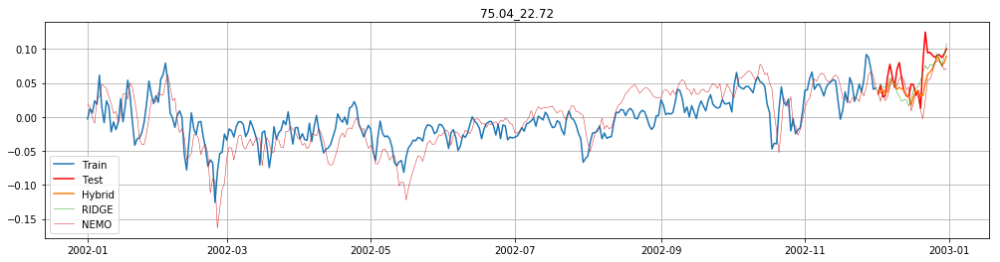

RIDGE:
MSE: 0.000417809851588817
MAE: 0.01581031789018049
MAPE: 34.465

HYB:
MSE: 0.0005446640463581037
MAE: 0.01680056118825325
MAPE: 27.822


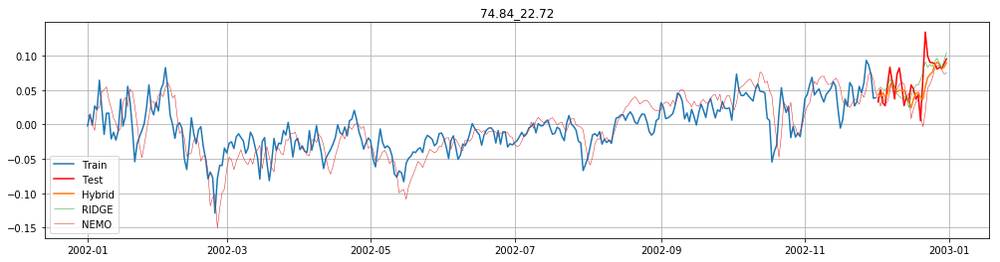

RIDGE:
MSE: 0.0004018909740745428
MAE: 0.01467245134203865
MAPE: 59.955

HYB:
MSE: 0.0005237355232857653
MAE: 0.01648950697828092
MAPE: 45.756


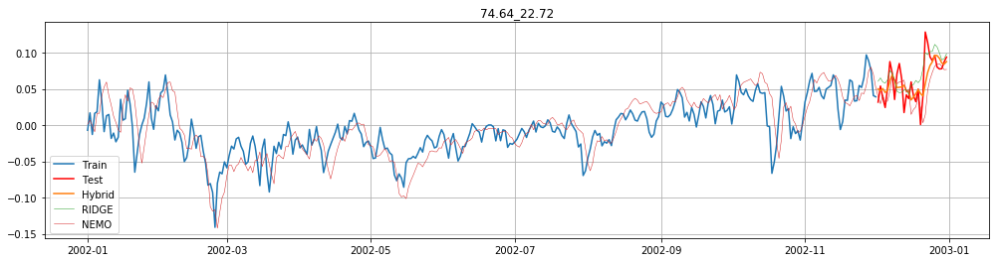

RIDGE:
MSE: 0.0005539607031140995
MAE: 0.019437321607768773
MAPE: 316.532

HYB:
MSE: 0.000522059304716009
MAE: 0.016287454383327807
MAPE: 220.87


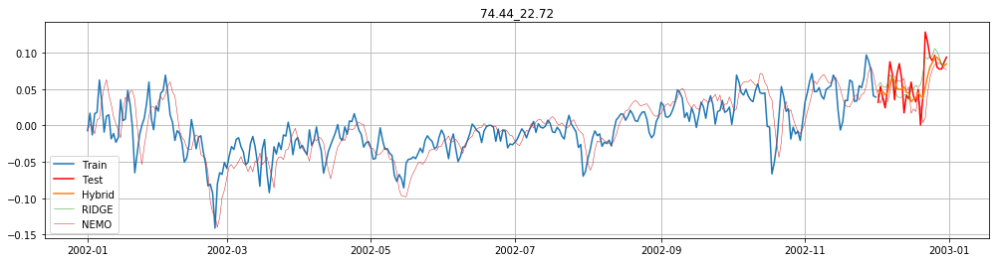

RIDGE:
MSE: 0.0004733691053914805
MAE: 0.016843845435374833
MAPE: 280.7

HYB:
MSE: 0.0005534215999898633
MAE: 0.01681471721889118
MAPE: 209.649


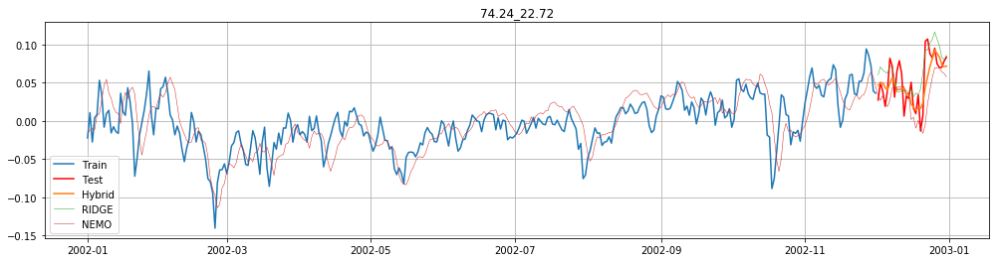

RIDGE:
MSE: 0.000681496950170288
MAE: 0.02160127980201066
MAPE: 75.443

HYB:
MSE: 0.0005240303802032875
MAE: 0.017589962887597663
MAPE: 47.493


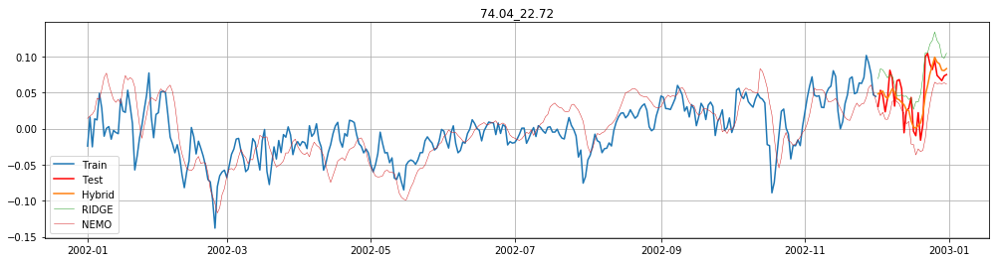

RIDGE:
MSE: 0.001174088320229113
MAE: 0.02931431086317522
MAPE: -6.997

HYB:
MSE: 0.00047496166744627764
MAE: 0.017517490607894693
MAPE: -2.088


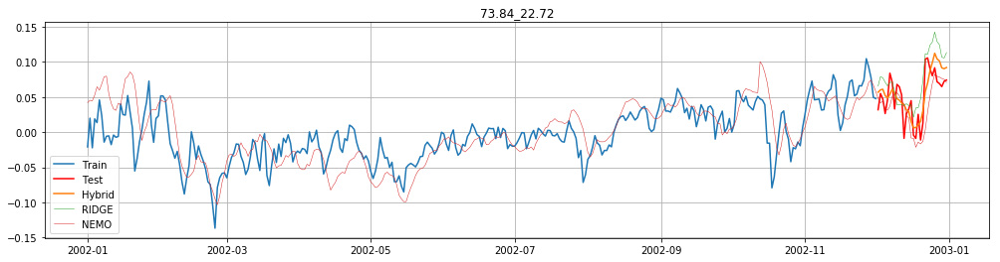

RIDGE:
MSE: 0.00121339769606751
MAE: 0.02996238962499371
MAPE: -13.906

HYB:
MSE: 0.0005440842062289047
MAE: 0.020262814962731055
MAPE: -5.492


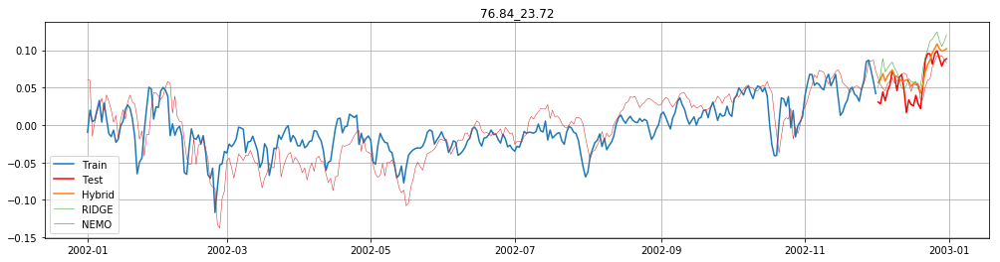

RIDGE:
MSE: 0.0006693033407155308
MAE: 0.023442568817570755
MAPE: 58.078

HYB:
MSE: 0.00038011971840313586
MAE: 0.016778732362490858
MAPE: 46.976


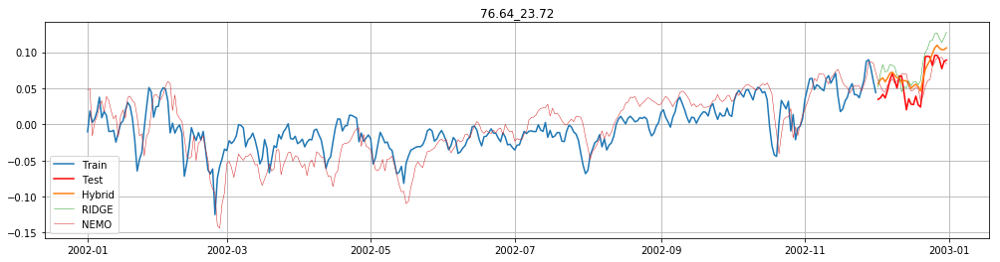

RIDGE:
MSE: 0.0007373790229123844
MAE: 0.025222373425104857
MAPE: 55.703

HYB:
MSE: 0.0003435478875984801
MAE: 0.016698008294278414
MAPE: 41.449


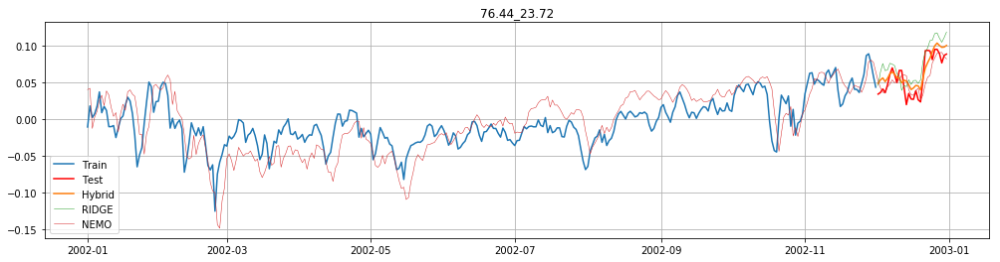

RIDGE:
MSE: 0.0004539950836118482
MAE: 0.019337572636750792
MAPE: 43.465

HYB:
MSE: 0.00019569561855618808
MAE: 0.012309047871376383
MAPE: 29.249


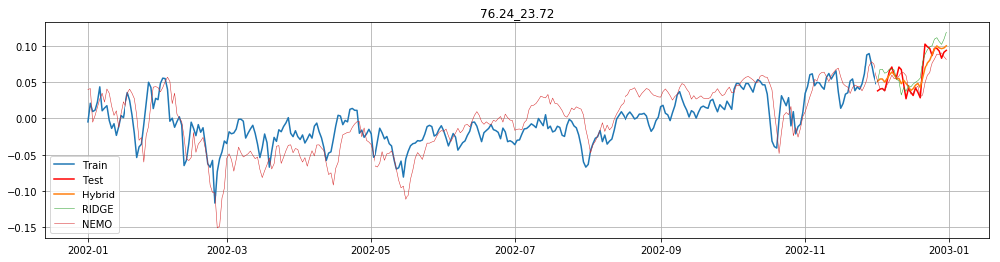

RIDGE:
MSE: 0.00025936743178791774
MAE: 0.013667593929473507
MAPE: 26.738

HYB:
MSE: 0.00015702589894424736
MAE: 0.009946493344434116
MAPE: 18.993


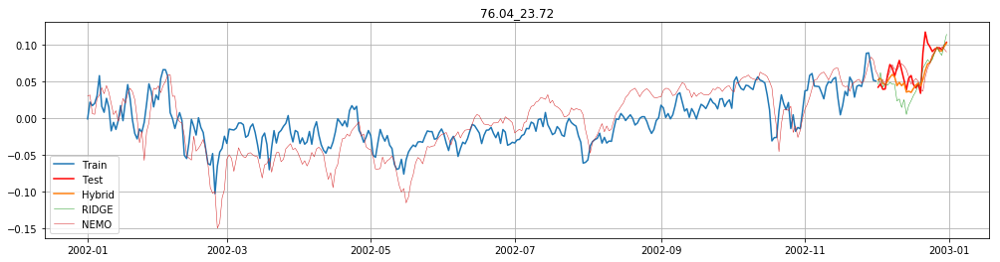

RIDGE:
MSE: 0.0005835413635349368
MAE: 0.018860348956731172
MAPE: 29.763

HYB:
MSE: 0.00030284522748587795
MAE: 0.012316494637008872
MAPE: 17.738


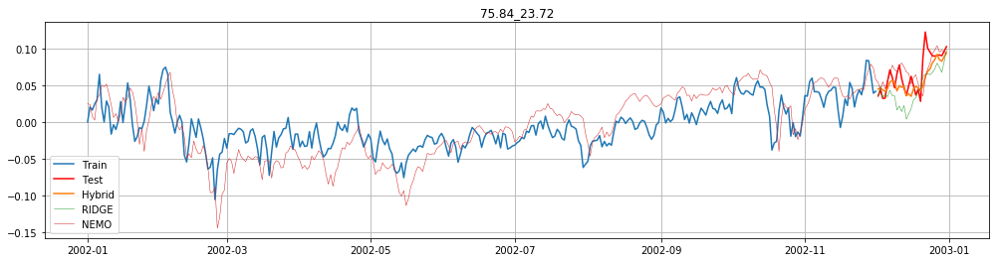

RIDGE:
MSE: 0.0007797834845793943
MAE: 0.02293183382768916
MAPE: 35.395

HYB:
MSE: 0.0003513648801377402
MAE: 0.013569993430720599
MAPE: 20.525


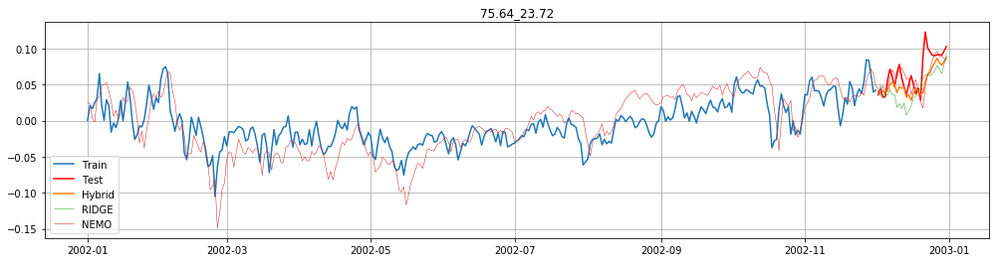

RIDGE:
MSE: 0.0007943940297979485
MAE: 0.02356495863937929
MAPE: 35.479

HYB:
MSE: 0.0004956631082669746
MAE: 0.01641434280969372
MAPE: 22.803


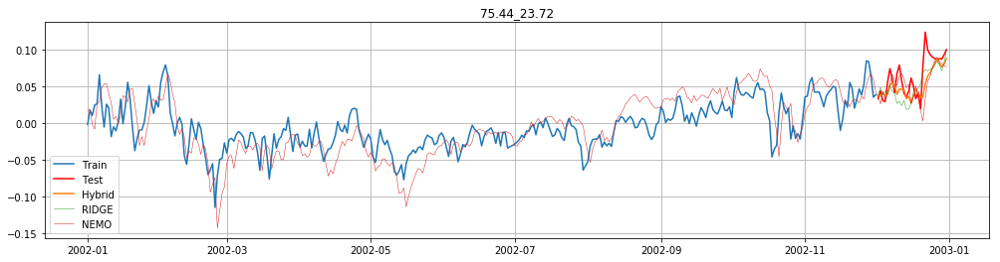

RIDGE:
MSE: 0.0004941739505673565
MAE: 0.01754556401795142
MAPE: 31.66

HYB:
MSE: 0.00048096575626026093
MAE: 0.016160608832846663
MAPE: 25.388


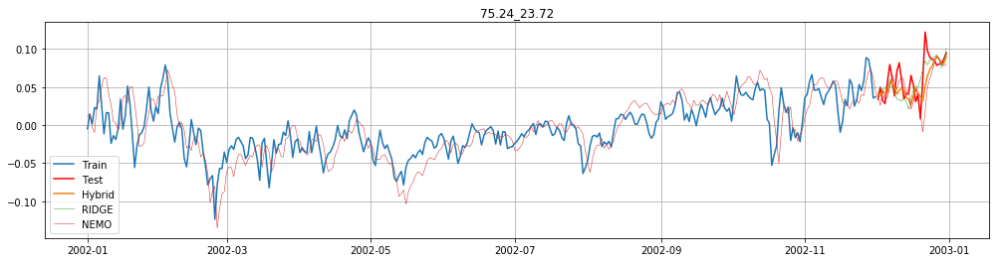

RIDGE:
MSE: 0.0004270216464457303
MAE: 0.01558267896293434
MAPE: 45.483

HYB:
MSE: 0.0004794469677810142
MAE: 0.016362310321946894
MAPE: 36.79


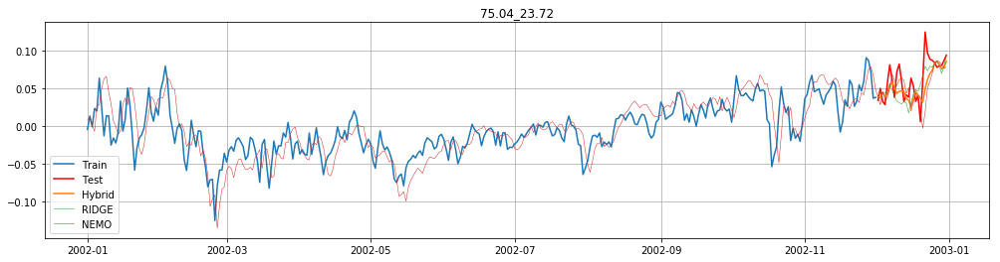

RIDGE:
MSE: 0.0004664392130251926
MAE: 0.015842294523874912
MAPE: 52.39

HYB:
MSE: 0.0005208771591648688
MAE: 0.016902886449213627
MAPE: 42.919


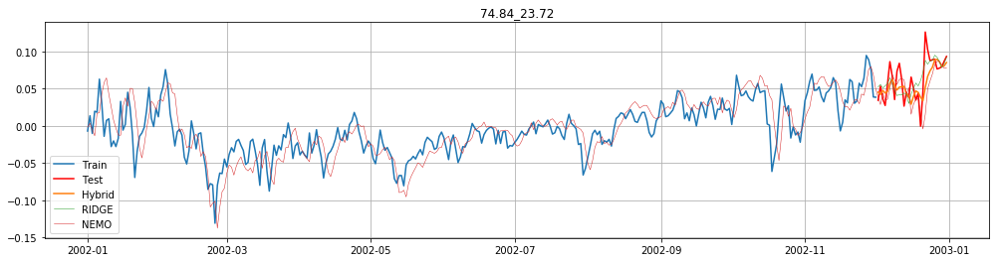

RIDGE:
MSE: 0.00044626859266064787
MAE: 0.015556792026964967
MAPE: -722.556

HYB:
MSE: 0.0005088957664844038
MAE: 0.01655463077953718
MAPE: -450.806


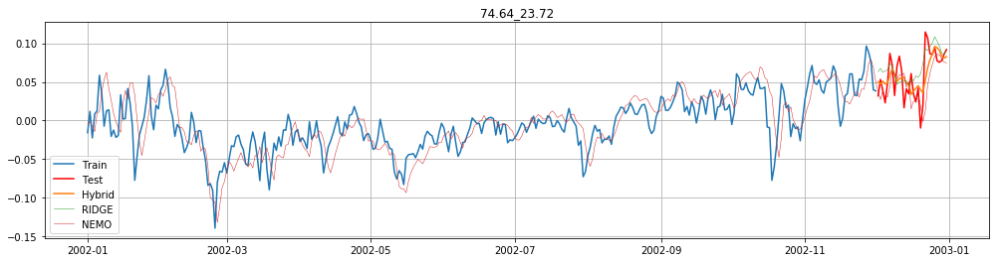

RIDGE:
MSE: 0.0006593630939630328
MAE: 0.020824563381896474
MAPE: 26.433

HYB:
MSE: 0.0005214078661363732
MAE: 0.017268664815536898
MAPE: 19.121


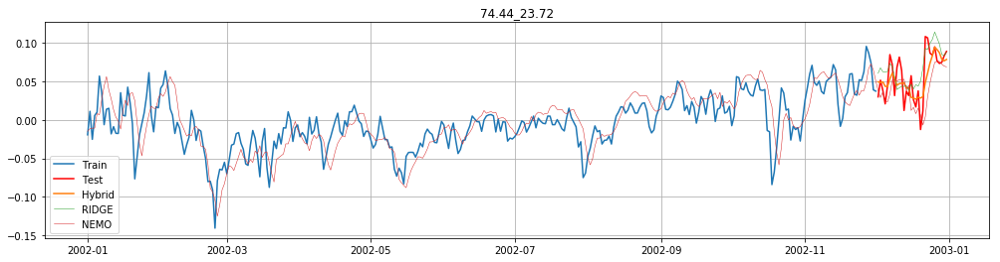

RIDGE:
MSE: 0.000659645392017047
MAE: 0.021059793335669465
MAPE: 46.02

HYB:
MSE: 0.0005157935562735839
MAE: 0.017496435970369158
MAPE: 31.223


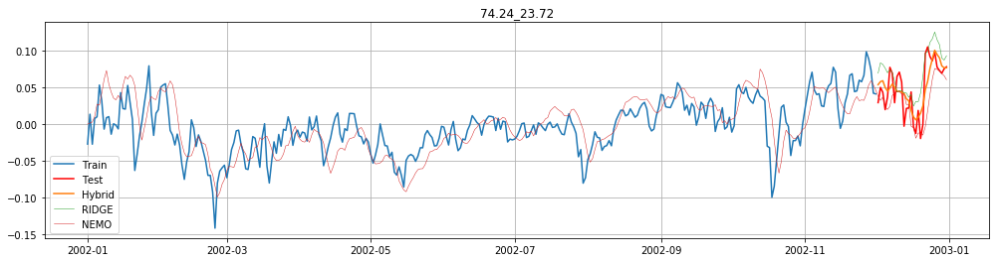

RIDGE:
MSE: 0.000986474205918197
MAE: 0.026370300431364794
MAPE: 9802.65

HYB:
MSE: 0.0005184669053616704
MAE: 0.01894873905062137
MAPE: 3779.302


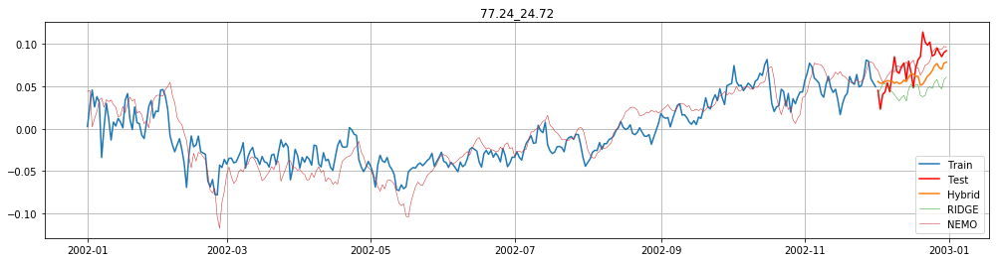

RIDGE:
MSE: 0.001247196023901339
MAE: 0.030609373949055586
MAPE: 39.756

HYB:
MSE: 0.0005386627459634552
MAE: 0.019200765575585484
MAPE: 27.512


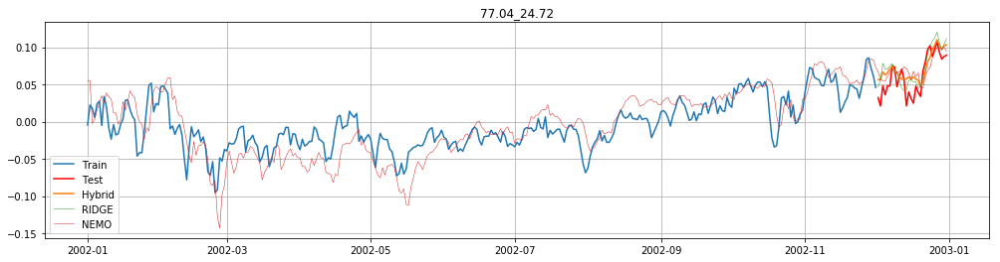

RIDGE:
MSE: 0.0003496831421196713
MAE: 0.016164531396129427
MAPE: 38.041

HYB:
MSE: 0.0003402284589047401
MAE: 0.015756964084281417
MAPE: 40.15


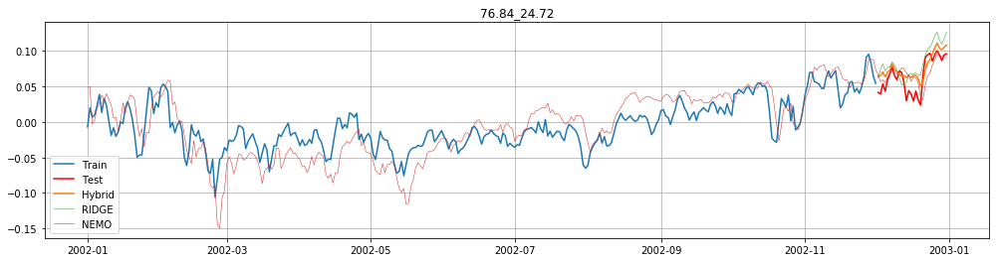

RIDGE:
MSE: 0.0005504538490954045
MAE: 0.02110089160478319
MAPE: 44.155

HYB:
MSE: 0.0003140915567484638
MAE: 0.015528692201759748
MAPE: 34.715


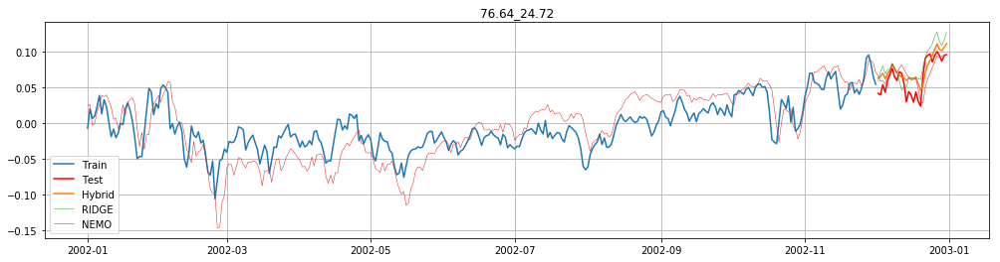

RIDGE:
MSE: 0.00046962842071169203
MAE: 0.019467413962546178
MAPE: 39.825

HYB:
MSE: 0.0002785932673778331
MAE: 0.014975412447406224
MAPE: 32.429


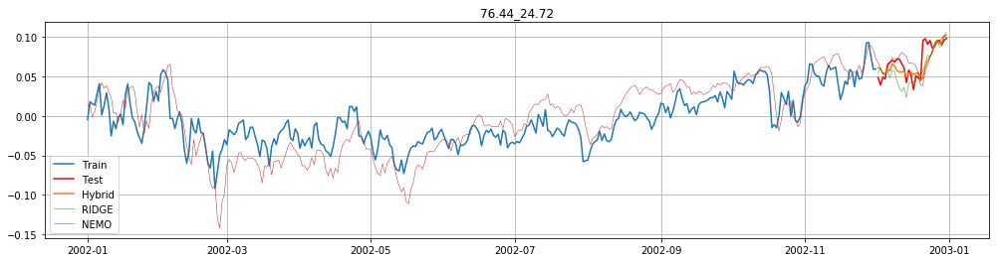

RIDGE:
MSE: 0.0003161818908808583
MAE: 0.01413371520365411
MAPE: 21.446

HYB:
MSE: 0.0002148954550188567
MAE: 0.010374627719118843
MAPE: 15.83


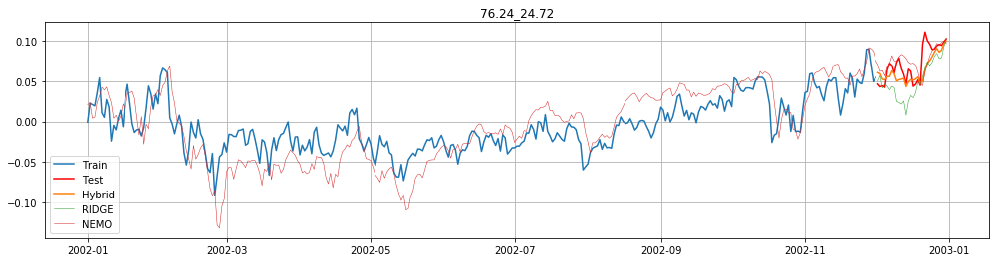

RIDGE:
MSE: 0.0007192780572975882
MAE: 0.021697556124390383
MAPE: 31.01

HYB:
MSE: 0.0002915907410269856
MAE: 0.01253826648614348
MAPE: 17.314


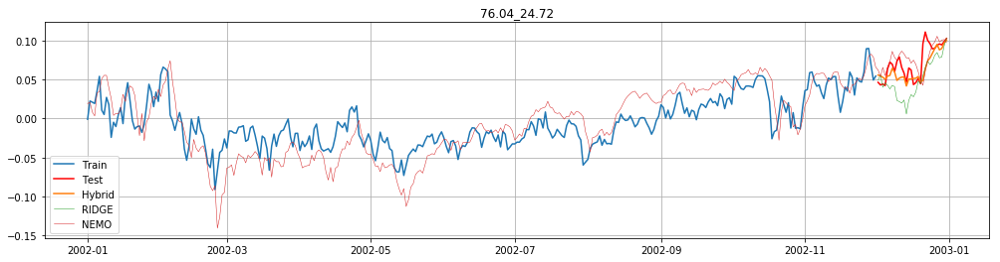

RIDGE:
MSE: 0.0007684516445984319
MAE: 0.022400380142962927
MAPE: 32.071

HYB:
MSE: 0.00028007095422191063
MAE: 0.01169513459744212
MAPE: 16.017


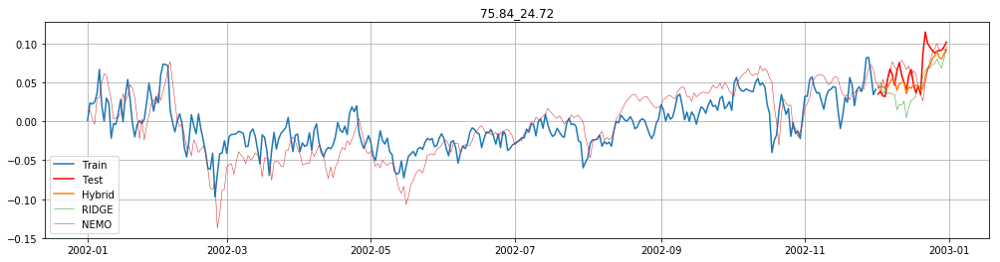

RIDGE:
MSE: 0.0007187680212584895
MAE: 0.022529423438652083
MAPE: 35.1

HYB:
MSE: 0.0003555434677470738
MAE: 0.013664488416871316
MAPE: 20.13


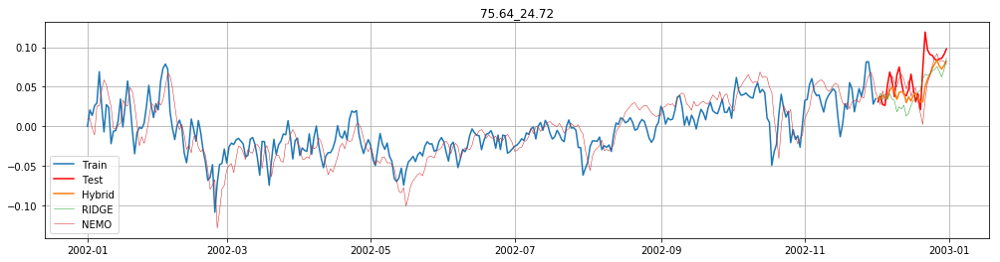

RIDGE:
MSE: 0.0006136387434509987
MAE: 0.020645041811715757
MAPE: 35.485

HYB:
MSE: 0.0004815433713593056
MAE: 0.016417714129966787
MAPE: 26.111


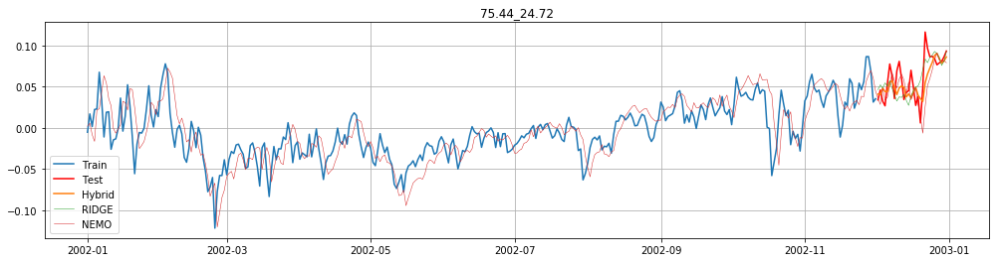

RIDGE:
MSE: 0.0004186648389700165
MAE: 0.01589969175405691
MAPE: 55.911

HYB:
MSE: 0.00039247201868380536
MAE: 0.015052652443847165
MAPE: 41.055


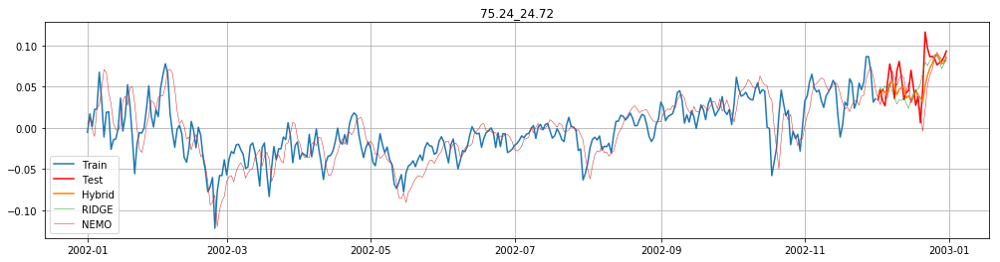

RIDGE:
MSE: 0.00044517766026846924
MAE: 0.016306396871916925
MAPE: 53.131

HYB:
MSE: 0.0004305900874386913
MAE: 0.01586457693386326
MAPE: 42.285


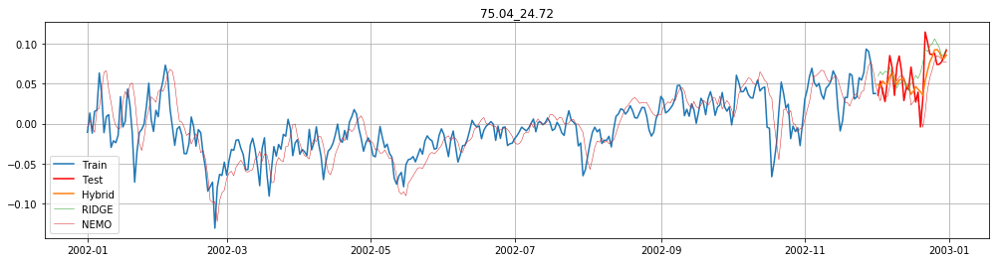

RIDGE:
MSE: 0.0005659820466777917
MAE: 0.019206314201643114
MAPE: -16.746

HYB:
MSE: 0.00046164894195224667
MAE: 0.01619013502390373
MAPE: -8.317


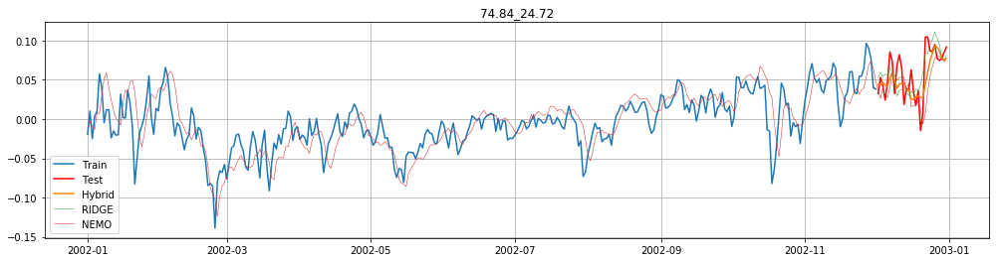

RIDGE:
MSE: 0.000571315892356964
MAE: 0.019203747841855353
MAPE: 40.883

HYB:
MSE: 0.0005298695877332111
MAE: 0.01780401725624633
MAPE: 28.209


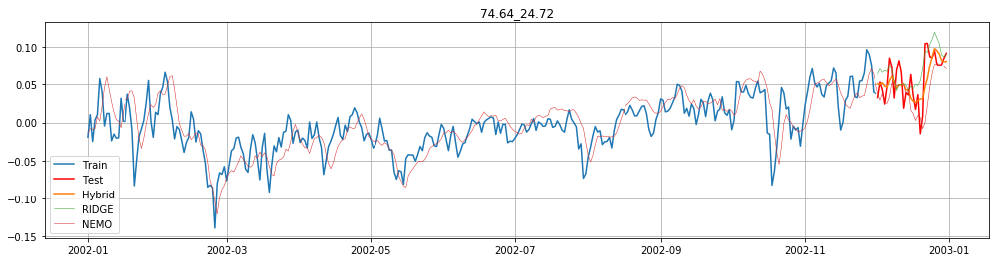

RIDGE:
MSE: 0.0007397223962069315
MAE: 0.022065753154125397
MAPE: 53.487

HYB:
MSE: 0.0005207409462908096
MAE: 0.017818904514425513
MAPE: 30.748


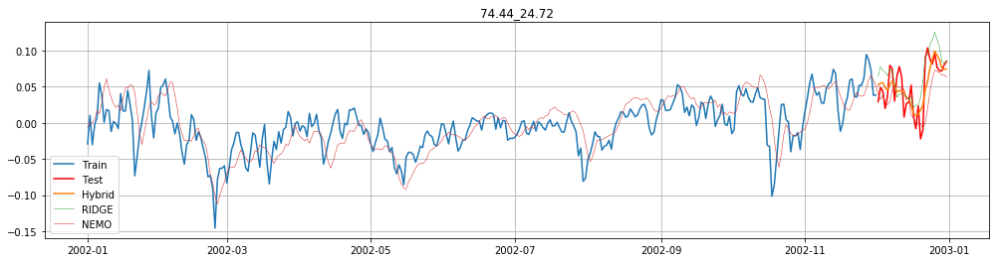

RIDGE:
MSE: 0.0008439007244906572
MAE: 0.023610950049438636
MAPE: 8.431

HYB:
MSE: 0.000514775006786844
MAE: 0.018952567108102083
MAPE: 19.716


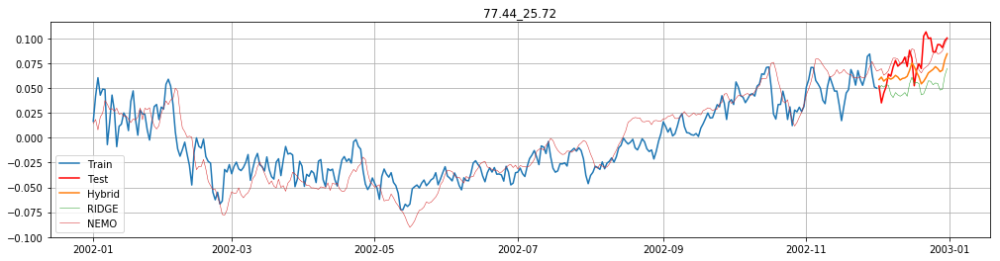

RIDGE:
MSE: 0.0010237210355214922
MAE: 0.02846162988992597
MAPE: 34.671

HYB:
MSE: 0.0004411296321207285
MAE: 0.01788257529845558
MAPE: 22.967


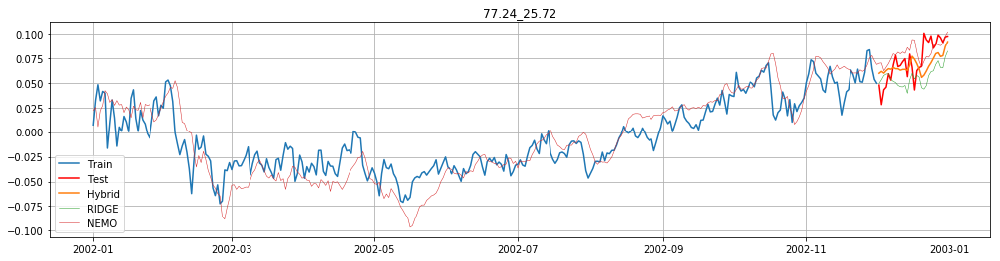

RIDGE:
MSE: 0.0005928469812418711
MAE: 0.020815978014918555
MAPE: 28.571

HYB:
MSE: 0.0003093918327095033
MAE: 0.01434080346759158
MAPE: 22.573


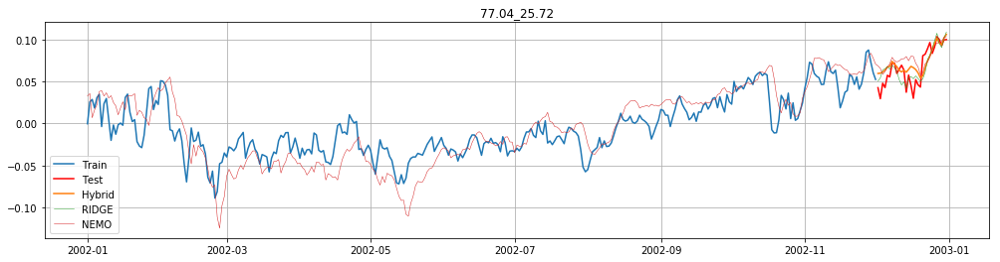

RIDGE:
MSE: 0.000173528160315815
MAE: 0.01078837050698569
MAPE: 20.038

HYB:
MSE: 0.00021827638432223842
MAE: 0.011593881185491702
MAPE: 24.239


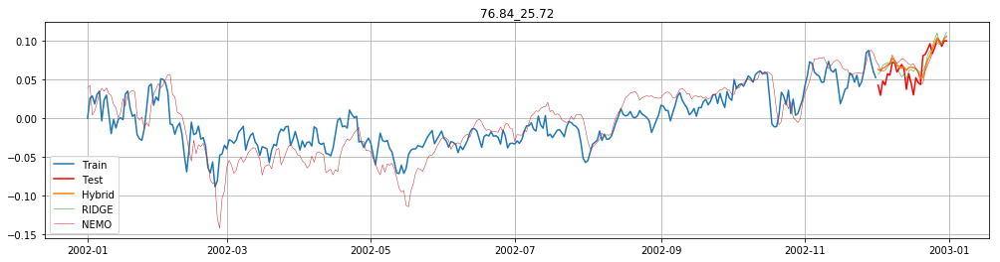

RIDGE:
MSE: 0.00020904228489165312
MAE: 0.012142237286326414
MAPE: 24.483

HYB:
MSE: 0.00023778963698832423
MAE: 0.012213705334137325
MAPE: 25.36


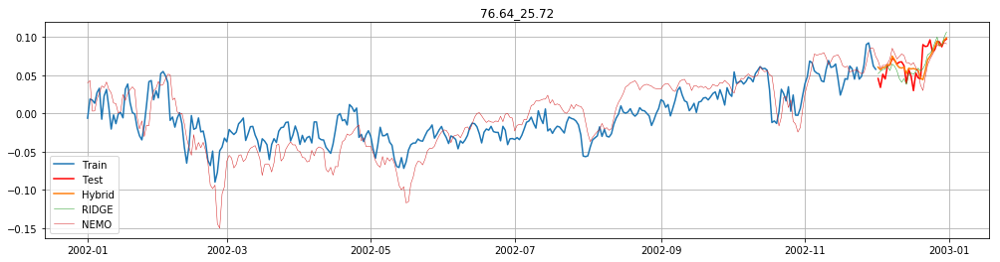

RIDGE:
MSE: 0.000180546310326247
MAE: 0.010763178615991024
MAPE: 18.19

HYB:
MSE: 0.0002119506084373299
MAE: 0.009529915505163454
MAPE: 17.231


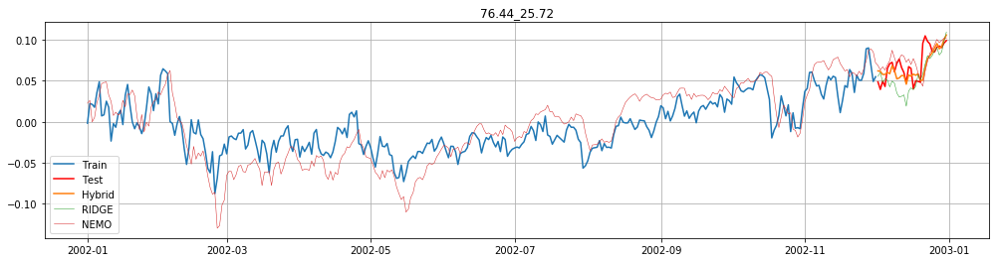

RIDGE:
MSE: 0.0004564050979996499
MAE: 0.01693637186785841
MAPE: 24.794

HYB:
MSE: 0.00023845747746428813
MAE: 0.011375330250566787
MAPE: 16.984


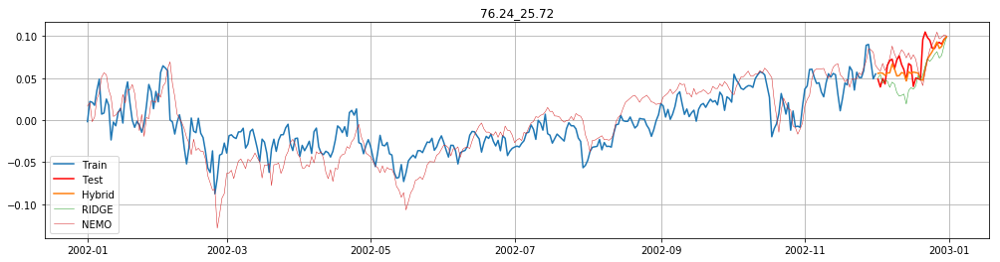

RIDGE:
MSE: 0.0005654367953504695
MAE: 0.019401636370536372
MAPE: 27.289

HYB:
MSE: 0.0002585608774268089
MAE: 0.01107957081276088
MAPE: 15.805


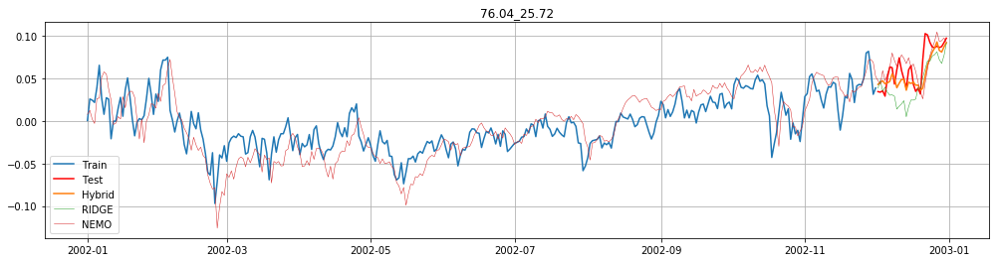

RIDGE:
MSE: 0.0006765769017166725
MAE: 0.021356456421925605
MAPE: 35.29

HYB:
MSE: 0.00028599704151606697
MAE: 0.01236028461011052
MAPE: 20.065


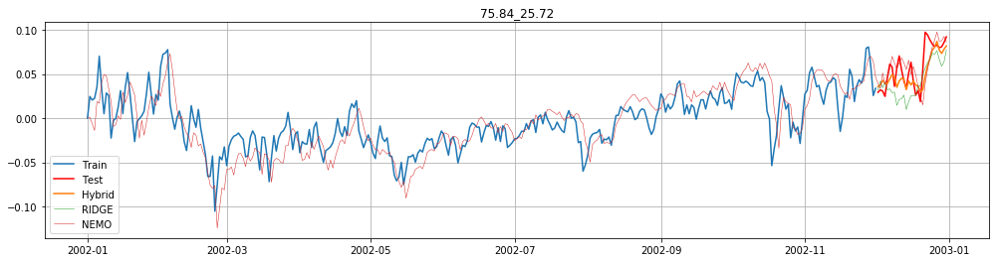

RIDGE:
MSE: 0.0005427357754173479
MAE: 0.01944024620288526
MAPE: 35.998

HYB:
MSE: 0.00027924361877901607
MAE: 0.012629125683905456
MAPE: 23.813


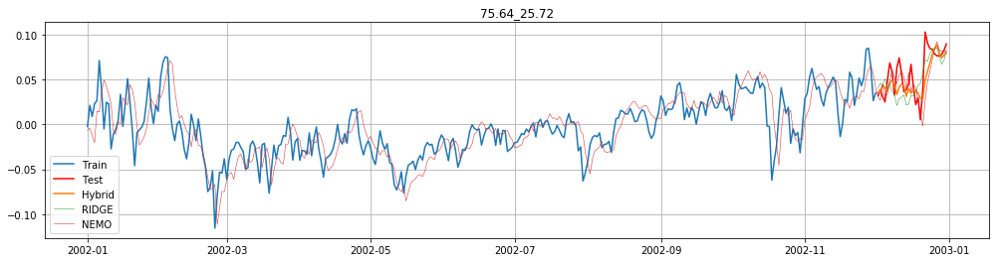

RIDGE:
MSE: 0.00042830549186877073
MAE: 0.016632927614000204
MAPE: 56.225

HYB:
MSE: 0.000332558816268106
MAE: 0.01401753391914894
MAPE: 39.436


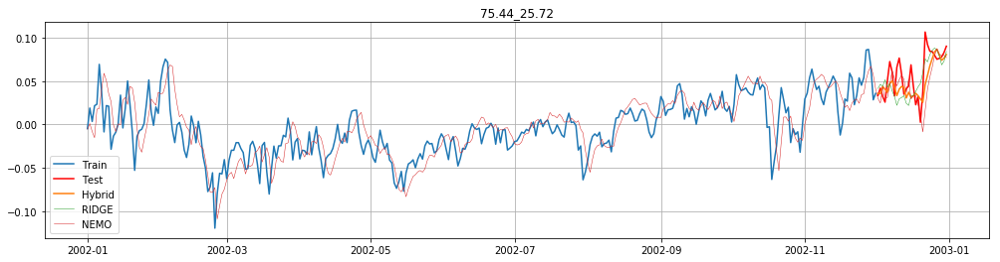

RIDGE:
MSE: 0.00045752603820779417
MAE: 0.01692225209249188
MAPE: 87.073

HYB:
MSE: 0.0004125114133831907
MAE: 0.015493085524469508
MAPE: 59.722


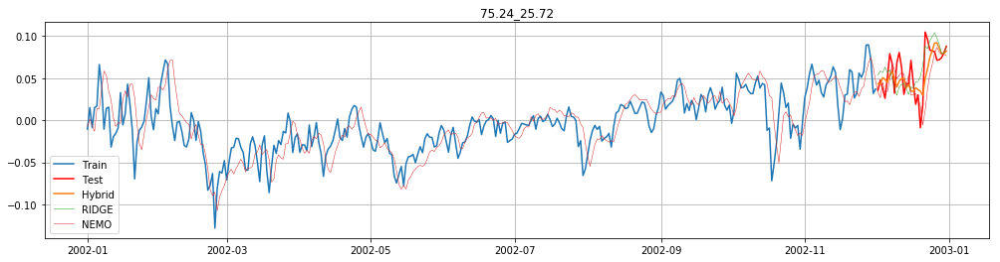

RIDGE:
MSE: 0.0005741899449051625
MAE: 0.01943650575603229
MAPE: 18.565

HYB:
MSE: 0.00044371062083508445
MAE: 0.01626078803380804
MAPE: 13.089


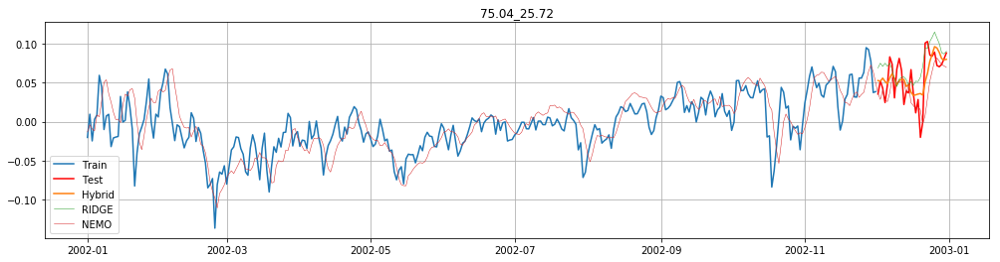

RIDGE:
MSE: 0.0008882261885382876
MAE: 0.02415167243794724
MAPE: -1647.145

HYB:
MSE: 0.0005382773669893898
MAE: 0.018316528871219765
MAPE: -786.939


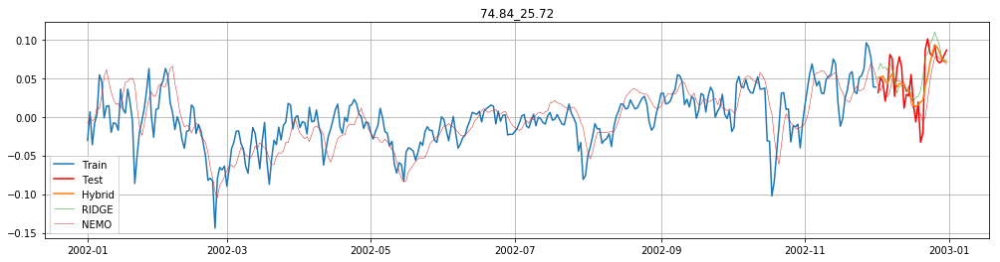

RIDGE:
MSE: 0.0007564707758892541
MAE: 0.02210780384881143
MAPE: 7.861

HYB:
MSE: 0.0005857167887478816
MAE: 0.018996156634850013
MAPE: 14.127


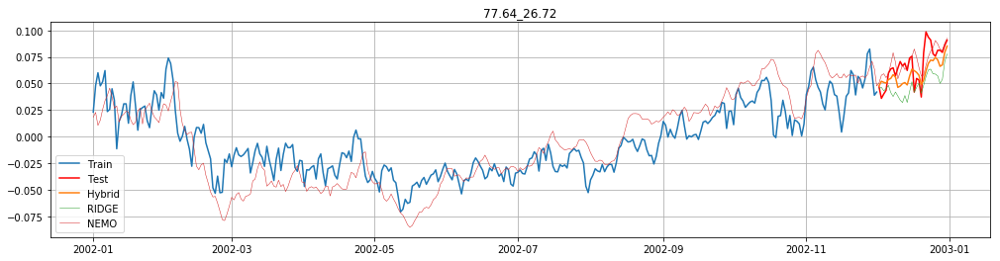

RIDGE:
MSE: 0.0005353249610718582
MAE: 0.019893749984900275
MAPE: 27.717

HYB:
MSE: 0.00022729688975160382
MAE: 0.012665441297009725
MAPE: 19.407


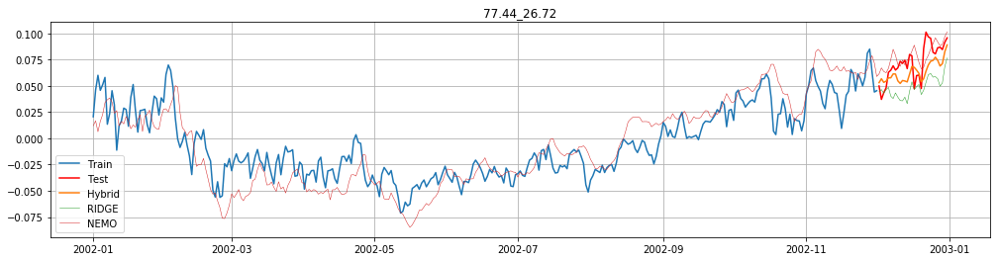

RIDGE:
MSE: 0.000725102997467708
MAE: 0.023587409297026737
MAPE: 30.804

HYB:
MSE: 0.00024317426932863969
MAE: 0.01308263942560809
MAPE: 18.478


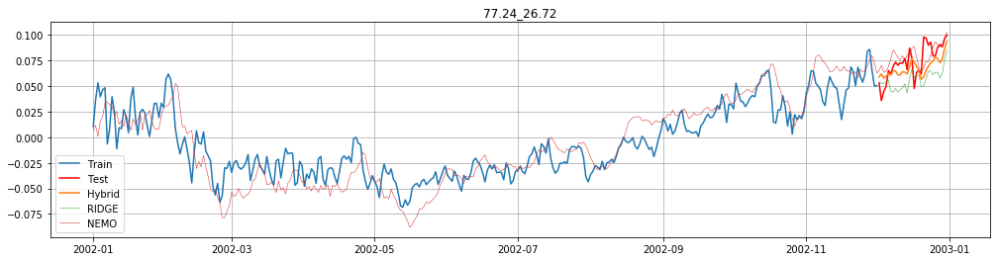

RIDGE:
MSE: 0.0005097282093440671
MAE: 0.01984005813117504
MAPE: 26.182

HYB:
MSE: 0.0002242703266559896
MAE: 0.011632241931740462
MAPE: 16.782


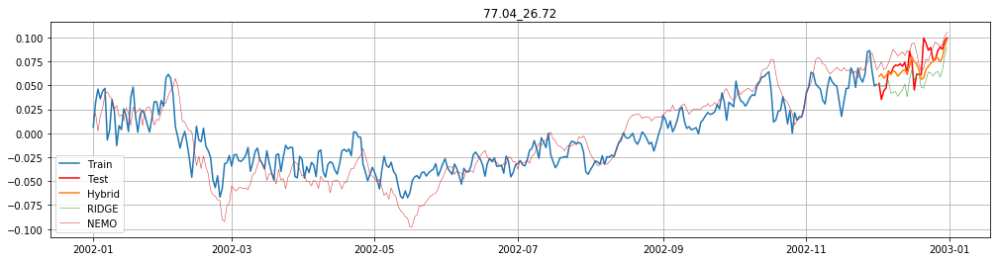

RIDGE:
MSE: 0.0005062976315654509
MAE: 0.01921067028640303
MAPE: 25.751

HYB:
MSE: 0.00020873613870127895
MAE: 0.010711333655639461
MAPE: 16.367


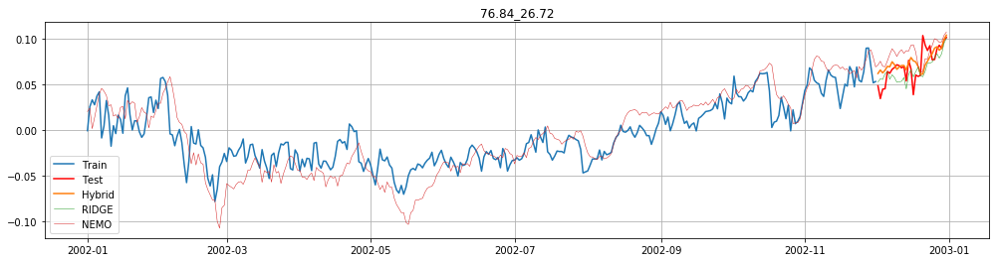

RIDGE:
MSE: 0.00022052555177085305
MAE: 0.011323761085667213
MAPE: 17.388

HYB:
MSE: 0.00022939009688887902
MAE: 0.01091609025773263
MAPE: 19.078


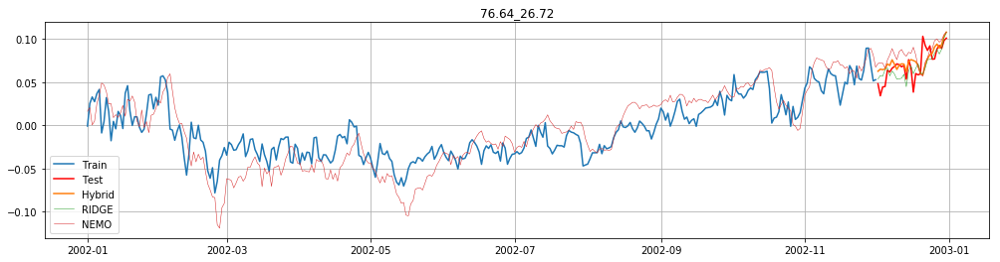

RIDGE:
MSE: 0.00020645860145473933
MAE: 0.010956194035332795
MAPE: 17.409

HYB:
MSE: 0.00024024951401985324
MAE: 0.011387334393661701
MAPE: 19.559


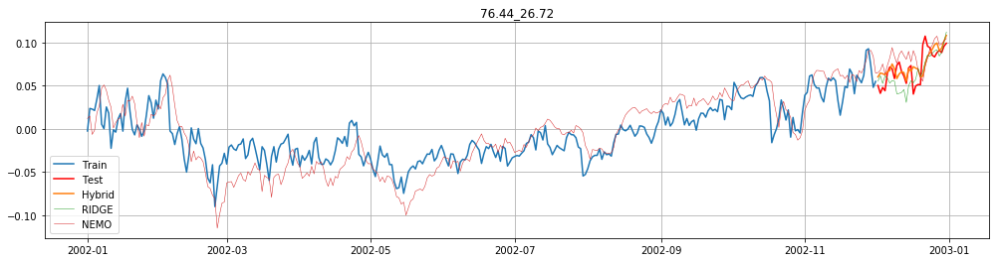

RIDGE:
MSE: 0.0002955079070038768
MAE: 0.014218800934829324
MAPE: 21.375

HYB:
MSE: 0.0002282902365033203
MAE: 0.011749481516442414
MAPE: 18.831


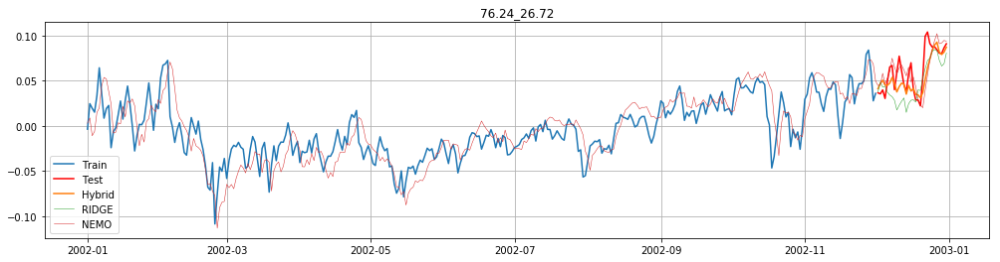

RIDGE:
MSE: 0.0005357480949105929
MAE: 0.018260137805766446
MAPE: 31.857

HYB:
MSE: 0.00029213981944544457
MAE: 0.012326777247973975
MAPE: 20.731


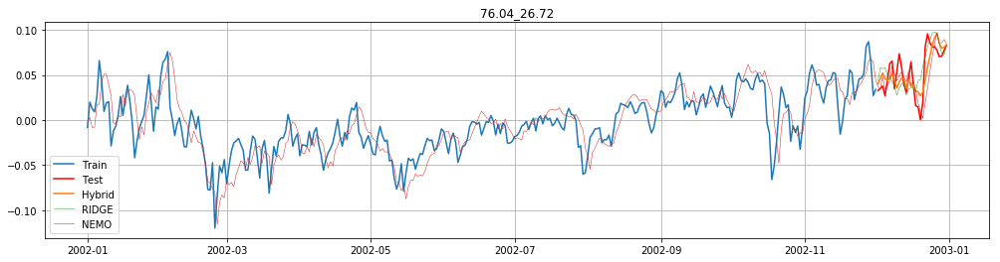

RIDGE:
MSE: 0.00041299099572200497
MAE: 0.016499427275969075
MAPE: 529.491

HYB:
MSE: 0.00029039813880125026
MAE: 0.01387792789277714
MAPE: 322.345


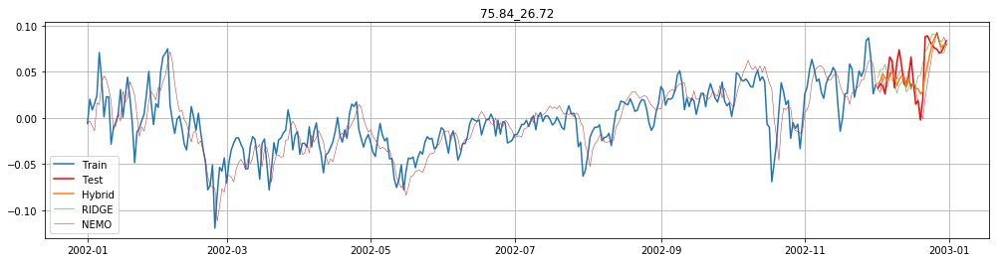

RIDGE:
MSE: 0.00042180744958924724
MAE: 0.016599824267903726
MAPE: -30.182

HYB:
MSE: 0.0003017384834080797
MAE: 0.013641580230051383
MAPE: -13.759


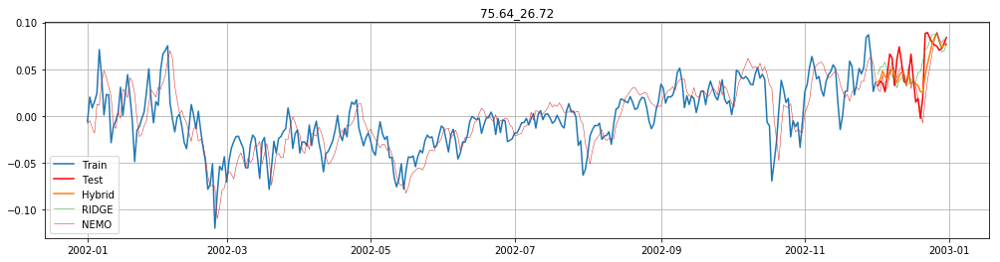

RIDGE:
MSE: 0.00040234782105238906
MAE: 0.016199215790210258
MAPE: -32.143

HYB:
MSE: 0.00030333013187835924
MAE: 0.013341864474325742
MAPE: -13.953


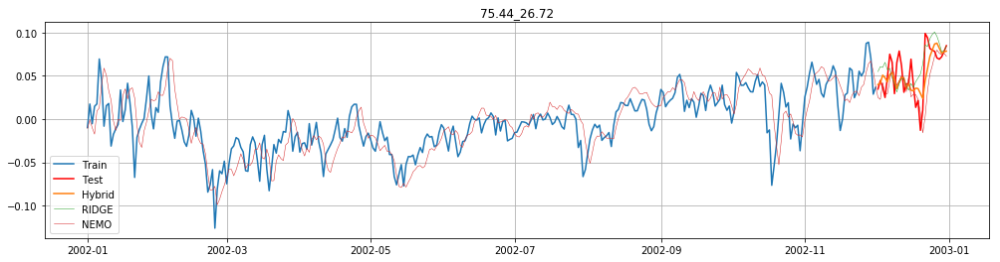

RIDGE:
MSE: 0.0006106821122035161
MAE: 0.019846357484860487
MAPE: 38.794

HYB:
MSE: 0.00044472143400386786
MAE: 0.016187657707035105
MAPE: 23.617


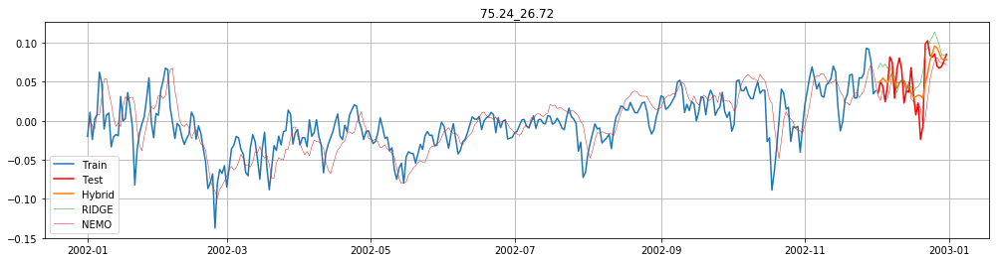

RIDGE:
MSE: 0.0008491015645611038
MAE: 0.02369204509873256
MAPE: 9.027

HYB:
MSE: 0.0005615959939458962
MAE: 0.01877620086157575
MAPE: 13.74


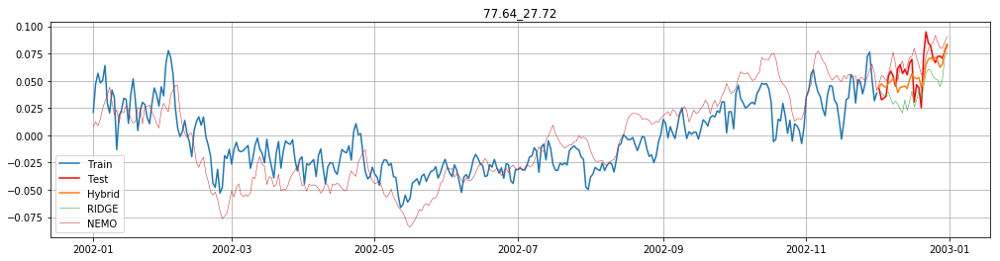

RIDGE:
MSE: 0.0005189885357856657
MAE: 0.019363280665549897
MAPE: 31.251

HYB:
MSE: 0.000176004671946155
MAE: 0.011002049320560118
MAPE: 21.182


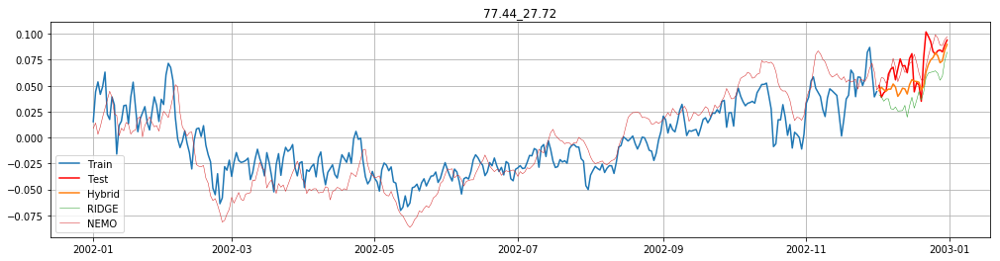

RIDGE:
MSE: 0.00087701080774524
MAE: 0.025854909229903213
MAPE: 36.148

HYB:
MSE: 0.0003086999991927572
MAE: 0.014189511982619411
MAPE: 20.19


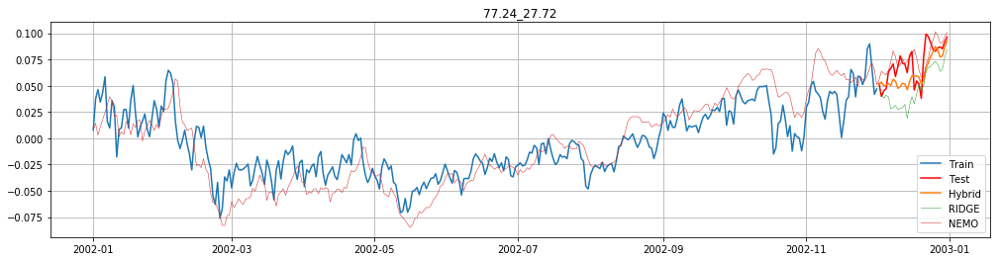

RIDGE:
MSE: 0.0007894601097734869
MAE: 0.023820279939820433
MAPE: 32.955

HYB:
MSE: 0.00024204101290747367
MAE: 0.01289603392298991
MAPE: 18.621


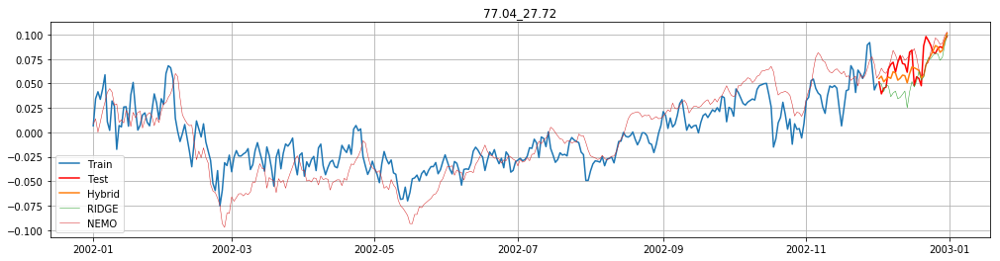

RIDGE:
MSE: 0.0004892659861187968
MAE: 0.017191096317993884
MAPE: 23.553

HYB:
MSE: 0.00019305342446377147
MAE: 0.011303497352860166
MAPE: 16.434


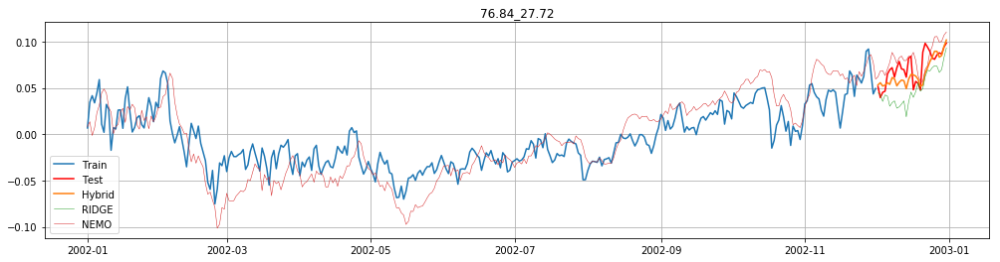

RIDGE:
MSE: 0.0007366719323334284
MAE: 0.022342085296498046
MAPE: 30.245

HYB:
MSE: 0.0002135062170678475
MAE: 0.011485216808822564
MAPE: 16.21


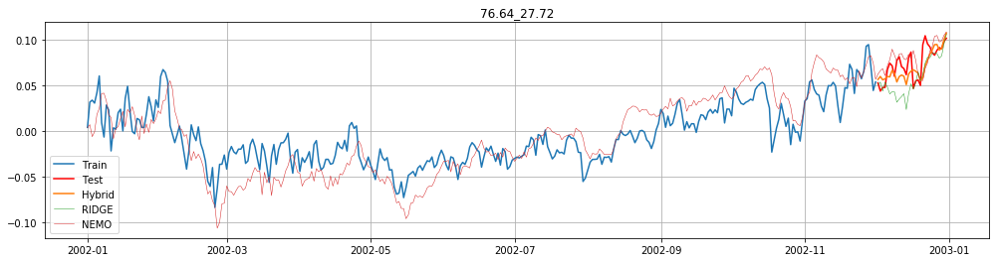

RIDGE:
MSE: 0.000521633154024713
MAE: 0.017412034110720277
MAPE: 23.338

HYB:
MSE: 0.00021269885281150397
MAE: 0.011671797979470943
MAPE: 16.338


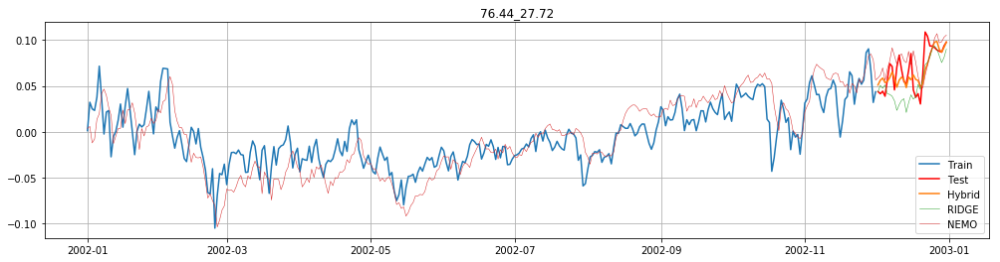

RIDGE:
MSE: 0.0005612375146683338
MAE: 0.01815063361212915
MAPE: 27.176

HYB:
MSE: 0.00024911406319341826
MAE: 0.012299660318676287
MAPE: 20.507


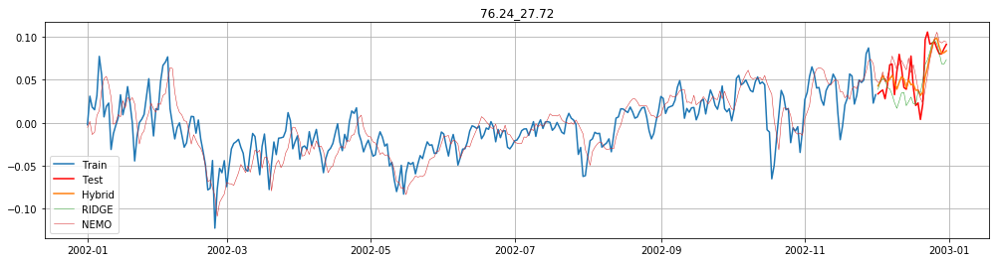

RIDGE:
MSE: 0.0005673908633026839
MAE: 0.01911757579515468
MAPE: 61.794

HYB:
MSE: 0.0003336019045258706
MAE: 0.014406632431718665
MAPE: 51.667


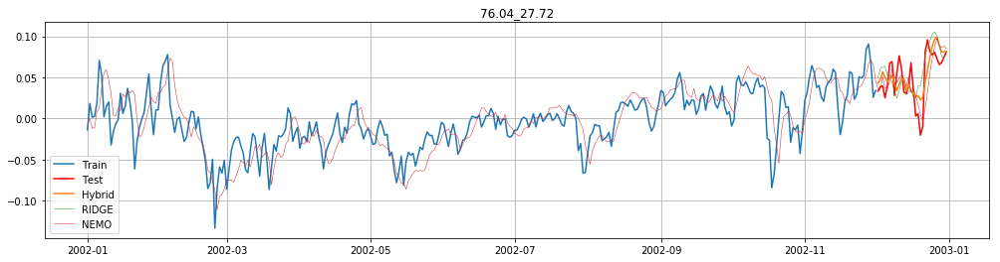

RIDGE:
MSE: 0.0006843161235595555
MAE: 0.02100524444199335
MAPE: 39.35

HYB:
MSE: 0.0004644141714600661
MAE: 0.018014714749628805
MAPE: 43.758


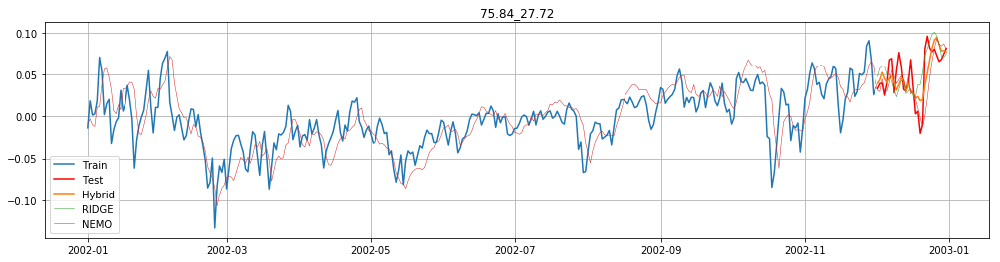

RIDGE:
MSE: 0.0006355064999643097
MAE: 0.020340086211339963
MAPE: 36.572

HYB:
MSE: 0.0004618662758782205
MAE: 0.01715565014788828
MAPE: 37.062


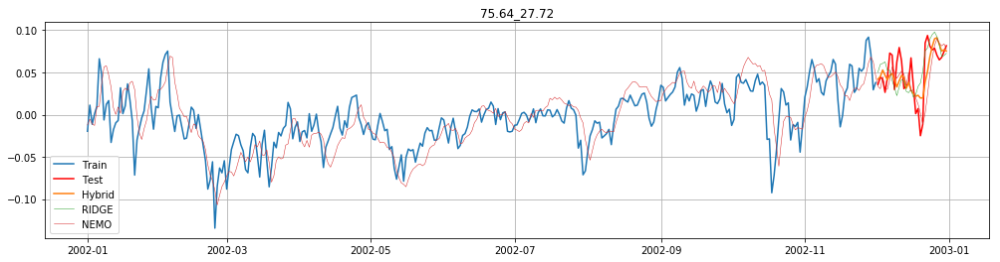

RIDGE:
MSE: 0.0006835208673562972
MAE: 0.020974955474042253
MAPE: 78.015

HYB:
MSE: 0.0005023535069466817
MAE: 0.017826175921734466
MAPE: 74.892


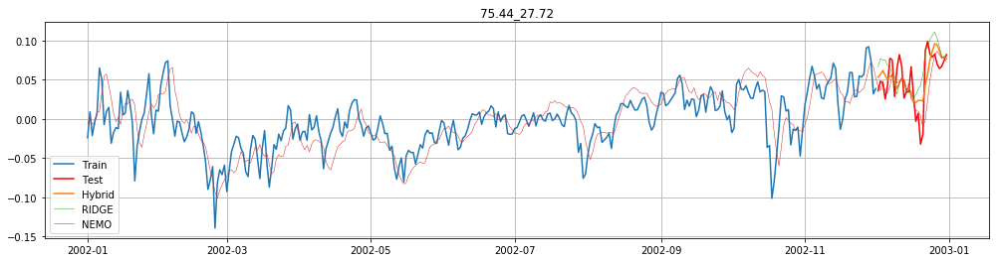

RIDGE:
MSE: 0.0009484014945451957
MAE: 0.024520369418695516
MAPE: -5.878

HYB:
MSE: 0.0006023309041857538
MAE: 0.020432444688756452
MAPE: 0.047


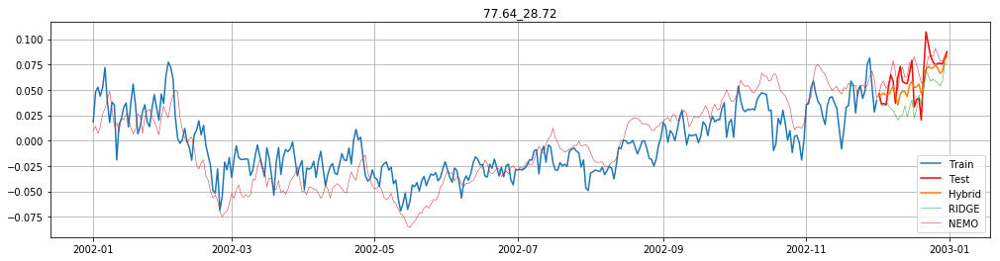

RIDGE:
MSE: 0.0005856218628110377
MAE: 0.02048515900299517
MAPE: 33.024

HYB:
MSE: 0.00023088143981578327
MAE: 0.01257477816563824
MAPE: 24.127


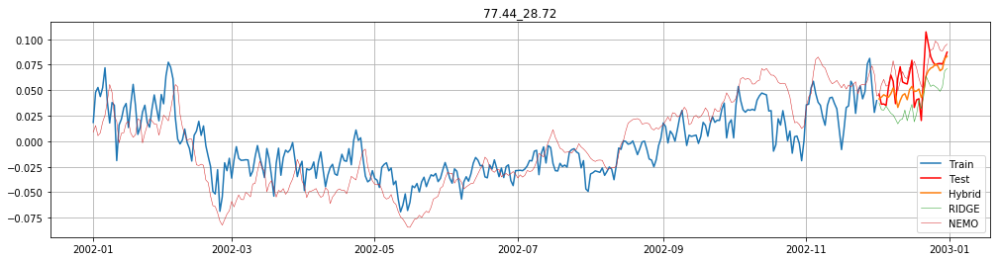

RIDGE:
MSE: 0.0007677949425480136
MAE: 0.024118402855098513
MAPE: 38.263

HYB:
MSE: 0.00027499705365535145
MAE: 0.01322511687102298
MAPE: 24.042


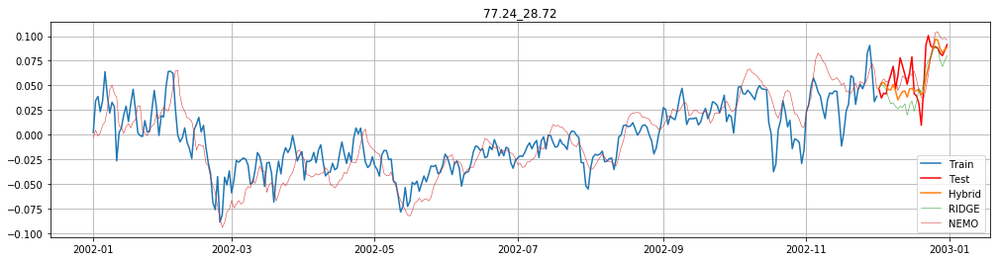

RIDGE:
MSE: 0.0005586234547803151
MAE: 0.019057201876307158
MAPE: 40.855

HYB:
MSE: 0.00030541243394290756
MAE: 0.013529793532406634
MAPE: 30.534


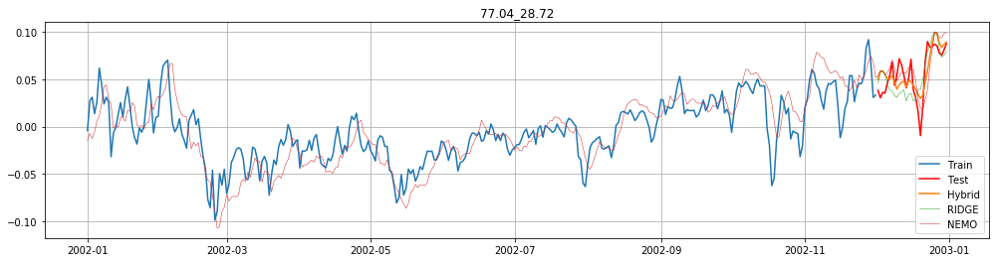

RIDGE:
MSE: 0.00040549377630606646
MAE: 0.016238455966114274
MAPE: 16.261

HYB:
MSE: 0.0002697730728931851
MAE: 0.013361865161701377
MAPE: 12.503


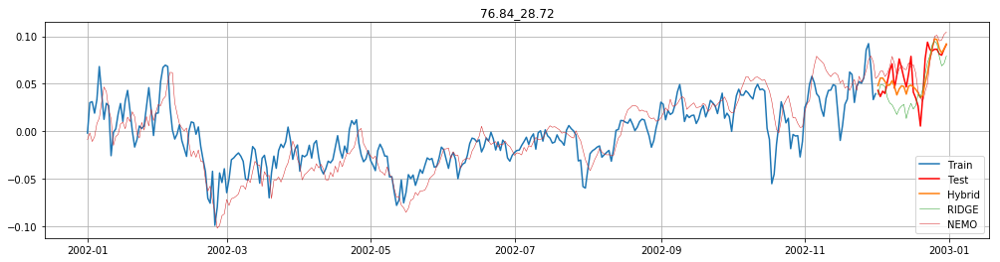

RIDGE:
MSE: 0.000628996315783367
MAE: 0.020402037830909284
MAPE: 51.23

HYB:
MSE: 0.00025343833101015335
MAE: 0.01271438913233055
MAPE: 38.582


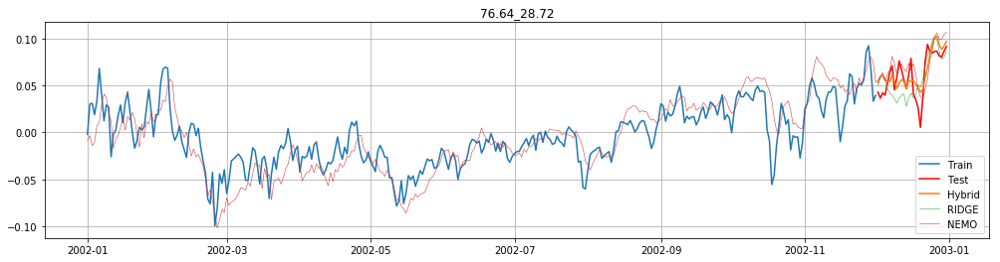

RIDGE:
MSE: 0.00039725067392554973
MAE: 0.016464926442846407
MAPE: 53.815

HYB:
MSE: 0.00023847015567853082
MAE: 0.013074868723670382
MAPE: 45.218


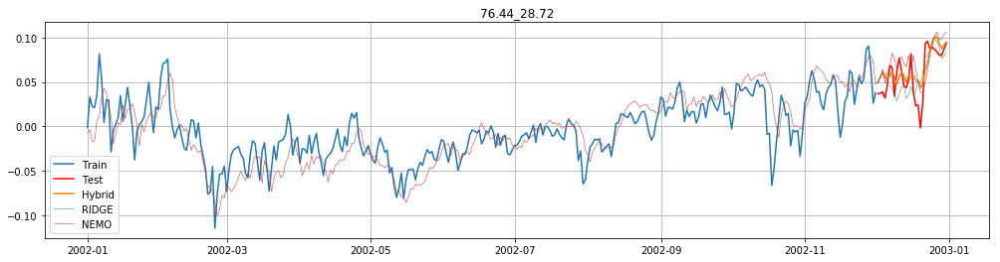

RIDGE:
MSE: 0.0004420296234078625
MAE: 0.01693180971649013
MAPE: -65.642

HYB:
MSE: 0.00034710600913295467
MAE: 0.015587221493120588
MAPE: -56.248


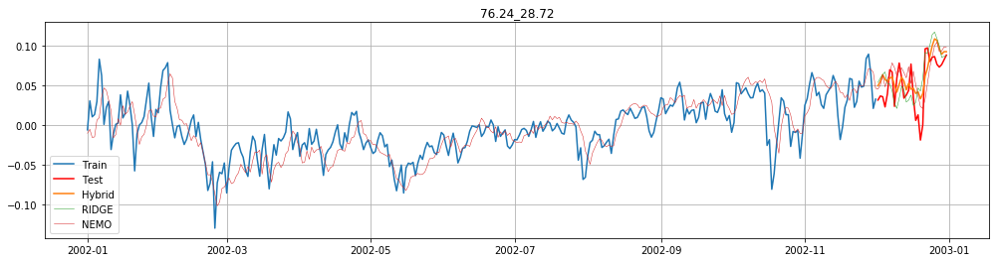

RIDGE:
MSE: 0.0007827129417039266
MAE: 0.023155100378806068
MAPE: 453.088

HYB:
MSE: 0.0005707631759015056
MAE: 0.020744530813194887
MAPE: 324.656


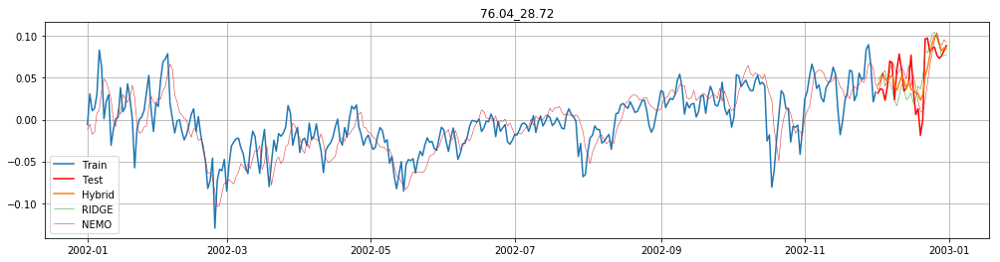

RIDGE:
MSE: 0.0006643970359516824
MAE: 0.02122738046697803
MAPE: 390.909

HYB:
MSE: 0.0004670923528397491
MAE: 0.017373227594002772
MAPE: 242.52


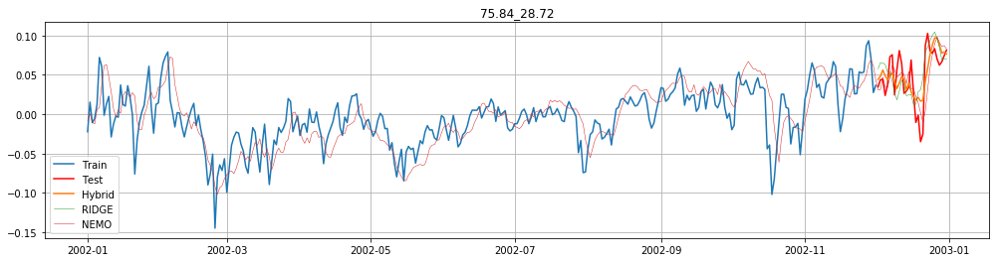

RIDGE:
MSE: 0.0008529367158230325
MAE: 0.023815412722051614
MAPE: -66.21

HYB:
MSE: 0.0006205020351238331
MAE: 0.02041860162007206
MAPE: -50.422


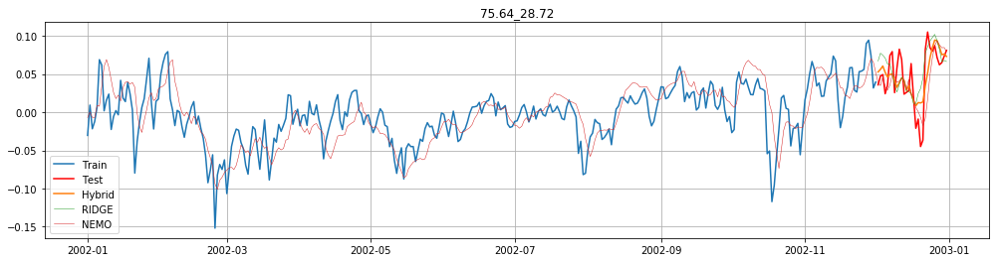

RIDGE:
MSE: 0.000959316526557433
MAE: 0.02439807145374114
MAPE: 4.986

HYB:
MSE: 0.0007289789404684063
MAE: 0.02206183709176357
MAPE: 9.725


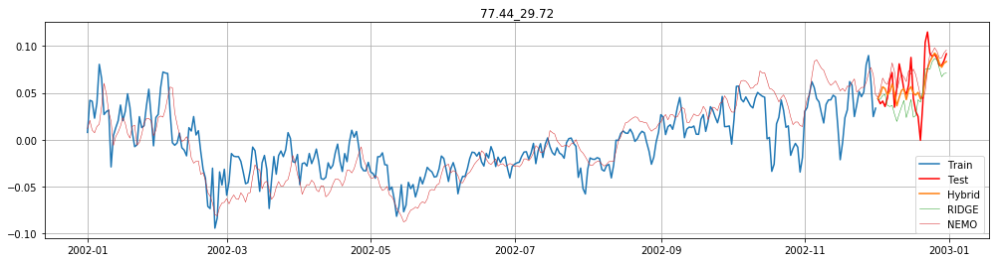

RIDGE:
MSE: 0.0005711905766672443
MAE: 0.01919895568493184
MAPE: -150.377

HYB:
MSE: 0.00035383016876795823
MAE: 0.013776769152031243
MAPE: -172.248


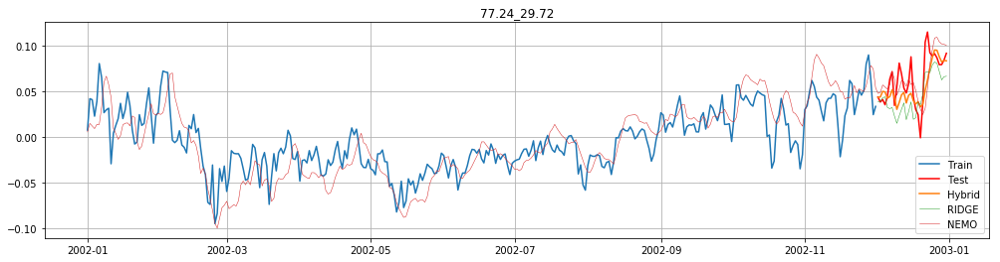

RIDGE:
MSE: 0.0007043721790546501
MAE: 0.021878417618006223
MAPE: -126.608

HYB:
MSE: 0.00045006529937927125
MAE: 0.015185059002988062
MAPE: -126.531


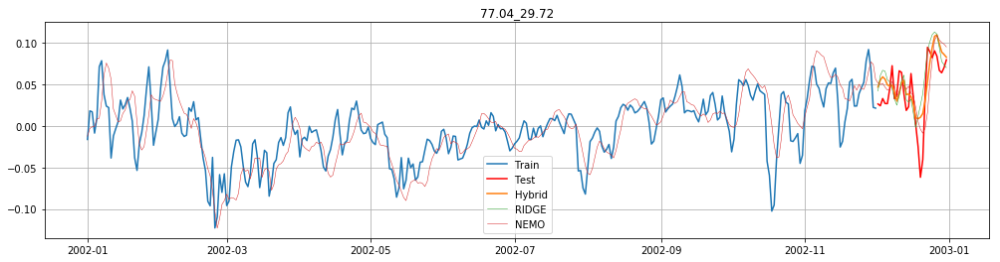

RIDGE:
MSE: 0.0009414709969342201
MAE: 0.023814057591002517
MAPE: 32.417

HYB:
MSE: 0.0007080561536728008
MAE: 0.022077247846285283
MAPE: 44.357


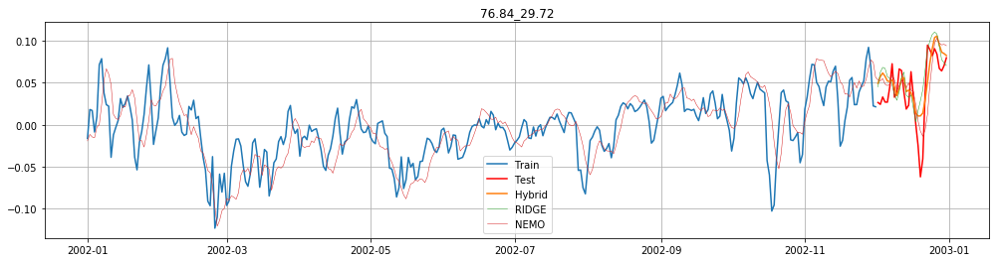

RIDGE:
MSE: 0.0009744668829787129
MAE: 0.023913711319142498
MAPE: 29.553

HYB:
MSE: 0.0007003974003913778
MAE: 0.021808257064567207
MAPE: 53.571


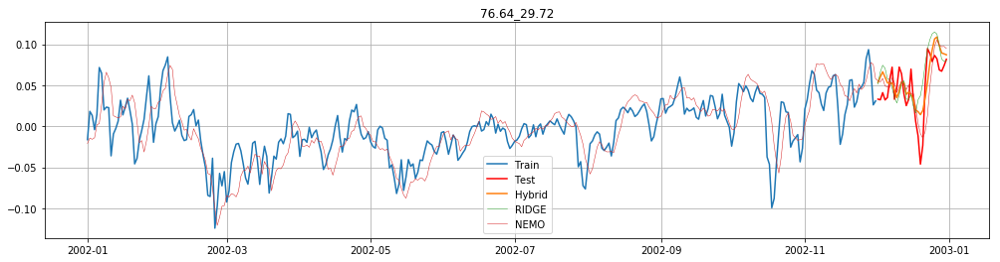

RIDGE:
MSE: 0.0009320174036812751
MAE: 0.023438823991764193
MAPE: 9.101

HYB:
MSE: 0.0005848842362245713
MAE: 0.020785978714846436
MAPE: 20.485


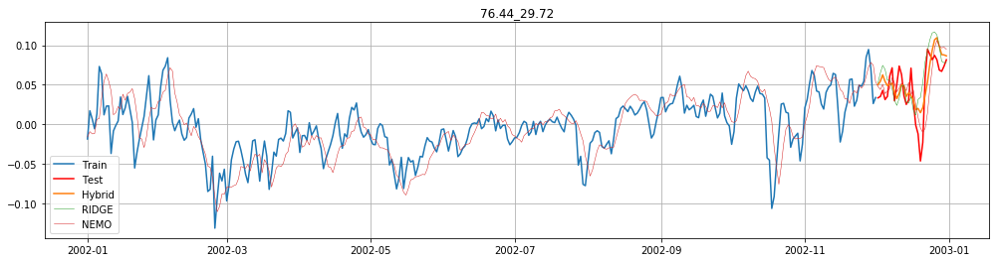

RIDGE:
MSE: 0.0009337627116750731
MAE: 0.023874612036650554
MAPE: -55.857

HYB:
MSE: 0.0005952078877992732
MAE: 0.020936111703494065
MAPE: -81.582


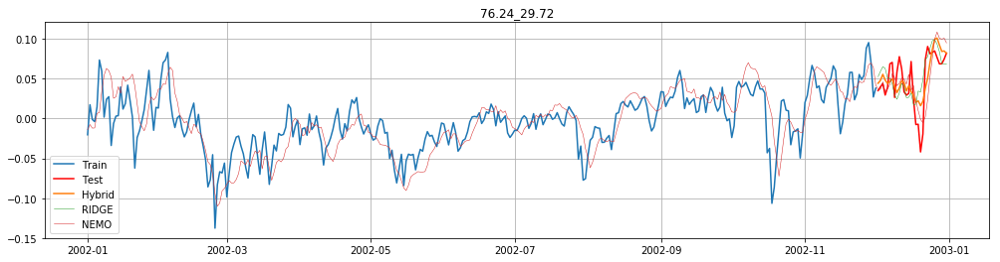

RIDGE:
MSE: 0.0007587219078816525
MAE: 0.020743925540103503
MAPE: -22.476

HYB:
MSE: 0.0005771382482580068
MAE: 0.019792654224863412
MAPE: -12.011


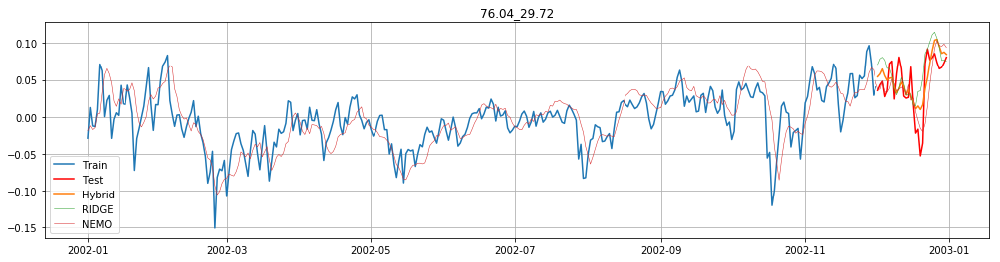

RIDGE:
MSE: 0.0011997584844782995
MAE: 0.027042315653944174
MAPE: 7.613

HYB:
MSE: 0.0007377487227701906
MAE: 0.023148573983657918
MAPE: 12.273


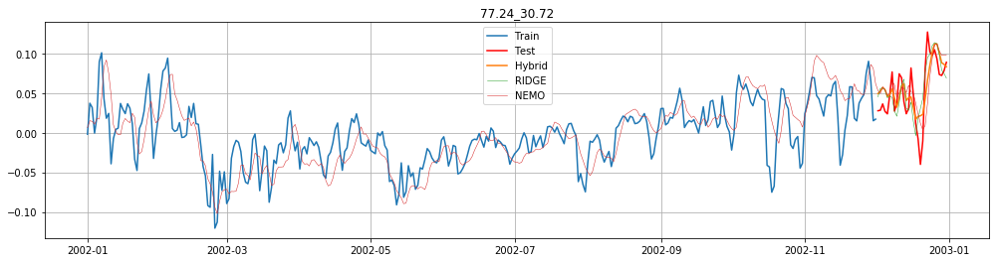

RIDGE:
MSE: 0.0006899291826243075
MAE: 0.020779520227187473
MAPE: 1.64

HYB:
MSE: 0.0006595026603553273
MAE: 0.0212531415239725
MAPE: 8.322


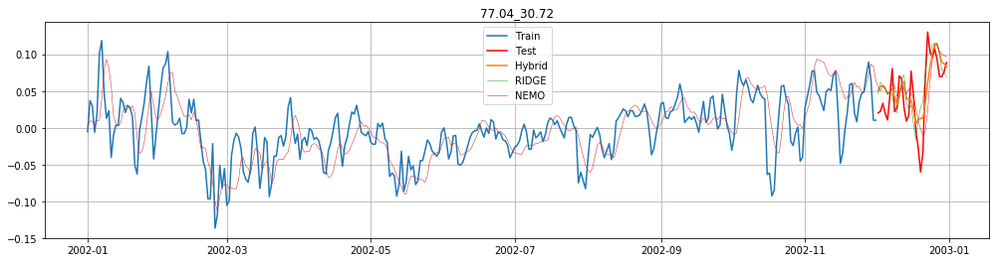

RIDGE:
MSE: 0.0010324818234617964
MAE: 0.025157112643618633
MAPE: 28.612

HYB:
MSE: 0.0009673243831267343
MAE: 0.02618108660137939
MAPE: 43.992


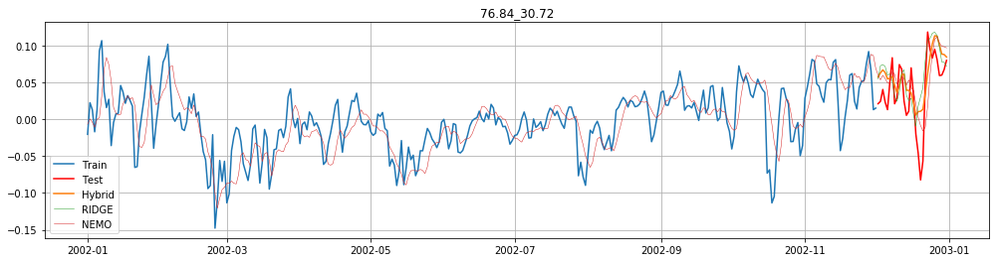

RIDGE:
MSE: 0.0016512775178296251
MAE: 0.032214684215476436
MAPE: 65.526

HYB:
MSE: 0.001311451853070466
MAE: 0.03063962847661205
MAPE: 70.491


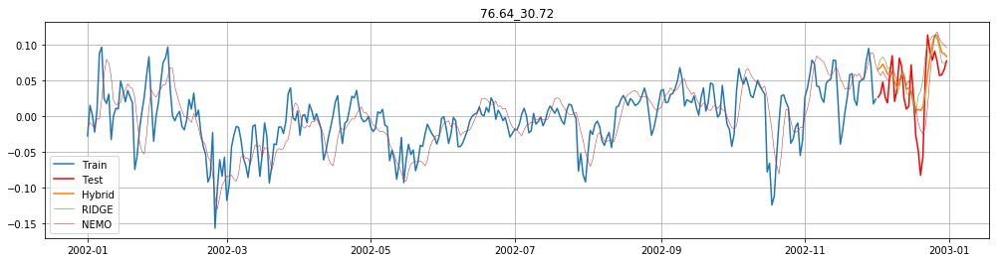

RIDGE:
MSE: 0.0018222066468157134
MAE: 0.03345572224153013
MAPE: 44.914

HYB:
MSE: 0.001343126085303555
MAE: 0.03109417003563085
MAPE: 49.669


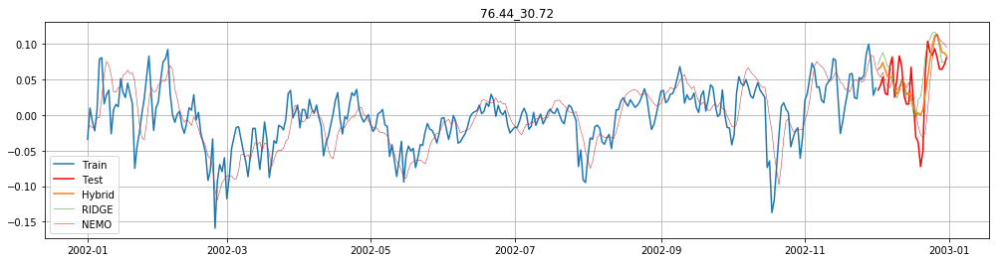

RIDGE:
MSE: 0.0014386781850576958
MAE: 0.02929188726951345
MAPE: 22.844

HYB:
MSE: 0.0009690996717988431
MAE: 0.026938799199755108
MAPE: 28.098


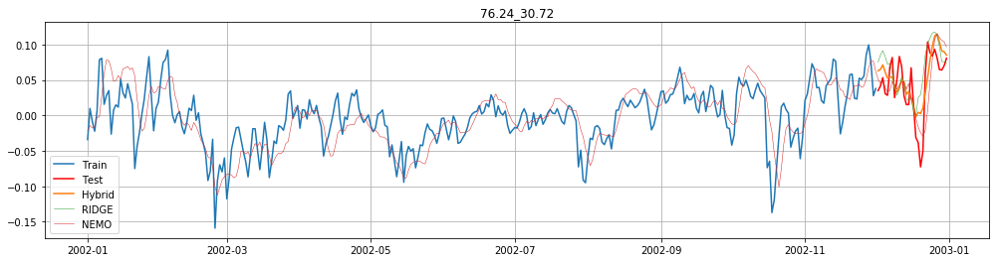

RIDGE:
MSE: 0.0015378196630636079
MAE: 0.030565228144047458
MAPE: 25.325

HYB:
MSE: 0.0009769562852458874
MAE: 0.026991636755070915
MAPE: 28.121


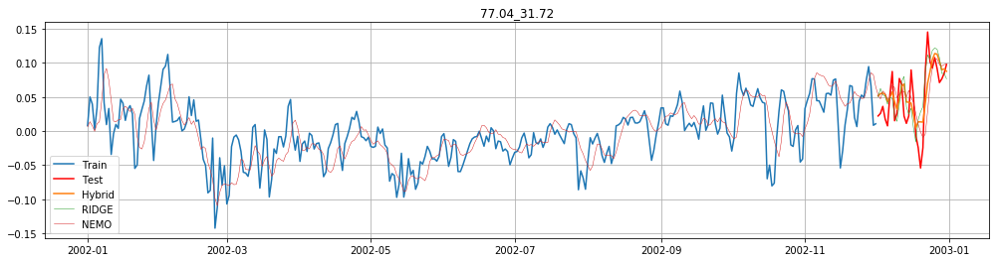

RIDGE:
MSE: 0.0011281373511154112
MAE: 0.026741339964839607
MAPE: 41.54

HYB:
MSE: 0.0010467855283981821
MAE: 0.027143225871854457
MAPE: 52.824


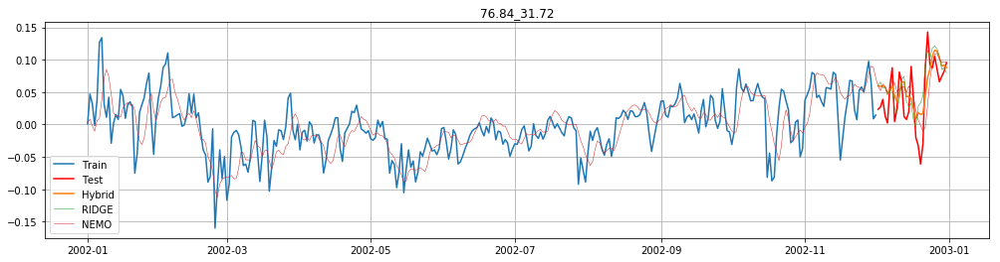

RIDGE:
MSE: 0.0014380811259786634
MAE: 0.03077489459356344
MAPE: 128.916

HYB:
MSE: 0.0013087544935498638
MAE: 0.030854305565400808
MAPE: 151.322


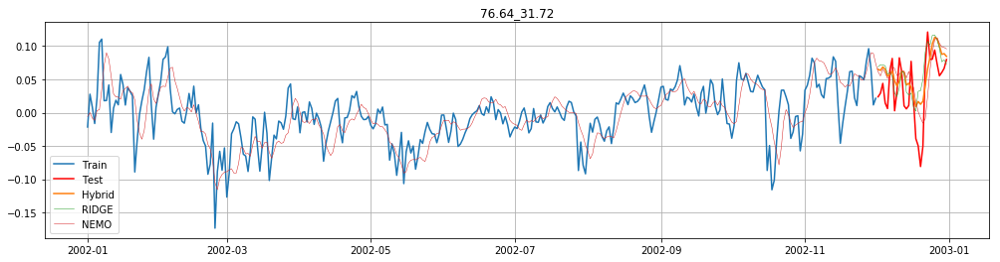

RIDGE:
MSE: 0.0019179283344614563
MAE: 0.03492990225946642
MAPE: 118.95

HYB:
MSE: 0.0016077846828152348
MAE: 0.03393984959545982
MAPE: 151.049


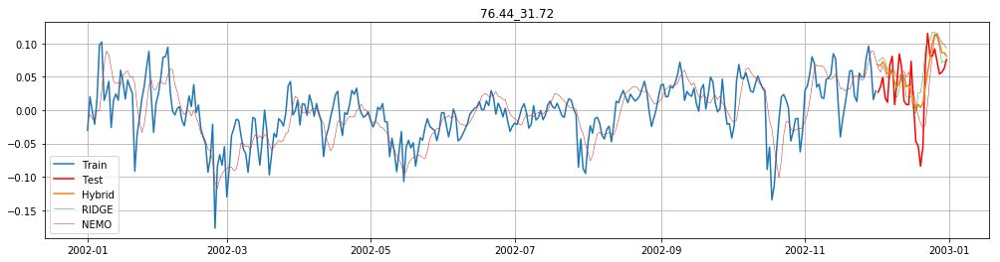

RIDGE:
MSE: 0.0018738533076308325
MAE: 0.03442233800335913
MAPE: 63.044

HYB:
MSE: 0.001499610170081328
MAE: 0.03335195483375154
MAPE: 81.449


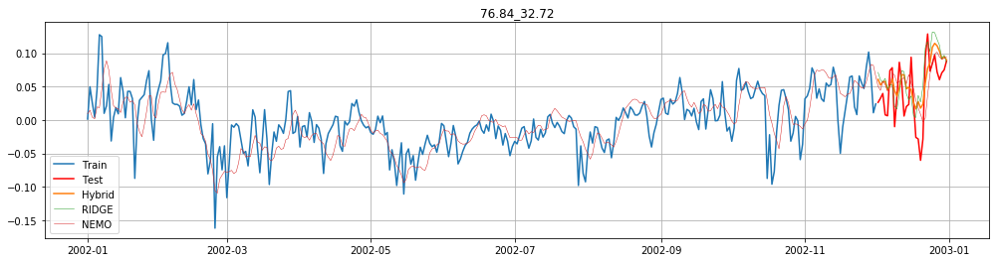

RIDGE:
MSE: 0.0016976965070582407
MAE: 0.03543436746445929
MAPE: 85.379

HYB:
MSE: 0.0013970169097426712
MAE: 0.03221541949077313
MAPE: 70.171


In [150]:
len_forecast = 30
for column in list(df_rean.columns.values):
    if column!='dates':
        true_values = np.array(df_rean[column])
        train_data = df_rean[column][:-len_forecast]
        test_data = df_rean[column][-len_forecast:]
        
        nemo_pr=np.array(df_nemo[column][-len_forecast:])
        
        # Define PrimaryNode models - its first level models
        node_first = PrimaryNode('trend_data_model')
        node_second = PrimaryNode('residual_data_model')
        # Define SecondaryNode models - its second level models
        node_trend_model = SecondaryNode('ridge', nodes_from=[node_first])
        node_residual_model = SecondaryNode('ridge', nodes_from=[node_second])
        # Root node - make final prediction
        node_final = SecondaryNode('svr', nodes_from=[node_trend_model, node_residual_model])
        final_chain = TsForecastingChain(node_final)        
        predicted_values = pd.Series(make_forecast(chain = final_chain,
                                 train_data = train_data, 
                                 len_forecast = len_forecast,
                                 max_window_size = 60))

        
        # считаем среднее между nemo и ridge
        hybrid_forecact=pd.Series((nemo_pr+predicted_values)/2)
        
        hybrid_forecact.index = df_rean['dates'][-len_forecast:]
        predicted_values.index = df_rean['dates'][-len_forecast:]
        test_data.index = df_rean['dates'][-len_forecast:]
        
        plt.rcParams['figure.figsize'] = [17, 4]
        plt.plot(df_rean['dates'][:-len_forecast], train_data, label='Train')
        plt.plot(df_rean['dates'][-len_forecast:], test_data, c='r', label='Test')
        plt.plot(df_rean['dates'][-len_forecast:],hybrid_forecact, label='Hybrid')
        plt.plot(df_rean['dates'][-len_forecast:],predicted_values, label='RIDGE', linewidth=0.5)
        plt.plot(df_rean['dates'], df_nemo[column], label='NEMO', linewidth=0.5)
        plt.title(df_rean[column].name)
        plt.legend()
        plt.grid()
        plt.show()
                
        params_hyb = norm.fit(test_data-hybrid_forecact)
        ks_hyb = kstest(test_data-hybrid_forecact, 'norm', params, N=1000)[1]
        params_RIDGE = norm.fit(test_data-predicted_values)
        ks_RIDGE = kstest(test_data-predicted_values, 'norm', params, N=1000)[1]
        
        MSE_ridge=mean_squared_error(test_data, predicted_values)
        MAE_ridge=mean_absolute_error(test_data, predicted_values)
        MAPE_ridge=round(np.mean(np.abs(test_data-predicted_values)/test_data)*100,3)
        
        MSE_hyb=mean_squared_error(test_data, hybrid_forecact)
        MAE_hyb=mean_absolute_error(test_data, hybrid_forecact)
        MAPE_hyb=round(np.mean(np.abs(test_data-hybrid_forecact)/test_data)*100,3)
        
        print('RIDGE:')
        print('MSE: '+str(MSE_ridge))
        print('MAE: '+str(MAE_ridge))
        print('MAPE: '+str(MAPE_ridge))
        
        print('\nHYB:')
        print('MSE: '+str(MSE_hyb))
        print('MAE: '+str(MAE_hyb))
        print('MAPE: '+str(MAPE_hyb))
        
        errors_df = errors_df.append({'POINT': column, 
                                      'MSE_RIDGE': MSE_ridge,
                                      'MAE_RIDGE': MAE_ridge,
                                      'MAPE_RIDGE': MAPE_ridge,
                                      'KS_RIDGE': ks_RIDGE,
                                      'MSE_HYB': MSE_hyb,
                                      'MAE_HYB': MAE_hyb,
                                      'MAPE_HYB': MAPE_hyb,
                                      'KS_HYB':ks_hyb,
                                     } , ignore_index=True)

In [151]:
errors_df

,POINT,MSE_RIDGE,MAE_RIDGE,MAPE_RIDGE,KS_RIDGE,MSE_HYB,MAE_HYB,MAPE_HYB,KS_HYB
0,76.04_8.72,0.000231,0.011904,19.496,4.055212e-06,0.000186,0.010684,17.849,1.143261e-03
1,75.84_8.72,0.000288,0.013884,26.229,1.496894e-06,0.000117,0.008889,18.779,1.808609e-02
2,75.64_8.72,0.000328,0.016000,36.350,5.526062e-09,0.000076,0.006282,16.858,1.285483e-02
3,75.44_8.72,0.000190,0.012031,25.938,9.126939e-08,0.000106,0.008220,20.197,6.997383e-03
4,76.44_9.72,0.000084,0.007367,9.951,8.460953e-03,0.000444,0.018989,25.401,5.168025e-10
...,...,...,...,...,...,...,...,...,...
272,77.04_31.72,0.001128,0.026741,41.540,1.706462e-02,0.001047,0.027143,52.824,1.109077e-02
273,76.84_31.72,0.001438,0.030775,128.916,3.598658e-03,0.001309,0.030854,151.322,1.079056e-03
274,76.64_31.72,0.001918,0.034930,118.950,1.181228e-05,0.001608,0.033940,151.049,4.210201e-06
275,76.44_31.72,0.001874,0.034422,63.044,1.222395e-04,0.001500,0.033352,81.449,4.842499e-06


In [152]:
errors_df['MSE_DIF']=abs(errors_df['MSE_HYB'])-abs(errors_df['MSE_RIDGE'])
errors_df['MAE_DIF']=abs(errors_df['MAE_HYB'])-abs(errors_df['MAE_RIDGE'])
errors_df['MAPE_DIF']=abs(errors_df['MAPE_HYB'])-abs(errors_df['MAPE_RIDGE'])
errors_df['KS_DIF']=abs(errors_df['KS_HYB'])-abs(errors_df['KS_RIDGE'])
errors_df

,POINT,MSE_RIDGE,MAE_RIDGE,MAPE_RIDGE,KS_RIDGE,MSE_HYB,MAE_HYB,MAPE_HYB,KS_HYB,MSE_DIF,MAE_DIF,MAPE_DIF,KS_DIF
0,76.04_8.72,0.000231,0.011904,19.496,4.055212e-06,0.000186,0.010684,17.849,1.143261e-03,-0.000044,-0.001220,-1.647,0.001139
1,75.84_8.72,0.000288,0.013884,26.229,1.496894e-06,0.000117,0.008889,18.779,1.808609e-02,-0.000171,-0.004995,-7.450,0.018085
2,75.64_8.72,0.000328,0.016000,36.350,5.526062e-09,0.000076,0.006282,16.858,1.285483e-02,-0.000252,-0.009719,-19.492,0.012855
3,75.44_8.72,0.000190,0.012031,25.938,9.126939e-08,0.000106,0.008220,20.197,6.997383e-03,-0.000084,-0.003812,-5.741,0.006997
4,76.44_9.72,0.000084,0.007367,9.951,8.460953e-03,0.000444,0.018989,25.401,5.168025e-10,0.000360,0.011622,15.450,-0.008461
...,...,...,...,...,...,...,...,...,...,...,...,...,...
272,77.04_31.72,0.001128,0.026741,41.540,1.706462e-02,0.001047,0.027143,52.824,1.109077e-02,-0.000081,0.000402,11.284,-0.005974
273,76.84_31.72,0.001438,0.030775,128.916,3.598658e-03,0.001309,0.030854,151.322,1.079056e-03,-0.000129,0.000079,22.406,-0.002520
274,76.64_31.72,0.001918,0.034930,118.950,1.181228e-05,0.001608,0.033940,151.049,4.210201e-06,-0.000310,-0.000990,32.099,-0.000008
275,76.44_31.72,0.001874,0.034422,63.044,1.222395e-04,0.001500,0.033352,81.449,4.842499e-06,-0.000374,-0.001070,18.405,-0.000117


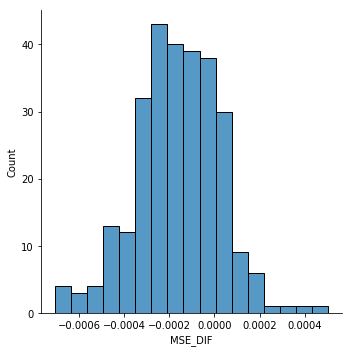

In [156]:
sns.displot(errors_df, x="MSE_DIF")

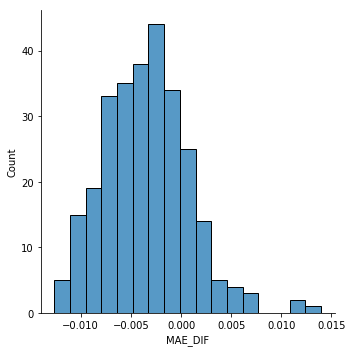

In [157]:
sns.displot(errors_df, x="MAE_DIF")

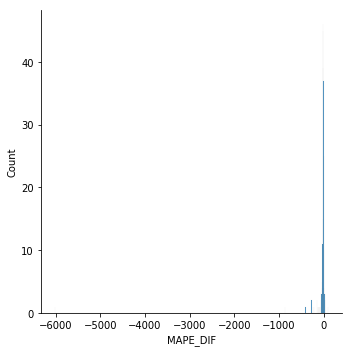

In [158]:
sns.displot(errors_df, x="MAPE_DIF")

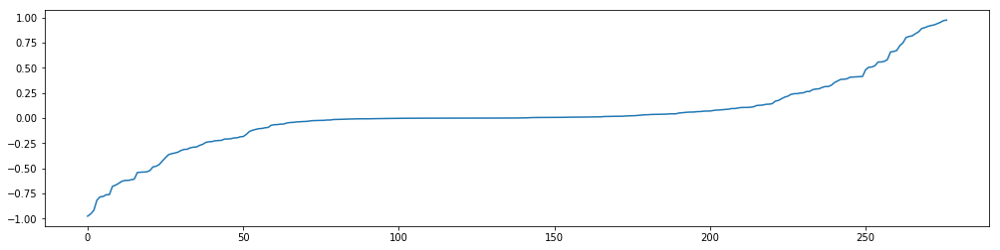

In [159]:
plt.rcParams['figure.figsize'] = [17, 4]
l=errors_df['KS_DIF'].tolist()
l.sort()
plt.plot(np.arange(len(l)), l)